# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

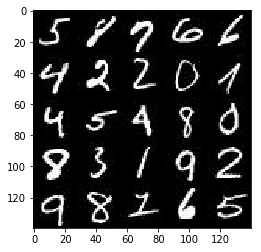

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

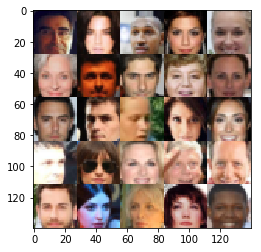

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.2.1
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    inputs_real = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels])
    inputs_z = tf.placeholder(tf.float32, [None, z_dim])
    learning_rate = tf.placeholder(tf.float32)

    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

ERROR:tensorflow:==================================
Object was never used (type <class 'tensorflow.python.framework.ops.Operation'>):
<tf.Operation 'assert_rank_2/Assert/Assert' type=Assert>
If you want to mark it as used call its "mark_used()" method.
It was originally created here:
['File "/home/kanamori-kazuki/.pyenv/versions/anaconda3-4.3.1/envs/dlnd/lib/python3.6/runpy.py", line 193, in _run_module_as_main\n    "__main__", mod_spec)', 'File "/home/kanamori-kazuki/.pyenv/versions/anaconda3-4.3.1/envs/dlnd/lib/python3.6/runpy.py", line 85, in _run_code\n    exec(code, run_globals)', 'File "/home/kanamori-kazuki/.pyenv/versions/anaconda3-4.3.1/envs/dlnd/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>\n    app.launch_new_instance()', 'File "/home/kanamori-kazuki/.pyenv/versions/anaconda3-4.3.1/envs/dlnd/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance\n    app.start()', 'File "/home/kanamori-kazuki/.pyenv/versions/anac

### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        conv1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        conv1 = tf.maximum(conv1 * 0.2, conv1)
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, strides=2, padding='same')
        conv2 = tf.layers.batch_normalization(conv2, axis=1, training=True)
        conv2 = tf.maximum(conv2 * 0.2, conv2)
        
        conv3 = tf.layers.conv2d(conv2, 256, 5, strides=2, padding='same')
        conv3 = tf.layers.batch_normalization(conv3, axis=1, training=True)
        conv3 = tf.maximum(conv3 * 0.2, conv3)
        
        conv3_shape = conv3.shape.as_list()
        
        flat = tf.reshape(conv3, [-1, conv3_shape[1] * conv3_shape[2] * conv3_shape[3]])
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [7]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse=not(is_train)):
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x, [-1, 4, 4, 512])
        x = tf.layers.batch_normalization(x, axis=1, training=is_train)
        x = tf.maximum(x * 0.2, x)
        
        trconv1 = tf.layers.conv2d_transpose(x, 256, 4, strides=1, padding='valid')
        trconv1 = tf.layers.batch_normalization(trconv1, axis=1, training=is_train)
        trconv1 = tf.maximum(trconv1 * 0.2, trconv1)
        
        trconv2 = tf.layers.conv2d_transpose(trconv1, 128, 5, strides=2, padding='same')
        trconv2 = tf.layers.batch_normalization(trconv2, axis=1, training=is_train)
        trconv2 = tf.maximum(trconv2 * 0.2, trconv2)
        
        trconv3 = tf.layers.conv2d_transpose(trconv2, out_channel_dim, 5, strides=2, padding='same')
#         trconv3 = tf.layers.batch_normalization(trconv3, axis=1, training=is_train)
#         trconv3 = tf.maximum(trconv3 * 0.2, trconv3)
        
#         trconv4 = tf.layers.conv2d_transpose(trconv3, out_channel_dim, 5, strides=1, padding='same')

        out = tf.tanh(trconv3)

    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    smooth = 0.1
    g_out = generator(input_z, out_channel_dim)
    d_out_real, d_logits_real = discriminator(input_real, reuse=False)
    d_out_fake, d_logits_fake = discriminator(g_out, reuse=True)
    
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_out_real) * (1-smooth))
    )
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_out_fake))
    )
    d_loss = d_loss_real + d_loss_fake
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_out_fake))
    )
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]
    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """

    # TODO: Build Model
#     tf.reset_default_graph()
    
    inputs_real, inputs_z, learn_rate = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(inputs_real, inputs_z, data_shape[3])
    d_opt, g_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    steps = 0
    
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                # TODO: Train Model
                batch_images = batch_images * 2
                steps += 1
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run(d_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, learn_rate: learning_rate})
                _ = sess.run(g_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, learn_rate: learning_rate})
                
                if steps % 5 == 0:
                    d_train_loss = d_loss.eval({inputs_real: batch_images, inputs_z: batch_z})
                    g_train_loss = g_loss.eval({inputs_real: batch_images, inputs_z: batch_z})
                    print('Epoch: {}/{}'.format(epoch_i + 1, epoch_count), 
                          'Discriminator Loss: {:.4f}'.format(d_train_loss),
                          'Generator Loss: {:.4f}'.format(g_train_loss))
                if steps % 50 == 0:
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-1.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-2.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-3.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-4.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0005
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-5.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0008
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

(output omitted to reduce notebook size)
![](mnist-6.png)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-1.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.3


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-2.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.4


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-3.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-4.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0005
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-5.png)

In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0008
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

(output omitted to reduce notebook size)
![](celebA-6.png)

### Hyper Parameters

Trying out various values of beta1 and learning rate, these parameter values looks better to generate realistic faces.
- beta1 : 0.3 - 0.4
- learning_rate : 0.0002 - 0.0005

Using these hyper parameters, let's see what faces can the network learn and generate over 3 training epochs.

Epoch: 1/3 Discriminator Loss: 1.0046 Generator Loss: 4.1674
Epoch: 1/3 Discriminator Loss: 1.0557 Generator Loss: 0.8451
Epoch: 1/3 Discriminator Loss: 1.4360 Generator Loss: 0.4987
Epoch: 1/3 Discriminator Loss: 1.0243 Generator Loss: 4.6641
Epoch: 1/3 Discriminator Loss: 3.0829 Generator Loss: 7.5435
Epoch: 1/3 Discriminator Loss: 1.3442 Generator Loss: 0.7635
Epoch: 1/3 Discriminator Loss: 0.9460 Generator Loss: 2.1604
Epoch: 1/3 Discriminator Loss: 1.6796 Generator Loss: 0.4447
Epoch: 1/3 Discriminator Loss: 1.4410 Generator Loss: 3.3330
Epoch: 1/3 Discriminator Loss: 1.0557 Generator Loss: 1.4921


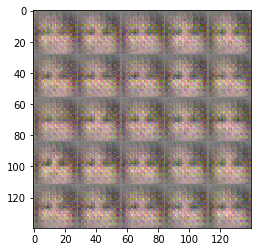

Epoch: 1/3 Discriminator Loss: 1.6685 Generator Loss: 0.7754
Epoch: 1/3 Discriminator Loss: 1.4112 Generator Loss: 0.4754
Epoch: 1/3 Discriminator Loss: 1.6244 Generator Loss: 0.9220
Epoch: 1/3 Discriminator Loss: 0.8004 Generator Loss: 1.7180
Epoch: 1/3 Discriminator Loss: 0.9066 Generator Loss: 2.1851
Epoch: 1/3 Discriminator Loss: 1.2900 Generator Loss: 0.9508
Epoch: 1/3 Discriminator Loss: 0.9214 Generator Loss: 1.2530
Epoch: 1/3 Discriminator Loss: 0.9124 Generator Loss: 2.0705
Epoch: 1/3 Discriminator Loss: 2.7299 Generator Loss: 0.1542
Epoch: 1/3 Discriminator Loss: 1.1128 Generator Loss: 1.0744


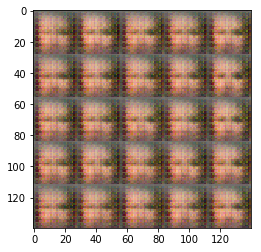

Epoch: 1/3 Discriminator Loss: 1.1135 Generator Loss: 0.8971
Epoch: 1/3 Discriminator Loss: 0.8519 Generator Loss: 1.6967
Epoch: 1/3 Discriminator Loss: 1.1053 Generator Loss: 0.9304
Epoch: 1/3 Discriminator Loss: 0.6819 Generator Loss: 2.2575
Epoch: 1/3 Discriminator Loss: 2.0767 Generator Loss: 1.4277
Epoch: 1/3 Discriminator Loss: 0.7373 Generator Loss: 1.9930
Epoch: 1/3 Discriminator Loss: 0.8839 Generator Loss: 1.7615
Epoch: 1/3 Discriminator Loss: 0.4894 Generator Loss: 3.8369
Epoch: 1/3 Discriminator Loss: 1.2474 Generator Loss: 1.7692
Epoch: 1/3 Discriminator Loss: 0.8241 Generator Loss: 1.7550


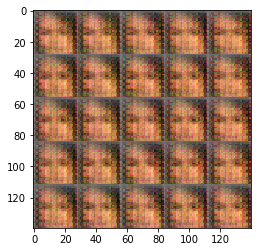

Epoch: 1/3 Discriminator Loss: 0.7838 Generator Loss: 1.7082
Epoch: 1/3 Discriminator Loss: 1.3940 Generator Loss: 0.8724
Epoch: 1/3 Discriminator Loss: 0.9372 Generator Loss: 2.1209
Epoch: 1/3 Discriminator Loss: 1.1057 Generator Loss: 1.6536
Epoch: 1/3 Discriminator Loss: 0.7979 Generator Loss: 1.6008
Epoch: 1/3 Discriminator Loss: 0.9607 Generator Loss: 1.2608
Epoch: 1/3 Discriminator Loss: 0.7102 Generator Loss: 2.6198
Epoch: 1/3 Discriminator Loss: 1.4197 Generator Loss: 0.4397
Epoch: 1/3 Discriminator Loss: 1.1375 Generator Loss: 0.8961
Epoch: 1/3 Discriminator Loss: 1.3867 Generator Loss: 3.3378


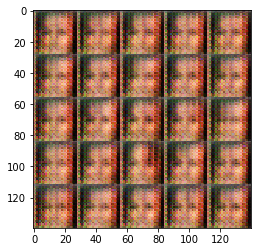

Epoch: 1/3 Discriminator Loss: 0.6566 Generator Loss: 1.9343
Epoch: 1/3 Discriminator Loss: 0.9384 Generator Loss: 1.4736
Epoch: 1/3 Discriminator Loss: 1.0003 Generator Loss: 1.3416
Epoch: 1/3 Discriminator Loss: 0.6830 Generator Loss: 2.2450
Epoch: 1/3 Discriminator Loss: 1.4010 Generator Loss: 0.9679
Epoch: 1/3 Discriminator Loss: 0.6319 Generator Loss: 1.4966
Epoch: 1/3 Discriminator Loss: 1.1157 Generator Loss: 6.6050
Epoch: 1/3 Discriminator Loss: 0.9208 Generator Loss: 1.1173
Epoch: 1/3 Discriminator Loss: 1.1044 Generator Loss: 1.1549
Epoch: 1/3 Discriminator Loss: 0.9963 Generator Loss: 1.1532


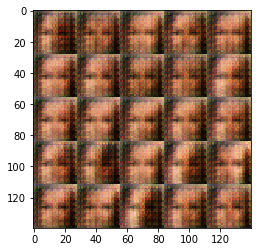

Epoch: 1/3 Discriminator Loss: 0.7117 Generator Loss: 1.9175
Epoch: 1/3 Discriminator Loss: 0.9350 Generator Loss: 1.6845
Epoch: 1/3 Discriminator Loss: 1.6243 Generator Loss: 0.6664
Epoch: 1/3 Discriminator Loss: 1.1764 Generator Loss: 1.1220
Epoch: 1/3 Discriminator Loss: 1.1946 Generator Loss: 1.2092
Epoch: 1/3 Discriminator Loss: 1.3828 Generator Loss: 0.8725
Epoch: 1/3 Discriminator Loss: 1.5198 Generator Loss: 0.7164
Epoch: 1/3 Discriminator Loss: 1.2254 Generator Loss: 0.9786
Epoch: 1/3 Discriminator Loss: 1.0933 Generator Loss: 1.0788
Epoch: 1/3 Discriminator Loss: 1.2430 Generator Loss: 0.9066


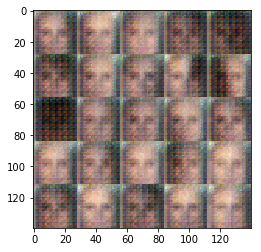

Epoch: 1/3 Discriminator Loss: 1.6267 Generator Loss: 0.6107
Epoch: 1/3 Discriminator Loss: 1.0322 Generator Loss: 1.1184
Epoch: 1/3 Discriminator Loss: 1.3036 Generator Loss: 0.8431
Epoch: 1/3 Discriminator Loss: 1.1687 Generator Loss: 1.2668
Epoch: 1/3 Discriminator Loss: 1.0650 Generator Loss: 1.1847
Epoch: 1/3 Discriminator Loss: 1.3389 Generator Loss: 0.7218
Epoch: 1/3 Discriminator Loss: 1.1271 Generator Loss: 1.2660
Epoch: 1/3 Discriminator Loss: 1.2110 Generator Loss: 0.9305
Epoch: 1/3 Discriminator Loss: 0.9930 Generator Loss: 1.1279
Epoch: 1/3 Discriminator Loss: 1.3532 Generator Loss: 0.6555


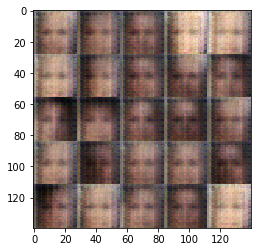

Epoch: 1/3 Discriminator Loss: 1.1098 Generator Loss: 0.9454
Epoch: 1/3 Discriminator Loss: 1.1415 Generator Loss: 0.9048
Epoch: 1/3 Discriminator Loss: 1.1273 Generator Loss: 0.9674
Epoch: 1/3 Discriminator Loss: 1.0910 Generator Loss: 1.0792
Epoch: 1/3 Discriminator Loss: 1.2806 Generator Loss: 0.9771
Epoch: 1/3 Discriminator Loss: 1.2588 Generator Loss: 0.8302
Epoch: 1/3 Discriminator Loss: 1.3319 Generator Loss: 1.0616
Epoch: 1/3 Discriminator Loss: 1.0650 Generator Loss: 1.4745
Epoch: 1/3 Discriminator Loss: 1.2414 Generator Loss: 0.9955
Epoch: 1/3 Discriminator Loss: 1.2612 Generator Loss: 0.9064


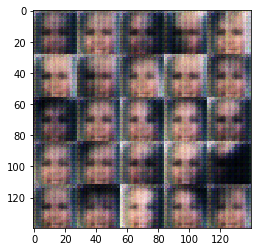

Epoch: 1/3 Discriminator Loss: 1.2933 Generator Loss: 1.0454
Epoch: 1/3 Discriminator Loss: 1.2153 Generator Loss: 0.9115
Epoch: 1/3 Discriminator Loss: 1.2115 Generator Loss: 1.0797
Epoch: 1/3 Discriminator Loss: 1.0927 Generator Loss: 0.8492
Epoch: 1/3 Discriminator Loss: 1.2140 Generator Loss: 0.8327
Epoch: 1/3 Discriminator Loss: 1.2254 Generator Loss: 1.3551
Epoch: 1/3 Discriminator Loss: 1.3196 Generator Loss: 0.9577
Epoch: 1/3 Discriminator Loss: 0.9280 Generator Loss: 1.2767
Epoch: 1/3 Discriminator Loss: 1.2156 Generator Loss: 0.9379
Epoch: 1/3 Discriminator Loss: 1.5964 Generator Loss: 0.8866


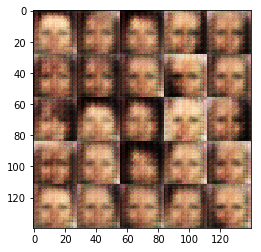

Epoch: 1/3 Discriminator Loss: 1.4180 Generator Loss: 0.6560
Epoch: 1/3 Discriminator Loss: 1.0568 Generator Loss: 1.4657
Epoch: 1/3 Discriminator Loss: 1.2427 Generator Loss: 0.9128
Epoch: 1/3 Discriminator Loss: 1.0678 Generator Loss: 1.1588
Epoch: 1/3 Discriminator Loss: 1.1683 Generator Loss: 1.3672
Epoch: 1/3 Discriminator Loss: 1.2003 Generator Loss: 0.9125
Epoch: 1/3 Discriminator Loss: 1.1981 Generator Loss: 0.7871
Epoch: 1/3 Discriminator Loss: 1.7585 Generator Loss: 0.5637
Epoch: 1/3 Discriminator Loss: 1.1175 Generator Loss: 1.0417
Epoch: 1/3 Discriminator Loss: 1.1313 Generator Loss: 1.1103


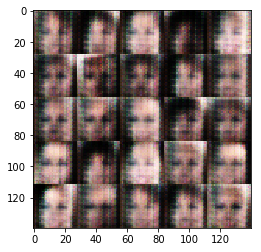

Epoch: 1/3 Discriminator Loss: 1.1539 Generator Loss: 1.1734
Epoch: 1/3 Discriminator Loss: 1.3863 Generator Loss: 0.6345
Epoch: 1/3 Discriminator Loss: 1.3702 Generator Loss: 0.7467
Epoch: 1/3 Discriminator Loss: 1.0737 Generator Loss: 1.0514
Epoch: 1/3 Discriminator Loss: 1.2175 Generator Loss: 0.7887
Epoch: 1/3 Discriminator Loss: 1.4449 Generator Loss: 1.1569
Epoch: 1/3 Discriminator Loss: 1.1404 Generator Loss: 1.0599
Epoch: 1/3 Discriminator Loss: 1.3512 Generator Loss: 0.9891
Epoch: 1/3 Discriminator Loss: 1.1618 Generator Loss: 1.1622
Epoch: 1/3 Discriminator Loss: 1.1518 Generator Loss: 1.0572


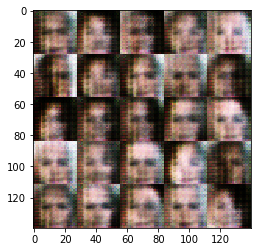

Epoch: 1/3 Discriminator Loss: 1.3809 Generator Loss: 0.8222
Epoch: 1/3 Discriminator Loss: 1.2229 Generator Loss: 0.7366
Epoch: 1/3 Discriminator Loss: 1.0592 Generator Loss: 1.0895
Epoch: 1/3 Discriminator Loss: 1.1806 Generator Loss: 0.9037
Epoch: 1/3 Discriminator Loss: 1.2984 Generator Loss: 1.3362
Epoch: 1/3 Discriminator Loss: 1.2911 Generator Loss: 0.7946
Epoch: 1/3 Discriminator Loss: 1.2215 Generator Loss: 0.9288
Epoch: 1/3 Discriminator Loss: 1.0720 Generator Loss: 1.3984
Epoch: 1/3 Discriminator Loss: 1.1627 Generator Loss: 1.1276
Epoch: 1/3 Discriminator Loss: 1.3136 Generator Loss: 1.1952


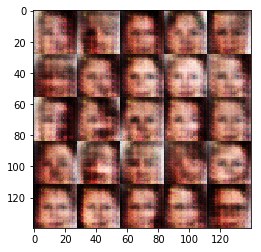

Epoch: 1/3 Discriminator Loss: 1.3992 Generator Loss: 0.6348
Epoch: 1/3 Discriminator Loss: 0.9281 Generator Loss: 1.2625
Epoch: 1/3 Discriminator Loss: 1.2773 Generator Loss: 0.8189
Epoch: 1/3 Discriminator Loss: 1.3222 Generator Loss: 0.7210
Epoch: 1/3 Discriminator Loss: 1.2247 Generator Loss: 1.0741
Epoch: 1/3 Discriminator Loss: 1.4509 Generator Loss: 0.5515
Epoch: 1/3 Discriminator Loss: 1.3036 Generator Loss: 0.6088
Epoch: 1/3 Discriminator Loss: 1.3465 Generator Loss: 0.8438
Epoch: 1/3 Discriminator Loss: 1.3064 Generator Loss: 0.9719
Epoch: 1/3 Discriminator Loss: 1.2626 Generator Loss: 0.9197


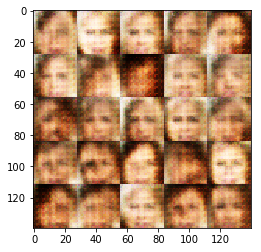

Epoch: 1/3 Discriminator Loss: 1.3941 Generator Loss: 0.7659
Epoch: 1/3 Discriminator Loss: 1.1858 Generator Loss: 0.9334
Epoch: 1/3 Discriminator Loss: 1.6017 Generator Loss: 1.0502
Epoch: 1/3 Discriminator Loss: 1.0900 Generator Loss: 1.2718
Epoch: 1/3 Discriminator Loss: 1.0366 Generator Loss: 1.1404
Epoch: 1/3 Discriminator Loss: 1.3926 Generator Loss: 1.0132
Epoch: 1/3 Discriminator Loss: 1.2019 Generator Loss: 1.0502
Epoch: 1/3 Discriminator Loss: 1.1065 Generator Loss: 1.0659
Epoch: 1/3 Discriminator Loss: 1.2419 Generator Loss: 0.8679
Epoch: 1/3 Discriminator Loss: 1.1067 Generator Loss: 1.1132


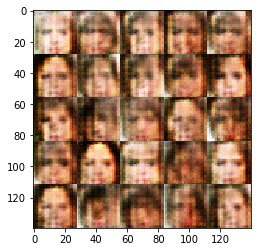

Epoch: 1/3 Discriminator Loss: 1.1718 Generator Loss: 0.9501
Epoch: 1/3 Discriminator Loss: 1.1984 Generator Loss: 1.0957
Epoch: 1/3 Discriminator Loss: 1.0396 Generator Loss: 1.1834
Epoch: 1/3 Discriminator Loss: 1.6402 Generator Loss: 0.3683
Epoch: 1/3 Discriminator Loss: 1.2017 Generator Loss: 0.9147
Epoch: 1/3 Discriminator Loss: 1.2911 Generator Loss: 0.8097
Epoch: 1/3 Discriminator Loss: 1.3715 Generator Loss: 0.6726
Epoch: 1/3 Discriminator Loss: 1.0229 Generator Loss: 1.1273
Epoch: 1/3 Discriminator Loss: 1.5300 Generator Loss: 0.7359
Epoch: 1/3 Discriminator Loss: 1.0916 Generator Loss: 1.2626


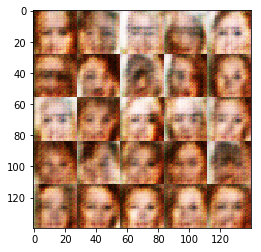

Epoch: 1/3 Discriminator Loss: 1.1974 Generator Loss: 1.0661
Epoch: 1/3 Discriminator Loss: 1.6935 Generator Loss: 0.4404
Epoch: 1/3 Discriminator Loss: 1.8085 Generator Loss: 2.3353
Epoch: 1/3 Discriminator Loss: 1.0523 Generator Loss: 1.0105
Epoch: 1/3 Discriminator Loss: 1.3883 Generator Loss: 0.8477
Epoch: 1/3 Discriminator Loss: 1.2723 Generator Loss: 0.8432
Epoch: 1/3 Discriminator Loss: 1.3333 Generator Loss: 0.7682
Epoch: 1/3 Discriminator Loss: 1.3129 Generator Loss: 0.8996
Epoch: 1/3 Discriminator Loss: 1.2059 Generator Loss: 0.9585
Epoch: 1/3 Discriminator Loss: 1.0466 Generator Loss: 1.5029


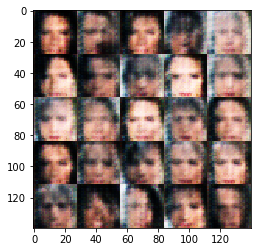

Epoch: 1/3 Discriminator Loss: 1.7979 Generator Loss: 0.4259
Epoch: 1/3 Discriminator Loss: 1.1220 Generator Loss: 0.9817
Epoch: 1/3 Discriminator Loss: 1.1950 Generator Loss: 0.8242
Epoch: 1/3 Discriminator Loss: 1.5160 Generator Loss: 0.6065
Epoch: 1/3 Discriminator Loss: 1.5517 Generator Loss: 0.6118
Epoch: 1/3 Discriminator Loss: 0.8913 Generator Loss: 1.2003
Epoch: 1/3 Discriminator Loss: 1.7325 Generator Loss: 1.1086
Epoch: 1/3 Discriminator Loss: 1.2986 Generator Loss: 1.0686
Epoch: 1/3 Discriminator Loss: 1.1794 Generator Loss: 1.0306
Epoch: 1/3 Discriminator Loss: 1.2818 Generator Loss: 0.8048


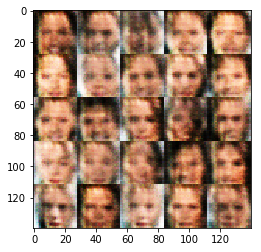

Epoch: 1/3 Discriminator Loss: 1.1987 Generator Loss: 1.1112
Epoch: 1/3 Discriminator Loss: 1.3693 Generator Loss: 1.7470
Epoch: 1/3 Discriminator Loss: 1.3247 Generator Loss: 0.8687
Epoch: 1/3 Discriminator Loss: 1.4099 Generator Loss: 1.7822
Epoch: 1/3 Discriminator Loss: 1.2361 Generator Loss: 0.9455
Epoch: 1/3 Discriminator Loss: 1.1716 Generator Loss: 1.5236
Epoch: 1/3 Discriminator Loss: 1.2708 Generator Loss: 0.6403
Epoch: 1/3 Discriminator Loss: 1.1763 Generator Loss: 0.9546
Epoch: 1/3 Discriminator Loss: 1.2978 Generator Loss: 0.7673
Epoch: 1/3 Discriminator Loss: 1.1919 Generator Loss: 0.9087


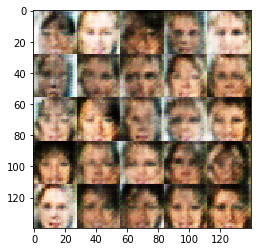

Epoch: 1/3 Discriminator Loss: 1.2033 Generator Loss: 0.8898
Epoch: 1/3 Discriminator Loss: 1.4647 Generator Loss: 1.6768
Epoch: 1/3 Discriminator Loss: 1.0758 Generator Loss: 0.9136
Epoch: 1/3 Discriminator Loss: 1.2301 Generator Loss: 0.8298
Epoch: 1/3 Discriminator Loss: 1.1067 Generator Loss: 0.7775
Epoch: 1/3 Discriminator Loss: 1.5471 Generator Loss: 0.5870
Epoch: 1/3 Discriminator Loss: 1.0532 Generator Loss: 1.0190
Epoch: 1/3 Discriminator Loss: 1.3157 Generator Loss: 0.8595
Epoch: 1/3 Discriminator Loss: 1.4405 Generator Loss: 0.8064
Epoch: 1/3 Discriminator Loss: 1.0205 Generator Loss: 0.9703


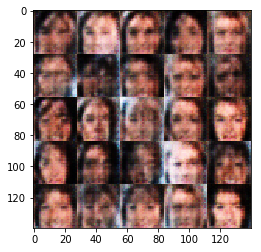

Epoch: 1/3 Discriminator Loss: 1.3002 Generator Loss: 0.6604
Epoch: 1/3 Discriminator Loss: 1.2333 Generator Loss: 0.7440
Epoch: 1/3 Discriminator Loss: 1.4234 Generator Loss: 0.5513
Epoch: 1/3 Discriminator Loss: 1.2631 Generator Loss: 0.9802
Epoch: 1/3 Discriminator Loss: 1.1749 Generator Loss: 0.9172
Epoch: 1/3 Discriminator Loss: 1.2551 Generator Loss: 1.4080
Epoch: 1/3 Discriminator Loss: 1.1862 Generator Loss: 1.1796
Epoch: 1/3 Discriminator Loss: 1.2219 Generator Loss: 0.7969
Epoch: 1/3 Discriminator Loss: 1.3976 Generator Loss: 0.9387
Epoch: 1/3 Discriminator Loss: 1.2944 Generator Loss: 0.8857


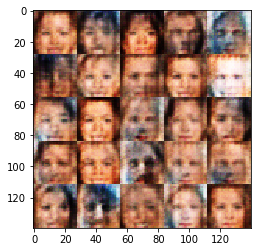

Epoch: 1/3 Discriminator Loss: 1.2276 Generator Loss: 0.7598
Epoch: 1/3 Discriminator Loss: 1.3850 Generator Loss: 0.8213
Epoch: 1/3 Discriminator Loss: 1.2448 Generator Loss: 0.9762
Epoch: 1/3 Discriminator Loss: 1.2557 Generator Loss: 1.1252
Epoch: 1/3 Discriminator Loss: 1.0991 Generator Loss: 1.0456
Epoch: 1/3 Discriminator Loss: 1.3227 Generator Loss: 0.5855
Epoch: 1/3 Discriminator Loss: 1.1165 Generator Loss: 1.0121
Epoch: 1/3 Discriminator Loss: 1.2295 Generator Loss: 1.0382
Epoch: 1/3 Discriminator Loss: 1.2041 Generator Loss: 0.9043
Epoch: 1/3 Discriminator Loss: 1.2144 Generator Loss: 1.2420


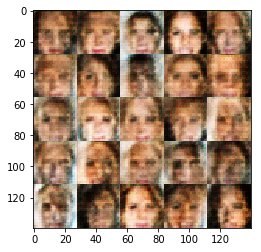

Epoch: 1/3 Discriminator Loss: 1.1213 Generator Loss: 0.9905
Epoch: 1/3 Discriminator Loss: 1.3226 Generator Loss: 0.6224
Epoch: 1/3 Discriminator Loss: 1.3042 Generator Loss: 0.7675
Epoch: 1/3 Discriminator Loss: 1.2542 Generator Loss: 0.9330
Epoch: 1/3 Discriminator Loss: 1.2071 Generator Loss: 0.8243
Epoch: 1/3 Discriminator Loss: 1.1613 Generator Loss: 0.7575
Epoch: 1/3 Discriminator Loss: 1.2738 Generator Loss: 1.1650
Epoch: 1/3 Discriminator Loss: 1.2048 Generator Loss: 1.3097
Epoch: 1/3 Discriminator Loss: 1.3505 Generator Loss: 1.2502
Epoch: 1/3 Discriminator Loss: 1.4360 Generator Loss: 0.8838


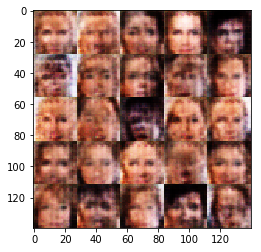

Epoch: 1/3 Discriminator Loss: 1.2784 Generator Loss: 0.8034
Epoch: 1/3 Discriminator Loss: 1.2862 Generator Loss: 0.8119
Epoch: 1/3 Discriminator Loss: 1.1323 Generator Loss: 1.0520
Epoch: 1/3 Discriminator Loss: 1.4402 Generator Loss: 0.6381
Epoch: 1/3 Discriminator Loss: 1.4009 Generator Loss: 0.8237
Epoch: 1/3 Discriminator Loss: 1.3185 Generator Loss: 0.9205
Epoch: 1/3 Discriminator Loss: 1.3658 Generator Loss: 0.8359
Epoch: 1/3 Discriminator Loss: 1.2547 Generator Loss: 0.8542
Epoch: 1/3 Discriminator Loss: 1.2408 Generator Loss: 0.8238
Epoch: 1/3 Discriminator Loss: 1.3817 Generator Loss: 0.7699


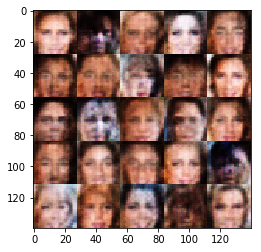

Epoch: 1/3 Discriminator Loss: 1.3526 Generator Loss: 0.7276
Epoch: 1/3 Discriminator Loss: 1.3935 Generator Loss: 0.9182
Epoch: 1/3 Discriminator Loss: 1.1839 Generator Loss: 1.0851
Epoch: 1/3 Discriminator Loss: 1.3704 Generator Loss: 0.5747
Epoch: 1/3 Discriminator Loss: 1.3299 Generator Loss: 0.6947
Epoch: 1/3 Discriminator Loss: 1.2525 Generator Loss: 0.6783
Epoch: 1/3 Discriminator Loss: 1.3358 Generator Loss: 0.9956
Epoch: 1/3 Discriminator Loss: 1.1910 Generator Loss: 0.9571
Epoch: 1/3 Discriminator Loss: 1.3117 Generator Loss: 0.9575
Epoch: 1/3 Discriminator Loss: 1.2904 Generator Loss: 0.7903


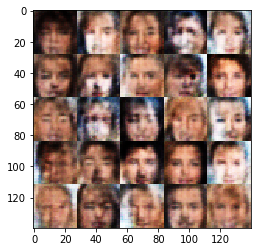

Epoch: 1/3 Discriminator Loss: 1.2762 Generator Loss: 0.7637
Epoch: 1/3 Discriminator Loss: 1.3659 Generator Loss: 0.9604
Epoch: 1/3 Discriminator Loss: 1.2335 Generator Loss: 1.0503
Epoch: 1/3 Discriminator Loss: 1.2079 Generator Loss: 0.9893
Epoch: 1/3 Discriminator Loss: 1.2975 Generator Loss: 0.6918
Epoch: 1/3 Discriminator Loss: 1.2950 Generator Loss: 0.8350
Epoch: 1/3 Discriminator Loss: 1.3701 Generator Loss: 0.8394
Epoch: 1/3 Discriminator Loss: 1.2408 Generator Loss: 0.9508
Epoch: 1/3 Discriminator Loss: 1.2601 Generator Loss: 0.8284
Epoch: 1/3 Discriminator Loss: 1.4274 Generator Loss: 0.7545


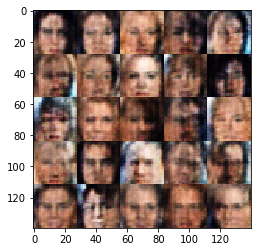

Epoch: 1/3 Discriminator Loss: 1.2864 Generator Loss: 0.8305
Epoch: 1/3 Discriminator Loss: 1.3041 Generator Loss: 0.8173
Epoch: 1/3 Discriminator Loss: 1.2663 Generator Loss: 0.7348
Epoch: 1/3 Discriminator Loss: 1.2121 Generator Loss: 0.9329
Epoch: 1/3 Discriminator Loss: 1.5078 Generator Loss: 0.6320
Epoch: 1/3 Discriminator Loss: 1.2754 Generator Loss: 0.8353
Epoch: 1/3 Discriminator Loss: 1.1978 Generator Loss: 0.9203
Epoch: 1/3 Discriminator Loss: 1.3452 Generator Loss: 0.8705
Epoch: 1/3 Discriminator Loss: 1.2902 Generator Loss: 0.8315
Epoch: 1/3 Discriminator Loss: 1.4317 Generator Loss: 0.6478


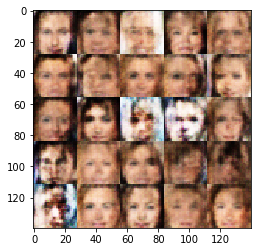

Epoch: 1/3 Discriminator Loss: 1.2911 Generator Loss: 0.8275
Epoch: 1/3 Discriminator Loss: 1.3491 Generator Loss: 0.8466
Epoch: 1/3 Discriminator Loss: 1.2539 Generator Loss: 0.9955
Epoch: 1/3 Discriminator Loss: 1.3729 Generator Loss: 0.7466
Epoch: 1/3 Discriminator Loss: 1.3643 Generator Loss: 0.6642
Epoch: 1/3 Discriminator Loss: 1.2629 Generator Loss: 0.9236
Epoch: 1/3 Discriminator Loss: 1.3329 Generator Loss: 0.8977
Epoch: 1/3 Discriminator Loss: 1.3170 Generator Loss: 0.6645
Epoch: 1/3 Discriminator Loss: 1.2305 Generator Loss: 1.1507
Epoch: 1/3 Discriminator Loss: 1.3568 Generator Loss: 0.9406


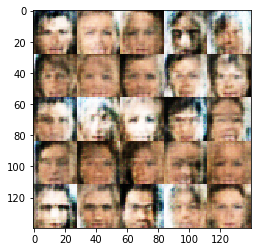

Epoch: 1/3 Discriminator Loss: 1.4007 Generator Loss: 0.7397
Epoch: 1/3 Discriminator Loss: 1.4054 Generator Loss: 0.6046
Epoch: 1/3 Discriminator Loss: 1.4388 Generator Loss: 0.7759
Epoch: 1/3 Discriminator Loss: 1.3288 Generator Loss: 0.7931
Epoch: 1/3 Discriminator Loss: 1.2479 Generator Loss: 1.0090
Epoch: 1/3 Discriminator Loss: 1.3003 Generator Loss: 0.7842
Epoch: 1/3 Discriminator Loss: 1.2307 Generator Loss: 1.0025
Epoch: 1/3 Discriminator Loss: 1.2916 Generator Loss: 0.8294
Epoch: 1/3 Discriminator Loss: 1.3030 Generator Loss: 1.0318
Epoch: 1/3 Discriminator Loss: 1.3382 Generator Loss: 0.6820


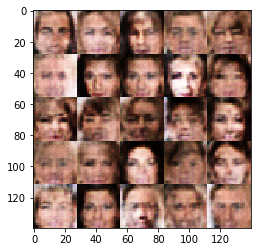

Epoch: 1/3 Discriminator Loss: 1.3178 Generator Loss: 0.8836
Epoch: 1/3 Discriminator Loss: 1.3534 Generator Loss: 0.7034
Epoch: 1/3 Discriminator Loss: 1.3309 Generator Loss: 1.0448
Epoch: 1/3 Discriminator Loss: 1.2435 Generator Loss: 0.9528
Epoch: 1/3 Discriminator Loss: 1.2508 Generator Loss: 0.8809
Epoch: 1/3 Discriminator Loss: 1.3501 Generator Loss: 0.7819
Epoch: 1/3 Discriminator Loss: 1.3692 Generator Loss: 0.7176
Epoch: 1/3 Discriminator Loss: 1.6801 Generator Loss: 0.5215
Epoch: 1/3 Discriminator Loss: 1.3533 Generator Loss: 0.9754
Epoch: 1/3 Discriminator Loss: 1.1829 Generator Loss: 0.9007


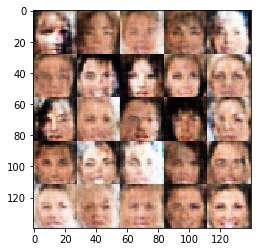

Epoch: 1/3 Discriminator Loss: 1.5216 Generator Loss: 0.7211
Epoch: 1/3 Discriminator Loss: 1.1540 Generator Loss: 0.9484
Epoch: 1/3 Discriminator Loss: 1.4648 Generator Loss: 0.7281
Epoch: 1/3 Discriminator Loss: 1.2539 Generator Loss: 0.8865
Epoch: 1/3 Discriminator Loss: 1.3658 Generator Loss: 0.7941
Epoch: 1/3 Discriminator Loss: 1.4208 Generator Loss: 0.7505
Epoch: 1/3 Discriminator Loss: 1.3374 Generator Loss: 0.8582
Epoch: 1/3 Discriminator Loss: 1.4180 Generator Loss: 0.7654
Epoch: 1/3 Discriminator Loss: 1.3825 Generator Loss: 0.6805
Epoch: 1/3 Discriminator Loss: 1.3374 Generator Loss: 0.8756


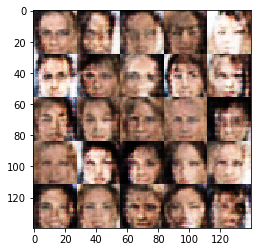

Epoch: 1/3 Discriminator Loss: 1.2792 Generator Loss: 0.8249
Epoch: 1/3 Discriminator Loss: 1.3153 Generator Loss: 0.8791
Epoch: 1/3 Discriminator Loss: 1.2595 Generator Loss: 0.8318
Epoch: 1/3 Discriminator Loss: 1.4075 Generator Loss: 0.7051
Epoch: 1/3 Discriminator Loss: 1.2139 Generator Loss: 0.8602
Epoch: 1/3 Discriminator Loss: 1.2956 Generator Loss: 0.8429
Epoch: 1/3 Discriminator Loss: 1.3943 Generator Loss: 0.8375
Epoch: 1/3 Discriminator Loss: 1.2897 Generator Loss: 0.9445
Epoch: 1/3 Discriminator Loss: 1.2729 Generator Loss: 0.8937
Epoch: 1/3 Discriminator Loss: 1.4338 Generator Loss: 0.7829


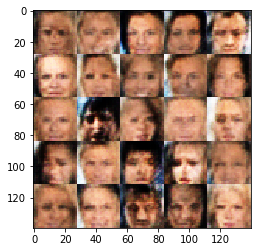

Epoch: 1/3 Discriminator Loss: 1.2901 Generator Loss: 0.8266
Epoch: 1/3 Discriminator Loss: 1.3058 Generator Loss: 0.7592
Epoch: 1/3 Discriminator Loss: 1.3155 Generator Loss: 0.8682
Epoch: 1/3 Discriminator Loss: 1.3922 Generator Loss: 0.7518
Epoch: 1/3 Discriminator Loss: 1.2456 Generator Loss: 0.8968
Epoch: 1/3 Discriminator Loss: 1.2144 Generator Loss: 0.8017
Epoch: 1/3 Discriminator Loss: 1.3556 Generator Loss: 0.8510
Epoch: 1/3 Discriminator Loss: 1.5120 Generator Loss: 0.7824
Epoch: 1/3 Discriminator Loss: 1.2032 Generator Loss: 0.8618
Epoch: 1/3 Discriminator Loss: 1.3459 Generator Loss: 0.8367


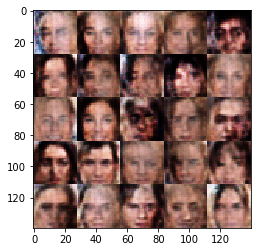

Epoch: 1/3 Discriminator Loss: 1.2783 Generator Loss: 0.8710
Epoch: 1/3 Discriminator Loss: 1.3619 Generator Loss: 0.7838
Epoch: 1/3 Discriminator Loss: 1.3204 Generator Loss: 0.7401
Epoch: 1/3 Discriminator Loss: 1.3896 Generator Loss: 0.6882
Epoch: 1/3 Discriminator Loss: 1.2929 Generator Loss: 0.8551
Epoch: 1/3 Discriminator Loss: 1.3910 Generator Loss: 0.7457
Epoch: 1/3 Discriminator Loss: 1.3201 Generator Loss: 0.7800
Epoch: 1/3 Discriminator Loss: 1.2942 Generator Loss: 0.7624
Epoch: 1/3 Discriminator Loss: 1.2710 Generator Loss: 0.8701
Epoch: 1/3 Discriminator Loss: 1.3266 Generator Loss: 0.7158


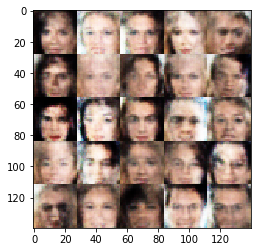

Epoch: 1/3 Discriminator Loss: 1.4372 Generator Loss: 0.8616
Epoch: 1/3 Discriminator Loss: 1.2805 Generator Loss: 0.8337
Epoch: 1/3 Discriminator Loss: 1.1745 Generator Loss: 1.0106
Epoch: 1/3 Discriminator Loss: 1.2041 Generator Loss: 0.8809
Epoch: 1/3 Discriminator Loss: 1.4543 Generator Loss: 0.6014
Epoch: 1/3 Discriminator Loss: 1.1696 Generator Loss: 0.9804
Epoch: 1/3 Discriminator Loss: 1.2987 Generator Loss: 0.7224
Epoch: 1/3 Discriminator Loss: 1.3347 Generator Loss: 0.8912
Epoch: 1/3 Discriminator Loss: 1.3755 Generator Loss: 0.8144
Epoch: 1/3 Discriminator Loss: 1.2489 Generator Loss: 0.8734


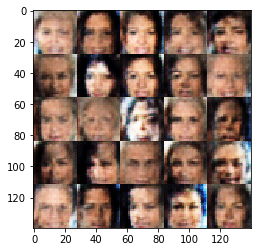

Epoch: 1/3 Discriminator Loss: 1.2637 Generator Loss: 0.7228
Epoch: 1/3 Discriminator Loss: 1.6301 Generator Loss: 0.6383
Epoch: 1/3 Discriminator Loss: 1.1411 Generator Loss: 0.9769
Epoch: 1/3 Discriminator Loss: 1.3733 Generator Loss: 1.0983
Epoch: 1/3 Discriminator Loss: 1.3588 Generator Loss: 0.6986
Epoch: 1/3 Discriminator Loss: 1.3172 Generator Loss: 0.8719
Epoch: 1/3 Discriminator Loss: 1.3592 Generator Loss: 0.8246
Epoch: 1/3 Discriminator Loss: 1.2782 Generator Loss: 0.7352
Epoch: 1/3 Discriminator Loss: 1.3750 Generator Loss: 0.7883
Epoch: 1/3 Discriminator Loss: 1.2098 Generator Loss: 0.8973


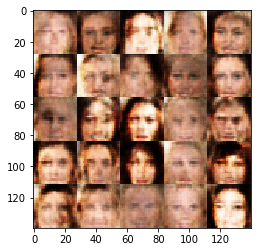

Epoch: 1/3 Discriminator Loss: 1.3296 Generator Loss: 0.8616
Epoch: 1/3 Discriminator Loss: 1.3220 Generator Loss: 0.7469
Epoch: 1/3 Discriminator Loss: 1.3447 Generator Loss: 0.8238
Epoch: 1/3 Discriminator Loss: 1.2730 Generator Loss: 0.9955
Epoch: 1/3 Discriminator Loss: 1.4340 Generator Loss: 0.7002
Epoch: 1/3 Discriminator Loss: 1.2458 Generator Loss: 0.8532
Epoch: 1/3 Discriminator Loss: 1.3989 Generator Loss: 0.7536
Epoch: 1/3 Discriminator Loss: 1.3096 Generator Loss: 0.6925
Epoch: 1/3 Discriminator Loss: 1.2719 Generator Loss: 0.8907
Epoch: 1/3 Discriminator Loss: 1.3669 Generator Loss: 0.7850


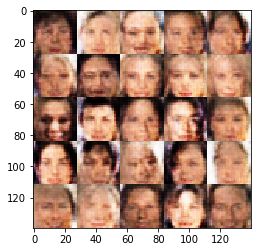

Epoch: 1/3 Discriminator Loss: 1.3758 Generator Loss: 0.8985
Epoch: 1/3 Discriminator Loss: 1.3316 Generator Loss: 0.9256
Epoch: 1/3 Discriminator Loss: 1.3099 Generator Loss: 0.8134
Epoch: 1/3 Discriminator Loss: 1.2146 Generator Loss: 0.9732
Epoch: 1/3 Discriminator Loss: 1.2989 Generator Loss: 0.8807
Epoch: 1/3 Discriminator Loss: 1.3618 Generator Loss: 0.6994
Epoch: 1/3 Discriminator Loss: 1.3299 Generator Loss: 0.7260
Epoch: 1/3 Discriminator Loss: 1.2449 Generator Loss: 0.8277
Epoch: 1/3 Discriminator Loss: 1.3086 Generator Loss: 0.7683
Epoch: 1/3 Discriminator Loss: 1.2814 Generator Loss: 0.7029


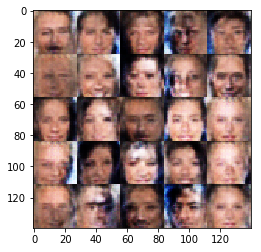

Epoch: 1/3 Discriminator Loss: 1.2981 Generator Loss: 1.2112
Epoch: 1/3 Discriminator Loss: 1.1671 Generator Loss: 0.9007
Epoch: 1/3 Discriminator Loss: 1.3723 Generator Loss: 0.8098
Epoch: 1/3 Discriminator Loss: 1.4902 Generator Loss: 0.5493
Epoch: 1/3 Discriminator Loss: 1.2807 Generator Loss: 0.8692
Epoch: 1/3 Discriminator Loss: 1.3587 Generator Loss: 0.8181
Epoch: 1/3 Discriminator Loss: 1.3376 Generator Loss: 0.8254
Epoch: 1/3 Discriminator Loss: 1.2406 Generator Loss: 0.9478
Epoch: 1/3 Discriminator Loss: 1.3009 Generator Loss: 0.9048
Epoch: 1/3 Discriminator Loss: 1.4011 Generator Loss: 0.7586


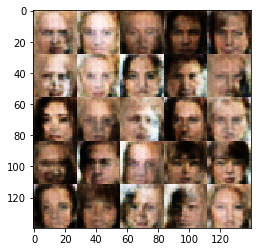

Epoch: 1/3 Discriminator Loss: 1.2617 Generator Loss: 0.8819
Epoch: 1/3 Discriminator Loss: 1.3823 Generator Loss: 0.8609
Epoch: 1/3 Discriminator Loss: 1.5113 Generator Loss: 0.7395
Epoch: 1/3 Discriminator Loss: 1.2116 Generator Loss: 0.8442
Epoch: 1/3 Discriminator Loss: 1.1899 Generator Loss: 0.9111
Epoch: 1/3 Discriminator Loss: 1.4186 Generator Loss: 0.7133
Epoch: 1/3 Discriminator Loss: 1.3177 Generator Loss: 0.8752
Epoch: 1/3 Discriminator Loss: 1.2862 Generator Loss: 0.8240
Epoch: 1/3 Discriminator Loss: 1.2100 Generator Loss: 0.9262
Epoch: 1/3 Discriminator Loss: 1.3039 Generator Loss: 0.8365


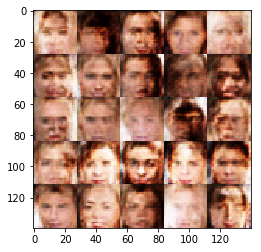

Epoch: 1/3 Discriminator Loss: 1.3915 Generator Loss: 0.8586
Epoch: 1/3 Discriminator Loss: 1.3999 Generator Loss: 0.6988
Epoch: 1/3 Discriminator Loss: 1.3541 Generator Loss: 0.7762
Epoch: 1/3 Discriminator Loss: 1.1905 Generator Loss: 0.9466
Epoch: 1/3 Discriminator Loss: 1.2970 Generator Loss: 0.9442
Epoch: 1/3 Discriminator Loss: 1.3347 Generator Loss: 0.7998
Epoch: 1/3 Discriminator Loss: 1.3539 Generator Loss: 0.8558
Epoch: 1/3 Discriminator Loss: 1.1496 Generator Loss: 0.9647
Epoch: 1/3 Discriminator Loss: 1.3542 Generator Loss: 0.9090
Epoch: 1/3 Discriminator Loss: 1.3263 Generator Loss: 0.7263


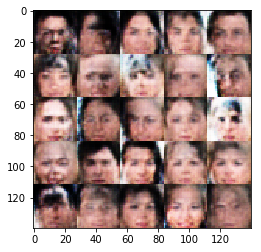

Epoch: 1/3 Discriminator Loss: 1.3784 Generator Loss: 0.6829
Epoch: 1/3 Discriminator Loss: 1.1936 Generator Loss: 0.8786
Epoch: 1/3 Discriminator Loss: 1.2235 Generator Loss: 0.9261
Epoch: 1/3 Discriminator Loss: 1.2536 Generator Loss: 0.8937
Epoch: 1/3 Discriminator Loss: 1.4958 Generator Loss: 0.5701
Epoch: 1/3 Discriminator Loss: 1.2496 Generator Loss: 0.7910
Epoch: 1/3 Discriminator Loss: 1.2752 Generator Loss: 0.9759
Epoch: 1/3 Discriminator Loss: 1.2621 Generator Loss: 0.8819
Epoch: 1/3 Discriminator Loss: 1.3362 Generator Loss: 0.9294
Epoch: 1/3 Discriminator Loss: 1.3053 Generator Loss: 0.7737


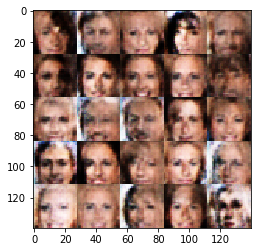

Epoch: 1/3 Discriminator Loss: 1.2569 Generator Loss: 0.8212
Epoch: 1/3 Discriminator Loss: 1.3644 Generator Loss: 0.6960
Epoch: 1/3 Discriminator Loss: 1.2658 Generator Loss: 0.9395
Epoch: 1/3 Discriminator Loss: 1.2973 Generator Loss: 0.8139
Epoch: 1/3 Discriminator Loss: 1.2715 Generator Loss: 0.7040
Epoch: 1/3 Discriminator Loss: 1.7129 Generator Loss: 1.1627
Epoch: 1/3 Discriminator Loss: 1.2808 Generator Loss: 0.8434
Epoch: 1/3 Discriminator Loss: 1.3286 Generator Loss: 0.7627
Epoch: 1/3 Discriminator Loss: 1.1688 Generator Loss: 0.9827
Epoch: 1/3 Discriminator Loss: 1.2312 Generator Loss: 0.9339


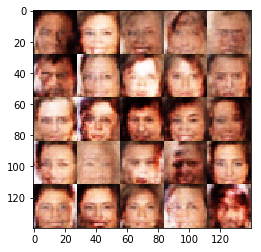

Epoch: 1/3 Discriminator Loss: 1.3268 Generator Loss: 0.8985
Epoch: 1/3 Discriminator Loss: 1.3052 Generator Loss: 0.7320
Epoch: 1/3 Discriminator Loss: 1.2359 Generator Loss: 0.8725
Epoch: 1/3 Discriminator Loss: 1.5603 Generator Loss: 0.4265
Epoch: 1/3 Discriminator Loss: 1.2292 Generator Loss: 0.9407
Epoch: 1/3 Discriminator Loss: 1.5239 Generator Loss: 0.6818
Epoch: 1/3 Discriminator Loss: 1.2048 Generator Loss: 0.8886
Epoch: 1/3 Discriminator Loss: 1.3768 Generator Loss: 0.7922
Epoch: 1/3 Discriminator Loss: 1.3221 Generator Loss: 0.7825
Epoch: 1/3 Discriminator Loss: 1.2599 Generator Loss: 0.9304


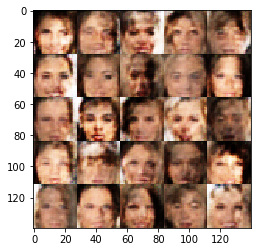

Epoch: 1/3 Discriminator Loss: 1.3716 Generator Loss: 0.8177
Epoch: 1/3 Discriminator Loss: 1.4049 Generator Loss: 0.6634
Epoch: 1/3 Discriminator Loss: 1.2446 Generator Loss: 0.8122
Epoch: 1/3 Discriminator Loss: 1.3484 Generator Loss: 0.7702
Epoch: 1/3 Discriminator Loss: 1.2609 Generator Loss: 0.9737
Epoch: 1/3 Discriminator Loss: 1.3107 Generator Loss: 0.7994
Epoch: 1/3 Discriminator Loss: 1.2047 Generator Loss: 1.0550
Epoch: 1/3 Discriminator Loss: 1.2874 Generator Loss: 1.0480
Epoch: 1/3 Discriminator Loss: 1.2074 Generator Loss: 0.8619
Epoch: 1/3 Discriminator Loss: 1.3225 Generator Loss: 0.7612


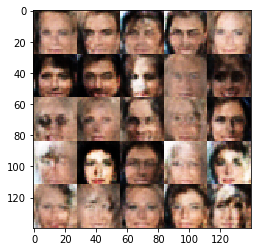

Epoch: 1/3 Discriminator Loss: 1.2898 Generator Loss: 0.6992
Epoch: 1/3 Discriminator Loss: 1.3470 Generator Loss: 0.7254
Epoch: 1/3 Discriminator Loss: 1.2536 Generator Loss: 0.8528
Epoch: 1/3 Discriminator Loss: 1.2161 Generator Loss: 0.7519
Epoch: 1/3 Discriminator Loss: 1.4026 Generator Loss: 0.7420
Epoch: 1/3 Discriminator Loss: 1.5237 Generator Loss: 0.7025
Epoch: 1/3 Discriminator Loss: 1.2634 Generator Loss: 0.8842
Epoch: 1/3 Discriminator Loss: 1.3459 Generator Loss: 0.7483
Epoch: 1/3 Discriminator Loss: 1.2991 Generator Loss: 0.8317
Epoch: 1/3 Discriminator Loss: 1.1585 Generator Loss: 0.8858


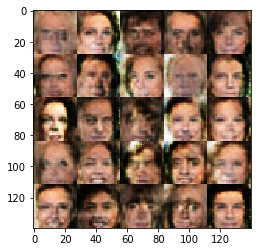

Epoch: 1/3 Discriminator Loss: 1.3964 Generator Loss: 0.7847
Epoch: 1/3 Discriminator Loss: 1.3337 Generator Loss: 0.7495
Epoch: 1/3 Discriminator Loss: 1.2951 Generator Loss: 0.7941
Epoch: 1/3 Discriminator Loss: 1.1817 Generator Loss: 0.7771
Epoch: 1/3 Discriminator Loss: 1.3509 Generator Loss: 0.8565
Epoch: 1/3 Discriminator Loss: 1.3654 Generator Loss: 1.1657
Epoch: 1/3 Discriminator Loss: 1.2210 Generator Loss: 1.0888
Epoch: 1/3 Discriminator Loss: 1.2521 Generator Loss: 0.8571
Epoch: 1/3 Discriminator Loss: 1.3835 Generator Loss: 0.6045
Epoch: 1/3 Discriminator Loss: 1.2729 Generator Loss: 0.7866


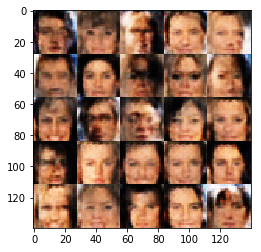

Epoch: 1/3 Discriminator Loss: 1.3660 Generator Loss: 0.7657
Epoch: 1/3 Discriminator Loss: 1.2724 Generator Loss: 0.9430
Epoch: 1/3 Discriminator Loss: 1.5625 Generator Loss: 0.5306
Epoch: 1/3 Discriminator Loss: 1.4047 Generator Loss: 0.8772
Epoch: 1/3 Discriminator Loss: 1.2959 Generator Loss: 0.8263
Epoch: 1/3 Discriminator Loss: 1.2583 Generator Loss: 0.8838
Epoch: 1/3 Discriminator Loss: 1.2308 Generator Loss: 1.0505
Epoch: 1/3 Discriminator Loss: 1.4845 Generator Loss: 0.8683
Epoch: 1/3 Discriminator Loss: 1.2945 Generator Loss: 0.7474
Epoch: 1/3 Discriminator Loss: 1.2716 Generator Loss: 0.7460


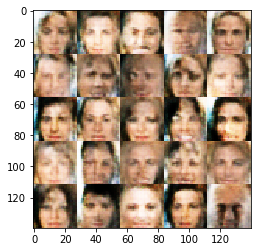

Epoch: 1/3 Discriminator Loss: 1.2565 Generator Loss: 1.2298
Epoch: 1/3 Discriminator Loss: 1.2066 Generator Loss: 0.8593
Epoch: 1/3 Discriminator Loss: 1.2720 Generator Loss: 1.0540
Epoch: 1/3 Discriminator Loss: 1.2950 Generator Loss: 0.7720
Epoch: 1/3 Discriminator Loss: 1.2456 Generator Loss: 0.8303
Epoch: 1/3 Discriminator Loss: 1.3804 Generator Loss: 0.6763
Epoch: 1/3 Discriminator Loss: 1.3320 Generator Loss: 0.7557
Epoch: 1/3 Discriminator Loss: 1.2647 Generator Loss: 0.8530
Epoch: 1/3 Discriminator Loss: 1.2495 Generator Loss: 0.9877
Epoch: 1/3 Discriminator Loss: 1.1904 Generator Loss: 1.2223


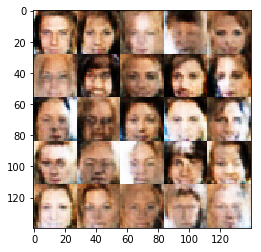

Epoch: 1/3 Discriminator Loss: 1.3171 Generator Loss: 0.7823
Epoch: 1/3 Discriminator Loss: 1.4900 Generator Loss: 0.5670
Epoch: 1/3 Discriminator Loss: 1.4101 Generator Loss: 0.6887
Epoch: 1/3 Discriminator Loss: 1.2939 Generator Loss: 0.8605
Epoch: 1/3 Discriminator Loss: 1.3000 Generator Loss: 0.6476
Epoch: 1/3 Discriminator Loss: 1.2539 Generator Loss: 0.8475
Epoch: 1/3 Discriminator Loss: 1.3926 Generator Loss: 0.7548
Epoch: 1/3 Discriminator Loss: 1.1148 Generator Loss: 1.0812
Epoch: 1/3 Discriminator Loss: 1.2894 Generator Loss: 0.7625
Epoch: 1/3 Discriminator Loss: 1.6509 Generator Loss: 0.5184


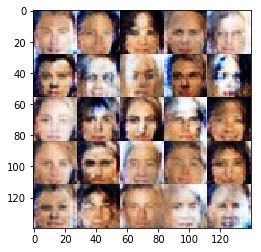

Epoch: 1/3 Discriminator Loss: 1.2908 Generator Loss: 0.7895
Epoch: 1/3 Discriminator Loss: 1.4530 Generator Loss: 0.8122
Epoch: 1/3 Discriminator Loss: 1.3098 Generator Loss: 0.7104
Epoch: 1/3 Discriminator Loss: 1.3713 Generator Loss: 0.7507
Epoch: 1/3 Discriminator Loss: 1.3746 Generator Loss: 0.7025
Epoch: 1/3 Discriminator Loss: 1.1578 Generator Loss: 1.0315
Epoch: 1/3 Discriminator Loss: 1.4029 Generator Loss: 0.6326
Epoch: 1/3 Discriminator Loss: 1.4194 Generator Loss: 0.7095
Epoch: 1/3 Discriminator Loss: 1.1659 Generator Loss: 0.9142
Epoch: 1/3 Discriminator Loss: 1.2757 Generator Loss: 0.8801


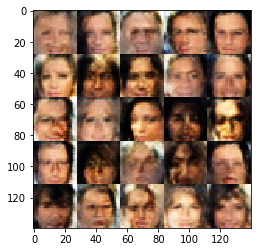

Epoch: 1/3 Discriminator Loss: 1.2046 Generator Loss: 0.9001
Epoch: 1/3 Discriminator Loss: 1.2511 Generator Loss: 0.8874
Epoch: 1/3 Discriminator Loss: 1.1805 Generator Loss: 1.1755
Epoch: 1/3 Discriminator Loss: 1.2195 Generator Loss: 0.8983
Epoch: 1/3 Discriminator Loss: 1.3338 Generator Loss: 1.3605
Epoch: 1/3 Discriminator Loss: 1.4679 Generator Loss: 0.8108
Epoch: 1/3 Discriminator Loss: 1.5799 Generator Loss: 0.8374
Epoch: 1/3 Discriminator Loss: 1.2625 Generator Loss: 0.8221
Epoch: 1/3 Discriminator Loss: 1.3743 Generator Loss: 0.7648
Epoch: 1/3 Discriminator Loss: 1.2431 Generator Loss: 0.8619


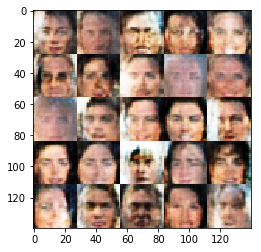

Epoch: 1/3 Discriminator Loss: 1.2143 Generator Loss: 1.1009
Epoch: 1/3 Discriminator Loss: 1.3464 Generator Loss: 0.7954
Epoch: 1/3 Discriminator Loss: 1.2500 Generator Loss: 0.9058
Epoch: 1/3 Discriminator Loss: 1.3952 Generator Loss: 0.8266
Epoch: 1/3 Discriminator Loss: 1.3054 Generator Loss: 0.8447
Epoch: 1/3 Discriminator Loss: 1.2230 Generator Loss: 0.8310
Epoch: 1/3 Discriminator Loss: 1.2997 Generator Loss: 0.7756
Epoch: 1/3 Discriminator Loss: 1.2358 Generator Loss: 0.7571
Epoch: 1/3 Discriminator Loss: 1.2577 Generator Loss: 1.2379
Epoch: 1/3 Discriminator Loss: 1.1896 Generator Loss: 0.8120


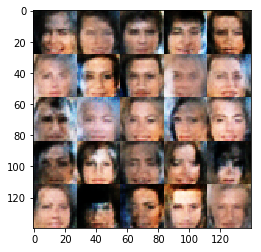

Epoch: 1/3 Discriminator Loss: 1.2903 Generator Loss: 0.8267
Epoch: 1/3 Discriminator Loss: 1.3392 Generator Loss: 0.7759
Epoch: 1/3 Discriminator Loss: 1.1255 Generator Loss: 0.9449
Epoch: 1/3 Discriminator Loss: 1.4302 Generator Loss: 0.5099
Epoch: 1/3 Discriminator Loss: 1.3433 Generator Loss: 0.8178
Epoch: 1/3 Discriminator Loss: 1.1592 Generator Loss: 0.9221
Epoch: 1/3 Discriminator Loss: 1.2151 Generator Loss: 0.9773
Epoch: 1/3 Discriminator Loss: 1.2065 Generator Loss: 1.0358
Epoch: 1/3 Discriminator Loss: 1.2549 Generator Loss: 0.8349
Epoch: 1/3 Discriminator Loss: 1.2560 Generator Loss: 0.7872


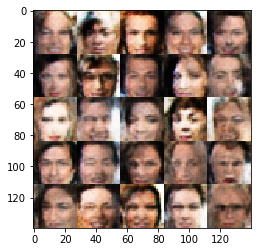

Epoch: 1/3 Discriminator Loss: 1.2650 Generator Loss: 0.7233
Epoch: 1/3 Discriminator Loss: 1.3679 Generator Loss: 0.6423
Epoch: 1/3 Discriminator Loss: 1.5223 Generator Loss: 0.5999
Epoch: 1/3 Discriminator Loss: 1.2371 Generator Loss: 0.7672
Epoch: 1/3 Discriminator Loss: 1.2181 Generator Loss: 0.8219
Epoch: 1/3 Discriminator Loss: 1.2557 Generator Loss: 0.8763
Epoch: 1/3 Discriminator Loss: 1.2730 Generator Loss: 0.7570
Epoch: 1/3 Discriminator Loss: 1.2631 Generator Loss: 0.9268
Epoch: 1/3 Discriminator Loss: 1.3039 Generator Loss: 0.7509
Epoch: 1/3 Discriminator Loss: 1.2204 Generator Loss: 0.9480


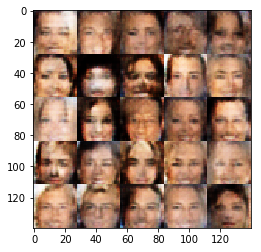

Epoch: 1/3 Discriminator Loss: 1.2568 Generator Loss: 0.6751
Epoch: 1/3 Discriminator Loss: 1.2521 Generator Loss: 0.7382
Epoch: 1/3 Discriminator Loss: 1.3068 Generator Loss: 0.7096
Epoch: 1/3 Discriminator Loss: 1.3096 Generator Loss: 0.6865
Epoch: 1/3 Discriminator Loss: 1.4150 Generator Loss: 0.8354
Epoch: 1/3 Discriminator Loss: 1.2924 Generator Loss: 0.8551
Epoch: 1/3 Discriminator Loss: 1.2207 Generator Loss: 0.9948
Epoch: 1/3 Discriminator Loss: 1.3018 Generator Loss: 0.9528
Epoch: 1/3 Discriminator Loss: 1.2950 Generator Loss: 0.7703
Epoch: 1/3 Discriminator Loss: 1.2172 Generator Loss: 0.7934


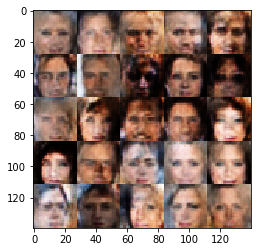

Epoch: 1/3 Discriminator Loss: 1.2378 Generator Loss: 1.0119
Epoch: 1/3 Discriminator Loss: 1.3497 Generator Loss: 0.9407
Epoch: 1/3 Discriminator Loss: 1.3676 Generator Loss: 0.6353
Epoch: 1/3 Discriminator Loss: 1.1763 Generator Loss: 0.9609
Epoch: 1/3 Discriminator Loss: 1.2706 Generator Loss: 0.8306
Epoch: 1/3 Discriminator Loss: 1.2697 Generator Loss: 0.7886
Epoch: 1/3 Discriminator Loss: 1.2905 Generator Loss: 0.7559
Epoch: 1/3 Discriminator Loss: 1.3866 Generator Loss: 0.6206
Epoch: 1/3 Discriminator Loss: 1.2759 Generator Loss: 0.8279
Epoch: 1/3 Discriminator Loss: 1.2213 Generator Loss: 0.8437


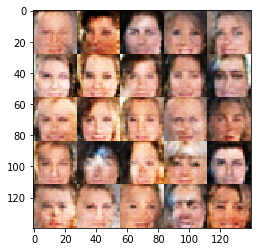

Epoch: 1/3 Discriminator Loss: 1.5488 Generator Loss: 0.7768
Epoch: 1/3 Discriminator Loss: 1.1677 Generator Loss: 0.9626
Epoch: 1/3 Discriminator Loss: 1.3654 Generator Loss: 0.9524
Epoch: 1/3 Discriminator Loss: 1.2216 Generator Loss: 0.8975
Epoch: 1/3 Discriminator Loss: 1.2359 Generator Loss: 0.8099
Epoch: 1/3 Discriminator Loss: 1.3866 Generator Loss: 0.7096
Epoch: 1/3 Discriminator Loss: 1.3566 Generator Loss: 0.7895
Epoch: 1/3 Discriminator Loss: 1.3282 Generator Loss: 0.6316
Epoch: 1/3 Discriminator Loss: 1.3055 Generator Loss: 0.8142
Epoch: 1/3 Discriminator Loss: 1.2691 Generator Loss: 0.7926


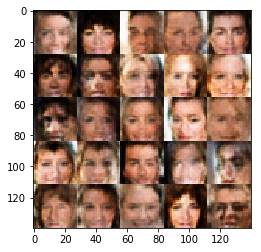

Epoch: 1/3 Discriminator Loss: 1.2662 Generator Loss: 0.8349
Epoch: 1/3 Discriminator Loss: 1.3420 Generator Loss: 0.7525
Epoch: 1/3 Discriminator Loss: 1.3550 Generator Loss: 0.8472
Epoch: 1/3 Discriminator Loss: 1.2785 Generator Loss: 0.7173
Epoch: 1/3 Discriminator Loss: 1.1632 Generator Loss: 0.9105
Epoch: 1/3 Discriminator Loss: 1.3071 Generator Loss: 0.7341
Epoch: 1/3 Discriminator Loss: 1.3043 Generator Loss: 0.7680
Epoch: 1/3 Discriminator Loss: 1.1934 Generator Loss: 0.9221
Epoch: 1/3 Discriminator Loss: 1.1673 Generator Loss: 0.7961
Epoch: 1/3 Discriminator Loss: 1.4217 Generator Loss: 0.6142


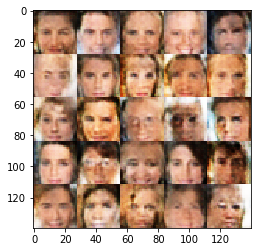

Epoch: 1/3 Discriminator Loss: 1.3975 Generator Loss: 0.7238
Epoch: 1/3 Discriminator Loss: 1.2918 Generator Loss: 0.8362
Epoch: 1/3 Discriminator Loss: 1.2411 Generator Loss: 0.8743
Epoch: 1/3 Discriminator Loss: 1.2928 Generator Loss: 0.7411
Epoch: 1/3 Discriminator Loss: 1.3233 Generator Loss: 1.0226
Epoch: 1/3 Discriminator Loss: 1.3446 Generator Loss: 0.6883
Epoch: 1/3 Discriminator Loss: 1.1989 Generator Loss: 1.0185
Epoch: 1/3 Discriminator Loss: 1.2380 Generator Loss: 0.8945
Epoch: 1/3 Discriminator Loss: 1.3161 Generator Loss: 1.0411
Epoch: 1/3 Discriminator Loss: 1.1898 Generator Loss: 0.9427


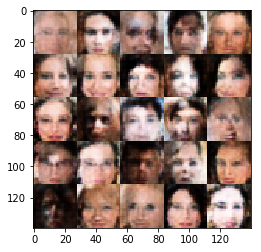

Epoch: 1/3 Discriminator Loss: 1.3669 Generator Loss: 0.7864
Epoch: 1/3 Discriminator Loss: 1.2254 Generator Loss: 0.8367
Epoch: 1/3 Discriminator Loss: 1.3023 Generator Loss: 0.7568
Epoch: 1/3 Discriminator Loss: 1.3910 Generator Loss: 1.2873
Epoch: 1/3 Discriminator Loss: 1.2484 Generator Loss: 0.7558
Epoch: 1/3 Discriminator Loss: 1.2756 Generator Loss: 0.7952
Epoch: 1/3 Discriminator Loss: 1.4464 Generator Loss: 0.8947
Epoch: 1/3 Discriminator Loss: 1.2464 Generator Loss: 0.7458
Epoch: 1/3 Discriminator Loss: 1.3383 Generator Loss: 0.6874
Epoch: 1/3 Discriminator Loss: 1.3371 Generator Loss: 0.7447


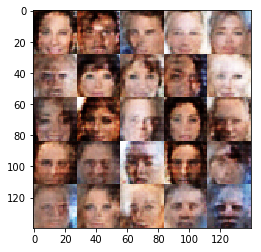

Epoch: 1/3 Discriminator Loss: 1.2580 Generator Loss: 0.8661
Epoch: 1/3 Discriminator Loss: 1.2555 Generator Loss: 0.9280
Epoch: 1/3 Discriminator Loss: 1.2610 Generator Loss: 0.8238
Epoch: 1/3 Discriminator Loss: 1.4611 Generator Loss: 0.7013
Epoch: 1/3 Discriminator Loss: 1.2573 Generator Loss: 0.7695
Epoch: 1/3 Discriminator Loss: 1.3259 Generator Loss: 0.7063
Epoch: 1/3 Discriminator Loss: 1.2949 Generator Loss: 0.7295
Epoch: 1/3 Discriminator Loss: 1.1080 Generator Loss: 1.0267
Epoch: 1/3 Discriminator Loss: 1.3934 Generator Loss: 0.7213
Epoch: 1/3 Discriminator Loss: 1.2515 Generator Loss: 1.0217


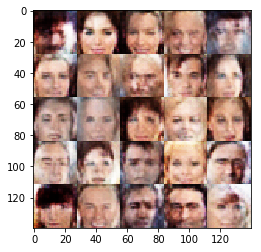

Epoch: 1/3 Discriminator Loss: 1.3260 Generator Loss: 0.8419
Epoch: 1/3 Discriminator Loss: 1.4129 Generator Loss: 0.6919
Epoch: 1/3 Discriminator Loss: 1.1796 Generator Loss: 0.8627
Epoch: 1/3 Discriminator Loss: 1.6359 Generator Loss: 0.5522
Epoch: 1/3 Discriminator Loss: 1.1927 Generator Loss: 0.9772
Epoch: 1/3 Discriminator Loss: 1.3486 Generator Loss: 0.8064
Epoch: 1/3 Discriminator Loss: 1.1548 Generator Loss: 1.0399
Epoch: 1/3 Discriminator Loss: 1.3304 Generator Loss: 0.8593
Epoch: 1/3 Discriminator Loss: 1.2835 Generator Loss: 0.8600
Epoch: 1/3 Discriminator Loss: 1.3050 Generator Loss: 0.7691


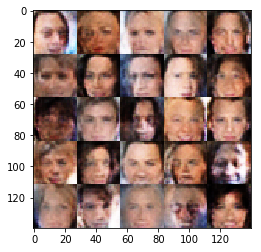

Epoch: 1/3 Discriminator Loss: 1.2770 Generator Loss: 0.6762
Epoch: 1/3 Discriminator Loss: 1.3259 Generator Loss: 0.7944
Epoch: 1/3 Discriminator Loss: 1.3596 Generator Loss: 0.7013
Epoch: 1/3 Discriminator Loss: 1.2507 Generator Loss: 0.8902
Epoch: 1/3 Discriminator Loss: 1.3327 Generator Loss: 0.8728
Epoch: 1/3 Discriminator Loss: 1.2732 Generator Loss: 0.8278
Epoch: 1/3 Discriminator Loss: 1.1884 Generator Loss: 1.0028
Epoch: 1/3 Discriminator Loss: 1.2755 Generator Loss: 0.8432
Epoch: 1/3 Discriminator Loss: 1.3718 Generator Loss: 1.0357
Epoch: 1/3 Discriminator Loss: 1.3941 Generator Loss: 0.7181


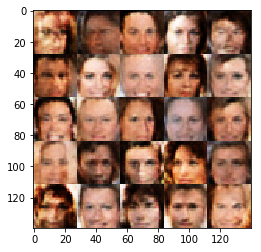

Epoch: 1/3 Discriminator Loss: 1.2078 Generator Loss: 0.9169
Epoch: 1/3 Discriminator Loss: 1.4071 Generator Loss: 0.7729
Epoch: 1/3 Discriminator Loss: 1.1578 Generator Loss: 1.0600
Epoch: 1/3 Discriminator Loss: 1.1966 Generator Loss: 0.9394
Epoch: 1/3 Discriminator Loss: 1.2829 Generator Loss: 0.7757
Epoch: 1/3 Discriminator Loss: 1.2474 Generator Loss: 0.7918
Epoch: 1/3 Discriminator Loss: 1.2920 Generator Loss: 1.2927
Epoch: 1/3 Discriminator Loss: 1.4419 Generator Loss: 0.9803
Epoch: 1/3 Discriminator Loss: 1.2688 Generator Loss: 0.7698
Epoch: 1/3 Discriminator Loss: 1.3148 Generator Loss: 0.7775


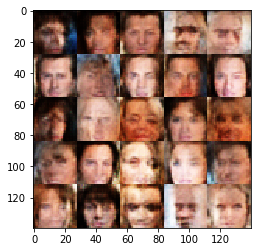

Epoch: 1/3 Discriminator Loss: 1.3075 Generator Loss: 0.9271
Epoch: 1/3 Discriminator Loss: 1.2891 Generator Loss: 0.7764
Epoch: 1/3 Discriminator Loss: 1.2812 Generator Loss: 0.7450
Epoch: 1/3 Discriminator Loss: 1.1920 Generator Loss: 0.8665
Epoch: 1/3 Discriminator Loss: 1.3397 Generator Loss: 0.9166
Epoch: 1/3 Discriminator Loss: 1.1418 Generator Loss: 1.0384
Epoch: 1/3 Discriminator Loss: 1.3218 Generator Loss: 0.8859
Epoch: 1/3 Discriminator Loss: 1.3539 Generator Loss: 1.1027
Epoch: 1/3 Discriminator Loss: 1.3403 Generator Loss: 0.7028
Epoch: 1/3 Discriminator Loss: 1.3245 Generator Loss: 0.7523


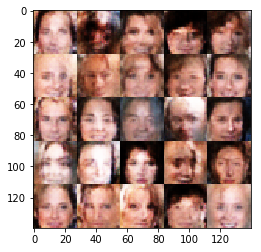

Epoch: 1/3 Discriminator Loss: 1.2881 Generator Loss: 0.8443
Epoch: 1/3 Discriminator Loss: 1.3273 Generator Loss: 0.8129
Epoch: 1/3 Discriminator Loss: 1.2569 Generator Loss: 0.9030
Epoch: 1/3 Discriminator Loss: 1.3497 Generator Loss: 0.7447
Epoch: 1/3 Discriminator Loss: 1.2509 Generator Loss: 0.8757
Epoch: 1/3 Discriminator Loss: 1.2719 Generator Loss: 0.9071
Epoch: 1/3 Discriminator Loss: 1.3177 Generator Loss: 0.8065
Epoch: 1/3 Discriminator Loss: 1.2489 Generator Loss: 0.9691
Epoch: 1/3 Discriminator Loss: 1.3387 Generator Loss: 0.7323
Epoch: 1/3 Discriminator Loss: 1.2462 Generator Loss: 0.9132


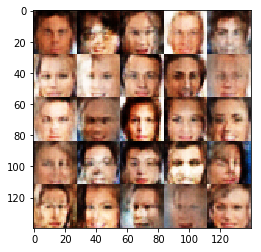

Epoch: 1/3 Discriminator Loss: 1.2886 Generator Loss: 0.8342
Epoch: 1/3 Discriminator Loss: 1.2598 Generator Loss: 0.8194
Epoch: 1/3 Discriminator Loss: 1.2401 Generator Loss: 0.9197
Epoch: 1/3 Discriminator Loss: 1.2333 Generator Loss: 0.7348
Epoch: 1/3 Discriminator Loss: 1.2709 Generator Loss: 0.8264
Epoch: 1/3 Discriminator Loss: 1.2699 Generator Loss: 0.8891
Epoch: 1/3 Discriminator Loss: 1.4765 Generator Loss: 0.5564
Epoch: 1/3 Discriminator Loss: 1.4329 Generator Loss: 0.7310
Epoch: 1/3 Discriminator Loss: 1.2246 Generator Loss: 0.8858
Epoch: 1/3 Discriminator Loss: 1.3686 Generator Loss: 0.6713


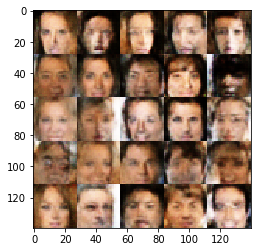

Epoch: 1/3 Discriminator Loss: 1.3281 Generator Loss: 0.7622
Epoch: 1/3 Discriminator Loss: 1.1978 Generator Loss: 0.8997
Epoch: 1/3 Discriminator Loss: 1.2745 Generator Loss: 0.7766
Epoch: 1/3 Discriminator Loss: 1.3379 Generator Loss: 0.8252
Epoch: 1/3 Discriminator Loss: 1.2196 Generator Loss: 0.8116
Epoch: 1/3 Discriminator Loss: 1.3232 Generator Loss: 0.7729
Epoch: 1/3 Discriminator Loss: 1.3340 Generator Loss: 0.7111
Epoch: 1/3 Discriminator Loss: 1.2937 Generator Loss: 0.8054
Epoch: 1/3 Discriminator Loss: 1.3692 Generator Loss: 0.8294
Epoch: 1/3 Discriminator Loss: 1.3548 Generator Loss: 0.8048


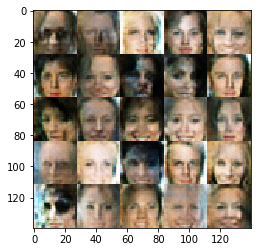

Epoch: 1/3 Discriminator Loss: 1.2516 Generator Loss: 0.8415
Epoch: 1/3 Discriminator Loss: 1.2951 Generator Loss: 0.7212
Epoch: 1/3 Discriminator Loss: 1.3277 Generator Loss: 0.7996
Epoch: 1/3 Discriminator Loss: 1.2429 Generator Loss: 0.9108
Epoch: 1/3 Discriminator Loss: 1.2358 Generator Loss: 0.8099
Epoch: 1/3 Discriminator Loss: 1.3095 Generator Loss: 0.6280
Epoch: 1/3 Discriminator Loss: 1.2955 Generator Loss: 0.7974
Epoch: 1/3 Discriminator Loss: 1.2431 Generator Loss: 0.8516
Epoch: 1/3 Discriminator Loss: 1.2453 Generator Loss: 0.9421
Epoch: 1/3 Discriminator Loss: 1.2336 Generator Loss: 0.8430


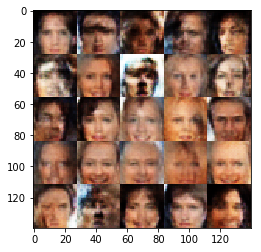

Epoch: 1/3 Discriminator Loss: 1.2693 Generator Loss: 0.6947
Epoch: 1/3 Discriminator Loss: 1.2501 Generator Loss: 0.8401
Epoch: 1/3 Discriminator Loss: 1.4206 Generator Loss: 0.5699
Epoch: 1/3 Discriminator Loss: 1.3241 Generator Loss: 0.7633
Epoch: 1/3 Discriminator Loss: 1.5113 Generator Loss: 0.5704
Epoch: 1/3 Discriminator Loss: 1.2637 Generator Loss: 0.7699
Epoch: 1/3 Discriminator Loss: 1.3938 Generator Loss: 0.6137
Epoch: 1/3 Discriminator Loss: 1.2551 Generator Loss: 0.8489
Epoch: 1/3 Discriminator Loss: 1.1901 Generator Loss: 0.8986
Epoch: 1/3 Discriminator Loss: 1.4207 Generator Loss: 0.5989


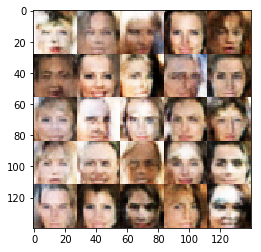

Epoch: 1/3 Discriminator Loss: 1.3893 Generator Loss: 0.6500
Epoch: 1/3 Discriminator Loss: 1.2385 Generator Loss: 0.8985
Epoch: 1/3 Discriminator Loss: 1.4023 Generator Loss: 0.7760
Epoch: 1/3 Discriminator Loss: 1.2250 Generator Loss: 0.8420
Epoch: 1/3 Discriminator Loss: 1.1440 Generator Loss: 0.9033
Epoch: 1/3 Discriminator Loss: 1.3451 Generator Loss: 0.7165
Epoch: 1/3 Discriminator Loss: 1.3027 Generator Loss: 0.8112
Epoch: 1/3 Discriminator Loss: 1.1921 Generator Loss: 0.8242
Epoch: 1/3 Discriminator Loss: 1.3159 Generator Loss: 0.6942
Epoch: 1/3 Discriminator Loss: 1.3580 Generator Loss: 0.7373


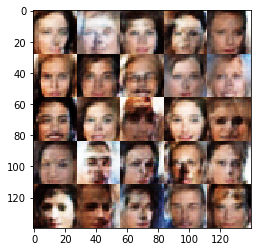

Epoch: 1/3 Discriminator Loss: 1.3460 Generator Loss: 0.7544
Epoch: 1/3 Discriminator Loss: 1.3528 Generator Loss: 0.6839
Epoch: 1/3 Discriminator Loss: 1.2433 Generator Loss: 0.9411
Epoch: 1/3 Discriminator Loss: 1.4387 Generator Loss: 0.6997
Epoch: 1/3 Discriminator Loss: 1.3332 Generator Loss: 0.6904
Epoch: 1/3 Discriminator Loss: 1.2654 Generator Loss: 0.9123
Epoch: 1/3 Discriminator Loss: 1.3499 Generator Loss: 0.7425
Epoch: 1/3 Discriminator Loss: 1.2383 Generator Loss: 0.9044
Epoch: 1/3 Discriminator Loss: 1.3014 Generator Loss: 0.9498
Epoch: 1/3 Discriminator Loss: 1.2468 Generator Loss: 0.7685


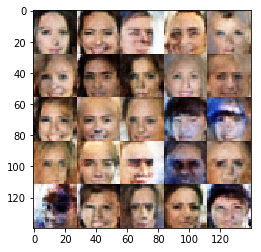

Epoch: 1/3 Discriminator Loss: 1.2776 Generator Loss: 0.8868
Epoch: 1/3 Discriminator Loss: 1.2615 Generator Loss: 0.9932
Epoch: 1/3 Discriminator Loss: 1.3510 Generator Loss: 0.6975
Epoch: 1/3 Discriminator Loss: 1.2259 Generator Loss: 0.8706
Epoch: 1/3 Discriminator Loss: 1.4124 Generator Loss: 0.7557
Epoch: 1/3 Discriminator Loss: 1.3928 Generator Loss: 0.6100
Epoch: 1/3 Discriminator Loss: 1.3010 Generator Loss: 0.6676
Epoch: 1/3 Discriminator Loss: 1.2605 Generator Loss: 0.8406
Epoch: 1/3 Discriminator Loss: 1.4369 Generator Loss: 0.7977
Epoch: 1/3 Discriminator Loss: 1.3948 Generator Loss: 0.8254


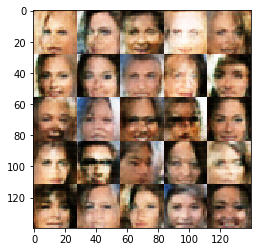

Epoch: 1/3 Discriminator Loss: 1.2047 Generator Loss: 0.9694
Epoch: 1/3 Discriminator Loss: 1.3376 Generator Loss: 0.7563
Epoch: 1/3 Discriminator Loss: 1.2101 Generator Loss: 0.8843
Epoch: 1/3 Discriminator Loss: 1.2703 Generator Loss: 0.7786
Epoch: 1/3 Discriminator Loss: 1.3643 Generator Loss: 0.8122
Epoch: 1/3 Discriminator Loss: 1.2776 Generator Loss: 0.8428
Epoch: 1/3 Discriminator Loss: 1.2634 Generator Loss: 0.9976
Epoch: 1/3 Discriminator Loss: 1.3148 Generator Loss: 0.7200
Epoch: 1/3 Discriminator Loss: 1.3071 Generator Loss: 0.9454
Epoch: 1/3 Discriminator Loss: 1.3236 Generator Loss: 0.9941


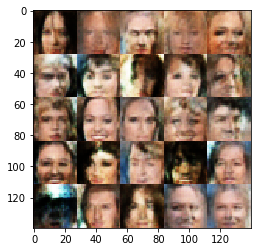

Epoch: 1/3 Discriminator Loss: 1.2226 Generator Loss: 0.9170
Epoch: 1/3 Discriminator Loss: 1.2727 Generator Loss: 0.9260
Epoch: 1/3 Discriminator Loss: 1.4091 Generator Loss: 0.7452
Epoch: 1/3 Discriminator Loss: 1.2364 Generator Loss: 0.8748
Epoch: 1/3 Discriminator Loss: 1.4275 Generator Loss: 0.7265
Epoch: 1/3 Discriminator Loss: 1.2480 Generator Loss: 0.7569
Epoch: 1/3 Discriminator Loss: 1.2929 Generator Loss: 0.7256
Epoch: 1/3 Discriminator Loss: 1.4807 Generator Loss: 0.6141
Epoch: 1/3 Discriminator Loss: 1.2164 Generator Loss: 0.9330
Epoch: 1/3 Discriminator Loss: 1.2686 Generator Loss: 0.8089


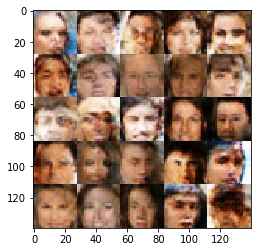

Epoch: 1/3 Discriminator Loss: 1.2595 Generator Loss: 0.8159
Epoch: 1/3 Discriminator Loss: 1.2777 Generator Loss: 0.7224
Epoch: 1/3 Discriminator Loss: 1.3404 Generator Loss: 0.6904
Epoch: 1/3 Discriminator Loss: 1.2331 Generator Loss: 0.9437
Epoch: 1/3 Discriminator Loss: 1.2313 Generator Loss: 0.9693
Epoch: 1/3 Discriminator Loss: 1.3289 Generator Loss: 0.6737
Epoch: 1/3 Discriminator Loss: 1.3194 Generator Loss: 0.7602
Epoch: 1/3 Discriminator Loss: 1.3005 Generator Loss: 0.8867
Epoch: 1/3 Discriminator Loss: 1.3018 Generator Loss: 0.7500
Epoch: 1/3 Discriminator Loss: 1.2478 Generator Loss: 0.8999


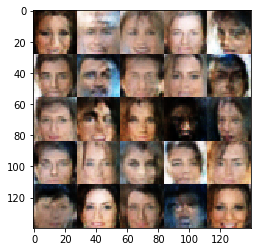

Epoch: 1/3 Discriminator Loss: 1.3467 Generator Loss: 0.9041
Epoch: 1/3 Discriminator Loss: 1.5080 Generator Loss: 0.5370
Epoch: 1/3 Discriminator Loss: 1.3011 Generator Loss: 0.7281
Epoch: 1/3 Discriminator Loss: 1.2831 Generator Loss: 0.7504
Epoch: 1/3 Discriminator Loss: 1.4840 Generator Loss: 0.6237
Epoch: 1/3 Discriminator Loss: 1.2074 Generator Loss: 0.8964
Epoch: 1/3 Discriminator Loss: 1.2477 Generator Loss: 0.7978
Epoch: 1/3 Discriminator Loss: 1.3658 Generator Loss: 0.8420
Epoch: 1/3 Discriminator Loss: 1.2481 Generator Loss: 0.7903
Epoch: 1/3 Discriminator Loss: 1.2775 Generator Loss: 0.9187


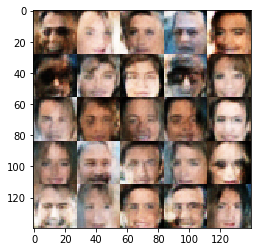

Epoch: 1/3 Discriminator Loss: 1.3487 Generator Loss: 0.8581
Epoch: 1/3 Discriminator Loss: 1.3454 Generator Loss: 0.8169
Epoch: 1/3 Discriminator Loss: 1.1898 Generator Loss: 0.8785
Epoch: 1/3 Discriminator Loss: 1.3782 Generator Loss: 0.7549
Epoch: 1/3 Discriminator Loss: 1.3230 Generator Loss: 0.9579
Epoch: 1/3 Discriminator Loss: 1.3133 Generator Loss: 0.7823
Epoch: 1/3 Discriminator Loss: 1.2537 Generator Loss: 0.7140
Epoch: 1/3 Discriminator Loss: 1.3217 Generator Loss: 0.8598
Epoch: 1/3 Discriminator Loss: 1.3650 Generator Loss: 0.6870
Epoch: 1/3 Discriminator Loss: 1.2831 Generator Loss: 0.7696


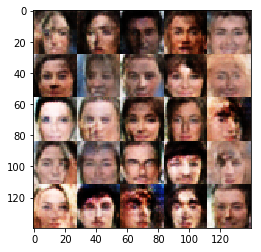

Epoch: 1/3 Discriminator Loss: 1.4393 Generator Loss: 0.7346
Epoch: 1/3 Discriminator Loss: 1.2391 Generator Loss: 0.8713
Epoch: 1/3 Discriminator Loss: 1.2742 Generator Loss: 0.7842
Epoch: 1/3 Discriminator Loss: 1.3046 Generator Loss: 0.8601
Epoch: 1/3 Discriminator Loss: 1.4805 Generator Loss: 0.7510
Epoch: 1/3 Discriminator Loss: 1.1636 Generator Loss: 0.8922
Epoch: 1/3 Discriminator Loss: 1.3676 Generator Loss: 0.7294
Epoch: 1/3 Discriminator Loss: 1.3230 Generator Loss: 0.6711
Epoch: 1/3 Discriminator Loss: 1.2492 Generator Loss: 0.8669
Epoch: 1/3 Discriminator Loss: 1.2959 Generator Loss: 0.8190


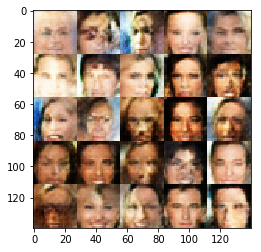

Epoch: 1/3 Discriminator Loss: 1.3291 Generator Loss: 0.7161
Epoch: 1/3 Discriminator Loss: 1.2596 Generator Loss: 0.8399
Epoch: 1/3 Discriminator Loss: 1.3016 Generator Loss: 0.7506
Epoch: 1/3 Discriminator Loss: 1.2961 Generator Loss: 0.7444
Epoch: 1/3 Discriminator Loss: 1.3267 Generator Loss: 0.8486
Epoch: 1/3 Discriminator Loss: 1.3580 Generator Loss: 0.7881
Epoch: 1/3 Discriminator Loss: 1.2336 Generator Loss: 0.9888
Epoch: 1/3 Discriminator Loss: 1.3608 Generator Loss: 0.8065
Epoch: 1/3 Discriminator Loss: 1.3092 Generator Loss: 0.7825
Epoch: 1/3 Discriminator Loss: 1.4002 Generator Loss: 0.7222


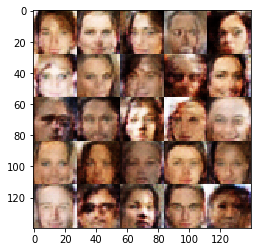

Epoch: 1/3 Discriminator Loss: 1.4275 Generator Loss: 0.6953
Epoch: 1/3 Discriminator Loss: 1.2146 Generator Loss: 0.9117
Epoch: 1/3 Discriminator Loss: 1.3738 Generator Loss: 0.9177
Epoch: 1/3 Discriminator Loss: 1.3080 Generator Loss: 0.8016
Epoch: 1/3 Discriminator Loss: 1.2410 Generator Loss: 0.7792
Epoch: 1/3 Discriminator Loss: 1.3002 Generator Loss: 0.7958
Epoch: 1/3 Discriminator Loss: 1.2349 Generator Loss: 0.8611
Epoch: 1/3 Discriminator Loss: 1.2609 Generator Loss: 0.8500
Epoch: 1/3 Discriminator Loss: 1.3570 Generator Loss: 0.5795
Epoch: 1/3 Discriminator Loss: 1.3800 Generator Loss: 0.7998


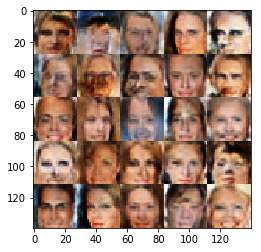

Epoch: 1/3 Discriminator Loss: 1.2734 Generator Loss: 0.9518
Epoch: 1/3 Discriminator Loss: 1.2742 Generator Loss: 0.8791
Epoch: 1/3 Discriminator Loss: 1.2665 Generator Loss: 0.7792
Epoch: 1/3 Discriminator Loss: 1.4378 Generator Loss: 0.8774
Epoch: 1/3 Discriminator Loss: 1.2765 Generator Loss: 0.8849
Epoch: 1/3 Discriminator Loss: 1.2559 Generator Loss: 0.8920
Epoch: 1/3 Discriminator Loss: 1.3051 Generator Loss: 0.8364
Epoch: 1/3 Discriminator Loss: 1.2148 Generator Loss: 0.9262
Epoch: 1/3 Discriminator Loss: 1.2399 Generator Loss: 0.7647
Epoch: 1/3 Discriminator Loss: 1.4887 Generator Loss: 0.5180


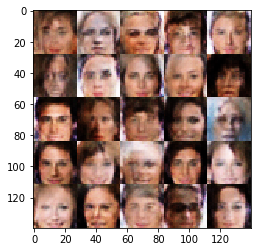

Epoch: 1/3 Discriminator Loss: 1.2184 Generator Loss: 0.9432
Epoch: 1/3 Discriminator Loss: 1.3348 Generator Loss: 0.7086
Epoch: 1/3 Discriminator Loss: 1.1943 Generator Loss: 0.8911
Epoch: 1/3 Discriminator Loss: 1.3247 Generator Loss: 0.7095
Epoch: 1/3 Discriminator Loss: 1.4093 Generator Loss: 0.6683
Epoch: 1/3 Discriminator Loss: 1.2266 Generator Loss: 0.9255
Epoch: 1/3 Discriminator Loss: 1.3169 Generator Loss: 0.8355
Epoch: 1/3 Discriminator Loss: 1.2803 Generator Loss: 0.7579
Epoch: 1/3 Discriminator Loss: 1.2525 Generator Loss: 0.9581
Epoch: 1/3 Discriminator Loss: 1.2377 Generator Loss: 0.9021


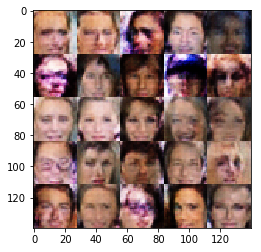

Epoch: 1/3 Discriminator Loss: 1.2757 Generator Loss: 0.7248
Epoch: 1/3 Discriminator Loss: 1.2625 Generator Loss: 0.8283
Epoch: 1/3 Discriminator Loss: 1.3239 Generator Loss: 0.8400
Epoch: 1/3 Discriminator Loss: 1.2879 Generator Loss: 0.8650
Epoch: 1/3 Discriminator Loss: 1.2406 Generator Loss: 0.8750
Epoch: 1/3 Discriminator Loss: 1.2910 Generator Loss: 0.8108
Epoch: 1/3 Discriminator Loss: 1.2304 Generator Loss: 0.7969
Epoch: 1/3 Discriminator Loss: 1.3024 Generator Loss: 0.7188
Epoch: 1/3 Discriminator Loss: 1.2611 Generator Loss: 0.8025
Epoch: 1/3 Discriminator Loss: 1.2986 Generator Loss: 0.6919


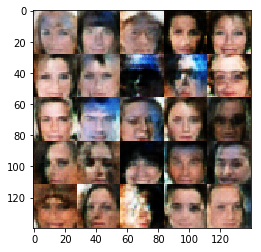

Epoch: 1/3 Discriminator Loss: 1.3860 Generator Loss: 0.6537
Epoch: 1/3 Discriminator Loss: 1.2220 Generator Loss: 1.1831
Epoch: 1/3 Discriminator Loss: 1.2807 Generator Loss: 0.8671
Epoch: 1/3 Discriminator Loss: 1.3647 Generator Loss: 0.7960
Epoch: 1/3 Discriminator Loss: 1.3201 Generator Loss: 0.8805
Epoch: 1/3 Discriminator Loss: 1.1865 Generator Loss: 0.9678
Epoch: 1/3 Discriminator Loss: 1.2933 Generator Loss: 0.8908
Epoch: 1/3 Discriminator Loss: 1.3696 Generator Loss: 0.6997
Epoch: 1/3 Discriminator Loss: 1.1896 Generator Loss: 0.7742
Epoch: 1/3 Discriminator Loss: 1.4267 Generator Loss: 0.8256


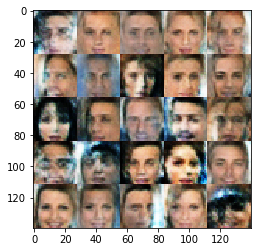

Epoch: 1/3 Discriminator Loss: 1.2940 Generator Loss: 0.9536
Epoch: 1/3 Discriminator Loss: 1.3209 Generator Loss: 1.0034
Epoch: 1/3 Discriminator Loss: 1.2333 Generator Loss: 0.8830
Epoch: 1/3 Discriminator Loss: 1.2735 Generator Loss: 0.7344
Epoch: 1/3 Discriminator Loss: 1.1852 Generator Loss: 0.8537
Epoch: 1/3 Discriminator Loss: 1.2454 Generator Loss: 0.9177
Epoch: 1/3 Discriminator Loss: 1.2616 Generator Loss: 0.9163
Epoch: 1/3 Discriminator Loss: 1.3672 Generator Loss: 0.8734
Epoch: 1/3 Discriminator Loss: 1.2587 Generator Loss: 0.7083
Epoch: 1/3 Discriminator Loss: 1.4329 Generator Loss: 0.9243


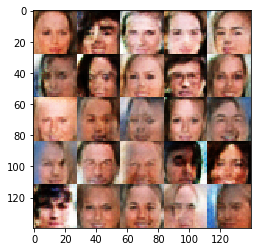

Epoch: 1/3 Discriminator Loss: 1.2366 Generator Loss: 0.8804
Epoch: 1/3 Discriminator Loss: 1.3365 Generator Loss: 0.8000
Epoch: 1/3 Discriminator Loss: 1.4524 Generator Loss: 0.8200
Epoch: 1/3 Discriminator Loss: 1.1953 Generator Loss: 1.0105
Epoch: 1/3 Discriminator Loss: 1.2436 Generator Loss: 0.7560
Epoch: 1/3 Discriminator Loss: 1.2599 Generator Loss: 0.9785
Epoch: 1/3 Discriminator Loss: 1.2245 Generator Loss: 0.9508
Epoch: 1/3 Discriminator Loss: 1.2046 Generator Loss: 0.8324
Epoch: 1/3 Discriminator Loss: 1.4191 Generator Loss: 0.7200
Epoch: 1/3 Discriminator Loss: 1.0610 Generator Loss: 1.0605


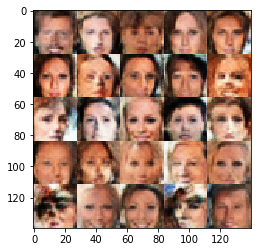

Epoch: 1/3 Discriminator Loss: 1.4370 Generator Loss: 0.5708
Epoch: 1/3 Discriminator Loss: 1.3447 Generator Loss: 0.8448
Epoch: 1/3 Discriminator Loss: 1.2717 Generator Loss: 0.8948
Epoch: 1/3 Discriminator Loss: 1.1572 Generator Loss: 0.8673
Epoch: 1/3 Discriminator Loss: 1.4409 Generator Loss: 0.4934
Epoch: 1/3 Discriminator Loss: 1.3381 Generator Loss: 0.8119
Epoch: 1/3 Discriminator Loss: 1.5022 Generator Loss: 0.7286
Epoch: 1/3 Discriminator Loss: 1.1862 Generator Loss: 1.0577
Epoch: 1/3 Discriminator Loss: 1.3952 Generator Loss: 0.7203
Epoch: 1/3 Discriminator Loss: 1.1998 Generator Loss: 0.9261


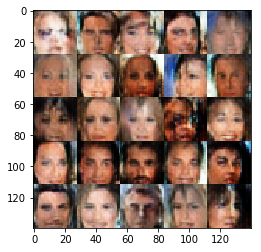

Epoch: 1/3 Discriminator Loss: 1.3211 Generator Loss: 0.7725
Epoch: 1/3 Discriminator Loss: 1.3596 Generator Loss: 0.8541
Epoch: 1/3 Discriminator Loss: 1.1941 Generator Loss: 0.8014
Epoch: 1/3 Discriminator Loss: 1.3525 Generator Loss: 0.7950
Epoch: 1/3 Discriminator Loss: 1.2734 Generator Loss: 0.7161
Epoch: 1/3 Discriminator Loss: 1.2674 Generator Loss: 0.8412
Epoch: 1/3 Discriminator Loss: 1.3012 Generator Loss: 0.7554
Epoch: 1/3 Discriminator Loss: 1.3161 Generator Loss: 1.1407
Epoch: 1/3 Discriminator Loss: 1.1930 Generator Loss: 0.9809
Epoch: 1/3 Discriminator Loss: 1.2384 Generator Loss: 0.9169


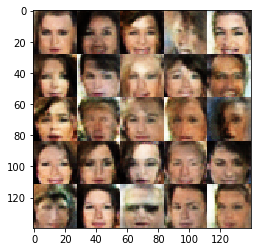

Epoch: 1/3 Discriminator Loss: 1.2947 Generator Loss: 0.7157
Epoch: 1/3 Discriminator Loss: 1.2559 Generator Loss: 0.9481
Epoch: 1/3 Discriminator Loss: 1.3279 Generator Loss: 0.6618
Epoch: 1/3 Discriminator Loss: 1.3086 Generator Loss: 0.9237
Epoch: 1/3 Discriminator Loss: 1.3348 Generator Loss: 0.7534
Epoch: 1/3 Discriminator Loss: 1.2709 Generator Loss: 0.8276
Epoch: 1/3 Discriminator Loss: 1.2552 Generator Loss: 1.0910
Epoch: 1/3 Discriminator Loss: 1.2700 Generator Loss: 1.0621
Epoch: 1/3 Discriminator Loss: 1.3736 Generator Loss: 0.7037
Epoch: 1/3 Discriminator Loss: 1.2855 Generator Loss: 0.8899


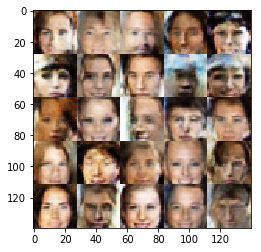

Epoch: 1/3 Discriminator Loss: 1.2666 Generator Loss: 0.7232
Epoch: 1/3 Discriminator Loss: 1.2905 Generator Loss: 0.9752
Epoch: 1/3 Discriminator Loss: 1.3556 Generator Loss: 0.6625
Epoch: 1/3 Discriminator Loss: 1.2529 Generator Loss: 0.7797
Epoch: 1/3 Discriminator Loss: 1.2356 Generator Loss: 0.8074
Epoch: 1/3 Discriminator Loss: 1.2397 Generator Loss: 0.9278
Epoch: 1/3 Discriminator Loss: 1.3807 Generator Loss: 0.6757
Epoch: 1/3 Discriminator Loss: 1.2126 Generator Loss: 0.9272
Epoch: 1/3 Discriminator Loss: 1.3361 Generator Loss: 0.7439
Epoch: 1/3 Discriminator Loss: 1.2800 Generator Loss: 0.8594


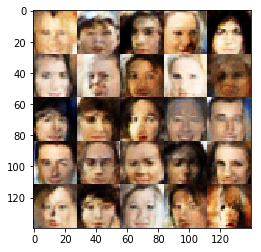

Epoch: 1/3 Discriminator Loss: 1.2315 Generator Loss: 0.8206
Epoch: 1/3 Discriminator Loss: 1.3036 Generator Loss: 0.8447
Epoch: 1/3 Discriminator Loss: 1.2104 Generator Loss: 1.0105
Epoch: 1/3 Discriminator Loss: 1.2588 Generator Loss: 0.8744
Epoch: 1/3 Discriminator Loss: 1.2766 Generator Loss: 0.7915
Epoch: 1/3 Discriminator Loss: 1.2998 Generator Loss: 0.6834
Epoch: 1/3 Discriminator Loss: 1.2030 Generator Loss: 1.0687
Epoch: 1/3 Discriminator Loss: 1.2014 Generator Loss: 0.9296
Epoch: 1/3 Discriminator Loss: 1.3348 Generator Loss: 0.6801
Epoch: 1/3 Discriminator Loss: 1.3025 Generator Loss: 0.8123


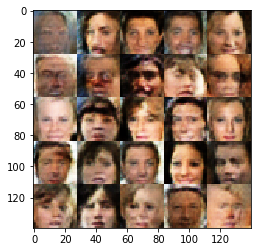

Epoch: 1/3 Discriminator Loss: 1.2737 Generator Loss: 1.0162
Epoch: 1/3 Discriminator Loss: 1.3294 Generator Loss: 0.7803
Epoch: 1/3 Discriminator Loss: 1.2491 Generator Loss: 0.9015
Epoch: 1/3 Discriminator Loss: 1.1670 Generator Loss: 0.8844
Epoch: 1/3 Discriminator Loss: 1.4155 Generator Loss: 0.6987
Epoch: 1/3 Discriminator Loss: 1.0535 Generator Loss: 0.9687
Epoch: 1/3 Discriminator Loss: 1.3787 Generator Loss: 1.1447
Epoch: 1/3 Discriminator Loss: 1.3587 Generator Loss: 0.6606
Epoch: 1/3 Discriminator Loss: 1.1707 Generator Loss: 0.9028
Epoch: 1/3 Discriminator Loss: 1.3046 Generator Loss: 0.7388


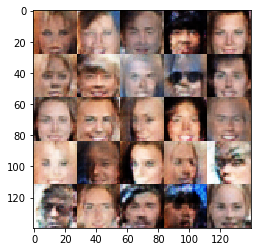

Epoch: 1/3 Discriminator Loss: 1.2949 Generator Loss: 0.7165
Epoch: 1/3 Discriminator Loss: 1.2374 Generator Loss: 0.9032
Epoch: 1/3 Discriminator Loss: 1.3299 Generator Loss: 0.7351
Epoch: 1/3 Discriminator Loss: 1.3115 Generator Loss: 0.7120
Epoch: 1/3 Discriminator Loss: 1.2680 Generator Loss: 0.9086
Epoch: 1/3 Discriminator Loss: 1.1993 Generator Loss: 1.1966
Epoch: 1/3 Discriminator Loss: 1.2404 Generator Loss: 0.9659
Epoch: 1/3 Discriminator Loss: 1.2180 Generator Loss: 0.8251
Epoch: 1/3 Discriminator Loss: 1.2565 Generator Loss: 1.0330
Epoch: 1/3 Discriminator Loss: 1.2942 Generator Loss: 0.7795


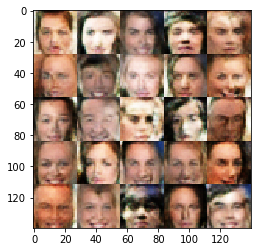

Epoch: 1/3 Discriminator Loss: 1.2741 Generator Loss: 0.8340
Epoch: 1/3 Discriminator Loss: 1.3206 Generator Loss: 0.7093
Epoch: 1/3 Discriminator Loss: 1.2298 Generator Loss: 0.9363
Epoch: 1/3 Discriminator Loss: 1.1747 Generator Loss: 0.8697
Epoch: 1/3 Discriminator Loss: 1.2872 Generator Loss: 0.7434
Epoch: 1/3 Discriminator Loss: 1.1979 Generator Loss: 0.8414
Epoch: 1/3 Discriminator Loss: 1.2696 Generator Loss: 0.9579
Epoch: 1/3 Discriminator Loss: 1.2927 Generator Loss: 0.7192
Epoch: 1/3 Discriminator Loss: 1.2387 Generator Loss: 0.7244
Epoch: 1/3 Discriminator Loss: 1.2635 Generator Loss: 0.7871


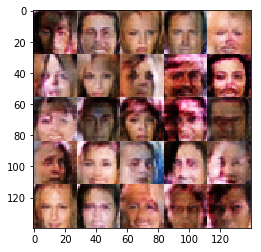

Epoch: 1/3 Discriminator Loss: 1.2537 Generator Loss: 0.8532
Epoch: 1/3 Discriminator Loss: 1.2858 Generator Loss: 1.1638
Epoch: 1/3 Discriminator Loss: 1.3757 Generator Loss: 0.5946
Epoch: 1/3 Discriminator Loss: 1.3520 Generator Loss: 0.6787
Epoch: 1/3 Discriminator Loss: 1.1668 Generator Loss: 1.0176
Epoch: 1/3 Discriminator Loss: 1.2581 Generator Loss: 0.9425
Epoch: 1/3 Discriminator Loss: 1.2086 Generator Loss: 0.8313
Epoch: 1/3 Discriminator Loss: 1.2083 Generator Loss: 0.9068
Epoch: 1/3 Discriminator Loss: 1.2065 Generator Loss: 0.9007
Epoch: 1/3 Discriminator Loss: 1.3295 Generator Loss: 1.0202


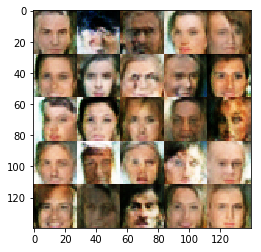

Epoch: 1/3 Discriminator Loss: 1.4272 Generator Loss: 0.5915
Epoch: 1/3 Discriminator Loss: 1.1646 Generator Loss: 0.8463
Epoch: 1/3 Discriminator Loss: 1.3518 Generator Loss: 0.6701
Epoch: 1/3 Discriminator Loss: 1.2924 Generator Loss: 0.8881
Epoch: 1/3 Discriminator Loss: 1.2245 Generator Loss: 0.7716
Epoch: 1/3 Discriminator Loss: 1.3710 Generator Loss: 0.6932
Epoch: 1/3 Discriminator Loss: 1.3063 Generator Loss: 0.9129
Epoch: 1/3 Discriminator Loss: 1.2413 Generator Loss: 1.0226
Epoch: 1/3 Discriminator Loss: 1.2207 Generator Loss: 0.8603
Epoch: 1/3 Discriminator Loss: 1.2514 Generator Loss: 0.8326


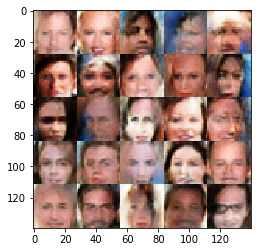

Epoch: 1/3 Discriminator Loss: 1.2798 Generator Loss: 0.8578
Epoch: 1/3 Discriminator Loss: 1.4589 Generator Loss: 0.6855
Epoch: 1/3 Discriminator Loss: 1.3100 Generator Loss: 0.7966
Epoch: 1/3 Discriminator Loss: 1.3053 Generator Loss: 0.7292
Epoch: 1/3 Discriminator Loss: 1.2153 Generator Loss: 0.7401
Epoch: 1/3 Discriminator Loss: 1.4364 Generator Loss: 1.0844
Epoch: 1/3 Discriminator Loss: 1.5069 Generator Loss: 0.6432
Epoch: 1/3 Discriminator Loss: 1.1668 Generator Loss: 0.8439
Epoch: 1/3 Discriminator Loss: 1.2676 Generator Loss: 0.8076
Epoch: 1/3 Discriminator Loss: 1.3300 Generator Loss: 0.7637


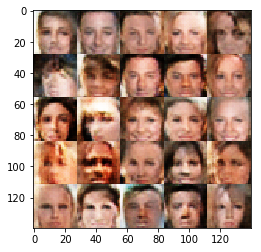

Epoch: 1/3 Discriminator Loss: 1.1996 Generator Loss: 0.8113
Epoch: 1/3 Discriminator Loss: 1.2266 Generator Loss: 0.9783
Epoch: 1/3 Discriminator Loss: 1.2090 Generator Loss: 0.8187
Epoch: 1/3 Discriminator Loss: 1.1940 Generator Loss: 0.8560
Epoch: 1/3 Discriminator Loss: 1.2595 Generator Loss: 0.9115
Epoch: 1/3 Discriminator Loss: 1.3093 Generator Loss: 0.7051
Epoch: 1/3 Discriminator Loss: 1.2901 Generator Loss: 0.7273
Epoch: 1/3 Discriminator Loss: 1.3701 Generator Loss: 0.6343
Epoch: 1/3 Discriminator Loss: 1.2397 Generator Loss: 0.9303
Epoch: 1/3 Discriminator Loss: 1.2078 Generator Loss: 0.8919


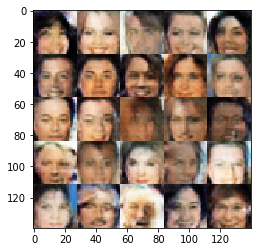

Epoch: 1/3 Discriminator Loss: 1.2798 Generator Loss: 0.8154
Epoch: 1/3 Discriminator Loss: 1.2495 Generator Loss: 1.0709
Epoch: 1/3 Discriminator Loss: 1.2794 Generator Loss: 0.8365
Epoch: 1/3 Discriminator Loss: 1.3979 Generator Loss: 0.7945
Epoch: 1/3 Discriminator Loss: 1.2770 Generator Loss: 0.8060
Epoch: 1/3 Discriminator Loss: 1.2169 Generator Loss: 0.8062
Epoch: 1/3 Discriminator Loss: 1.2463 Generator Loss: 0.9086
Epoch: 1/3 Discriminator Loss: 1.3022 Generator Loss: 0.9324
Epoch: 1/3 Discriminator Loss: 1.3124 Generator Loss: 0.7417
Epoch: 1/3 Discriminator Loss: 1.3356 Generator Loss: 0.7801


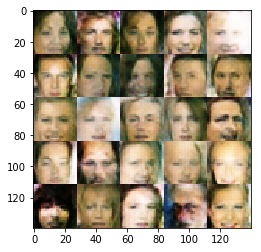

Epoch: 1/3 Discriminator Loss: 1.3106 Generator Loss: 0.6281
Epoch: 1/3 Discriminator Loss: 1.2912 Generator Loss: 0.6344
Epoch: 1/3 Discriminator Loss: 1.2528 Generator Loss: 1.0109
Epoch: 1/3 Discriminator Loss: 1.3956 Generator Loss: 0.7957
Epoch: 1/3 Discriminator Loss: 1.2026 Generator Loss: 0.8876
Epoch: 1/3 Discriminator Loss: 1.3754 Generator Loss: 0.8986
Epoch: 1/3 Discriminator Loss: 1.3266 Generator Loss: 0.7876
Epoch: 1/3 Discriminator Loss: 1.3646 Generator Loss: 0.7389
Epoch: 1/3 Discriminator Loss: 1.2934 Generator Loss: 0.7552
Epoch: 1/3 Discriminator Loss: 1.3301 Generator Loss: 0.7674


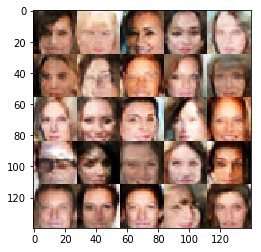

Epoch: 1/3 Discriminator Loss: 1.2724 Generator Loss: 0.8366
Epoch: 1/3 Discriminator Loss: 1.2714 Generator Loss: 1.0139
Epoch: 1/3 Discriminator Loss: 1.2698 Generator Loss: 0.8183
Epoch: 1/3 Discriminator Loss: 1.3432 Generator Loss: 0.7540
Epoch: 1/3 Discriminator Loss: 1.1819 Generator Loss: 1.0625
Epoch: 1/3 Discriminator Loss: 1.2297 Generator Loss: 0.8163
Epoch: 1/3 Discriminator Loss: 1.4443 Generator Loss: 0.6599
Epoch: 1/3 Discriminator Loss: 1.3330 Generator Loss: 0.6867
Epoch: 1/3 Discriminator Loss: 1.2620 Generator Loss: 0.6753
Epoch: 1/3 Discriminator Loss: 1.3317 Generator Loss: 0.8132


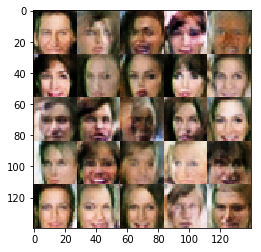

Epoch: 1/3 Discriminator Loss: 1.3614 Generator Loss: 0.6034
Epoch: 1/3 Discriminator Loss: 1.2989 Generator Loss: 0.8046
Epoch: 1/3 Discriminator Loss: 1.2457 Generator Loss: 0.8362
Epoch: 1/3 Discriminator Loss: 1.2586 Generator Loss: 0.8589
Epoch: 1/3 Discriminator Loss: 1.2554 Generator Loss: 0.7520
Epoch: 1/3 Discriminator Loss: 1.2765 Generator Loss: 0.8212
Epoch: 1/3 Discriminator Loss: 1.2196 Generator Loss: 0.8641
Epoch: 1/3 Discriminator Loss: 1.3530 Generator Loss: 0.7256
Epoch: 1/3 Discriminator Loss: 1.2066 Generator Loss: 0.8160
Epoch: 1/3 Discriminator Loss: 1.3042 Generator Loss: 0.8772


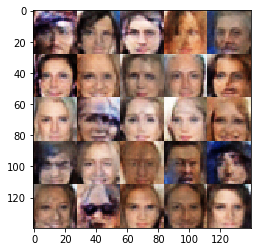

Epoch: 1/3 Discriminator Loss: 1.2972 Generator Loss: 0.6757
Epoch: 1/3 Discriminator Loss: 1.2019 Generator Loss: 0.8119
Epoch: 1/3 Discriminator Loss: 1.2168 Generator Loss: 1.0853
Epoch: 1/3 Discriminator Loss: 1.3230 Generator Loss: 0.8567
Epoch: 1/3 Discriminator Loss: 1.3914 Generator Loss: 0.8426
Epoch: 1/3 Discriminator Loss: 1.1977 Generator Loss: 0.9373
Epoch: 1/3 Discriminator Loss: 1.2717 Generator Loss: 0.8339
Epoch: 1/3 Discriminator Loss: 1.4335 Generator Loss: 0.9390
Epoch: 1/3 Discriminator Loss: 1.2550 Generator Loss: 0.8600
Epoch: 1/3 Discriminator Loss: 1.3123 Generator Loss: 0.8738


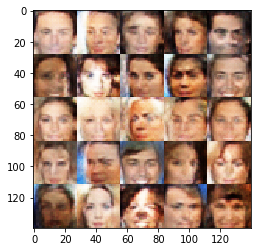

Epoch: 1/3 Discriminator Loss: 1.3158 Generator Loss: 0.8293
Epoch: 1/3 Discriminator Loss: 1.3014 Generator Loss: 0.7238
Epoch: 1/3 Discriminator Loss: 1.2791 Generator Loss: 0.8539
Epoch: 1/3 Discriminator Loss: 1.3134 Generator Loss: 0.7114
Epoch: 1/3 Discriminator Loss: 1.2684 Generator Loss: 0.7987
Epoch: 1/3 Discriminator Loss: 1.3525 Generator Loss: 0.6759
Epoch: 1/3 Discriminator Loss: 1.2125 Generator Loss: 0.8584
Epoch: 1/3 Discriminator Loss: 1.3311 Generator Loss: 0.9939
Epoch: 1/3 Discriminator Loss: 1.2645 Generator Loss: 0.9532
Epoch: 1/3 Discriminator Loss: 1.3022 Generator Loss: 0.7091


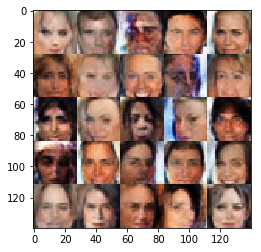

Epoch: 1/3 Discriminator Loss: 1.2501 Generator Loss: 0.9000
Epoch: 1/3 Discriminator Loss: 1.2985 Generator Loss: 0.8727
Epoch: 1/3 Discriminator Loss: 1.2446 Generator Loss: 0.8204
Epoch: 1/3 Discriminator Loss: 1.2219 Generator Loss: 0.8993
Epoch: 1/3 Discriminator Loss: 1.3623 Generator Loss: 0.8182
Epoch: 1/3 Discriminator Loss: 1.3212 Generator Loss: 0.7379
Epoch: 1/3 Discriminator Loss: 1.2222 Generator Loss: 0.7417
Epoch: 1/3 Discriminator Loss: 1.3109 Generator Loss: 0.6700
Epoch: 1/3 Discriminator Loss: 1.2482 Generator Loss: 0.9316
Epoch: 1/3 Discriminator Loss: 1.4494 Generator Loss: 0.5159


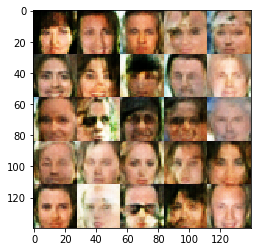

Epoch: 1/3 Discriminator Loss: 1.3671 Generator Loss: 0.8344
Epoch: 1/3 Discriminator Loss: 1.1817 Generator Loss: 0.9042
Epoch: 1/3 Discriminator Loss: 1.3684 Generator Loss: 0.5992
Epoch: 1/3 Discriminator Loss: 1.3115 Generator Loss: 0.9605
Epoch: 1/3 Discriminator Loss: 1.2840 Generator Loss: 0.7665
Epoch: 1/3 Discriminator Loss: 1.3197 Generator Loss: 0.7778
Epoch: 1/3 Discriminator Loss: 1.3531 Generator Loss: 0.5884
Epoch: 1/3 Discriminator Loss: 1.2665 Generator Loss: 0.8718
Epoch: 1/3 Discriminator Loss: 1.3039 Generator Loss: 0.7566
Epoch: 1/3 Discriminator Loss: 1.2707 Generator Loss: 0.7914


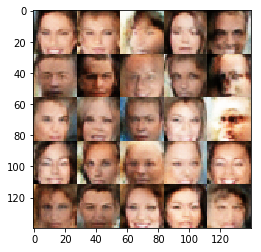

Epoch: 1/3 Discriminator Loss: 1.2894 Generator Loss: 0.8372
Epoch: 1/3 Discriminator Loss: 1.3034 Generator Loss: 0.8442
Epoch: 1/3 Discriminator Loss: 1.3480 Generator Loss: 0.6357
Epoch: 1/3 Discriminator Loss: 1.1757 Generator Loss: 0.9034
Epoch: 1/3 Discriminator Loss: 1.3699 Generator Loss: 0.8542
Epoch: 1/3 Discriminator Loss: 1.1671 Generator Loss: 0.9794
Epoch: 1/3 Discriminator Loss: 1.2614 Generator Loss: 0.8211
Epoch: 1/3 Discriminator Loss: 1.3286 Generator Loss: 0.6838
Epoch: 1/3 Discriminator Loss: 1.2641 Generator Loss: 0.7840
Epoch: 1/3 Discriminator Loss: 1.5597 Generator Loss: 0.6109


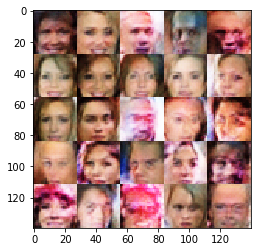

Epoch: 1/3 Discriminator Loss: 1.5211 Generator Loss: 1.2434
Epoch: 1/3 Discriminator Loss: 1.3155 Generator Loss: 0.9623
Epoch: 1/3 Discriminator Loss: 1.2519 Generator Loss: 0.8727
Epoch: 1/3 Discriminator Loss: 1.3178 Generator Loss: 0.9382
Epoch: 1/3 Discriminator Loss: 1.2599 Generator Loss: 1.0311
Epoch: 1/3 Discriminator Loss: 1.2672 Generator Loss: 0.9673
Epoch: 1/3 Discriminator Loss: 1.2919 Generator Loss: 0.7944
Epoch: 1/3 Discriminator Loss: 1.2699 Generator Loss: 0.8133
Epoch: 1/3 Discriminator Loss: 1.3985 Generator Loss: 0.5838
Epoch: 1/3 Discriminator Loss: 1.3590 Generator Loss: 0.7152


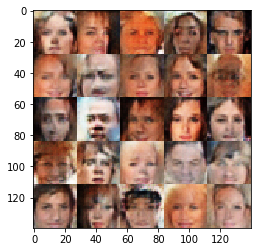

Epoch: 1/3 Discriminator Loss: 1.3117 Generator Loss: 0.8798
Epoch: 1/3 Discriminator Loss: 1.3993 Generator Loss: 0.6752
Epoch: 1/3 Discriminator Loss: 1.2712 Generator Loss: 0.8881
Epoch: 1/3 Discriminator Loss: 1.3187 Generator Loss: 0.6356
Epoch: 1/3 Discriminator Loss: 1.3434 Generator Loss: 0.6779
Epoch: 1/3 Discriminator Loss: 1.3416 Generator Loss: 0.7068
Epoch: 1/3 Discriminator Loss: 1.3836 Generator Loss: 0.6798
Epoch: 1/3 Discriminator Loss: 1.2978 Generator Loss: 0.6876
Epoch: 1/3 Discriminator Loss: 1.3338 Generator Loss: 0.6283
Epoch: 1/3 Discriminator Loss: 1.2703 Generator Loss: 0.8470


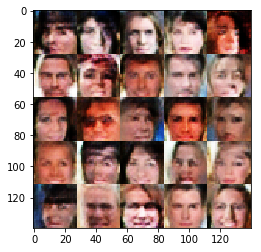

Epoch: 1/3 Discriminator Loss: 1.3105 Generator Loss: 0.7224
Epoch: 1/3 Discriminator Loss: 1.3094 Generator Loss: 0.6744
Epoch: 1/3 Discriminator Loss: 1.2514 Generator Loss: 1.0458
Epoch: 1/3 Discriminator Loss: 1.3242 Generator Loss: 0.7966
Epoch: 1/3 Discriminator Loss: 1.3906 Generator Loss: 0.7309
Epoch: 1/3 Discriminator Loss: 1.2311 Generator Loss: 0.8327
Epoch: 1/3 Discriminator Loss: 1.2356 Generator Loss: 0.7779
Epoch: 1/3 Discriminator Loss: 1.4341 Generator Loss: 0.6386
Epoch: 1/3 Discriminator Loss: 1.2645 Generator Loss: 0.8207
Epoch: 1/3 Discriminator Loss: 1.4495 Generator Loss: 0.7496


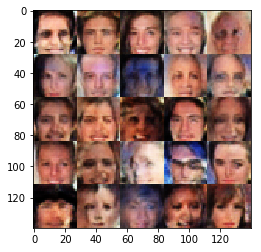

Epoch: 1/3 Discriminator Loss: 1.3339 Generator Loss: 0.8859
Epoch: 1/3 Discriminator Loss: 1.2556 Generator Loss: 0.8411
Epoch: 1/3 Discriminator Loss: 1.4535 Generator Loss: 0.6594
Epoch: 1/3 Discriminator Loss: 1.3590 Generator Loss: 0.6333
Epoch: 1/3 Discriminator Loss: 1.2872 Generator Loss: 0.9537
Epoch: 1/3 Discriminator Loss: 1.1647 Generator Loss: 1.0250
Epoch: 1/3 Discriminator Loss: 1.3542 Generator Loss: 0.7567
Epoch: 1/3 Discriminator Loss: 1.2787 Generator Loss: 0.7412
Epoch: 1/3 Discriminator Loss: 1.2699 Generator Loss: 0.7663
Epoch: 1/3 Discriminator Loss: 1.3269 Generator Loss: 0.6406


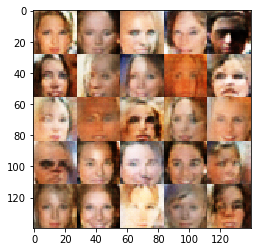

Epoch: 1/3 Discriminator Loss: 1.3713 Generator Loss: 0.9297
Epoch: 1/3 Discriminator Loss: 1.1125 Generator Loss: 1.0426
Epoch: 1/3 Discriminator Loss: 1.3161 Generator Loss: 0.8503
Epoch: 1/3 Discriminator Loss: 1.2694 Generator Loss: 0.7749
Epoch: 1/3 Discriminator Loss: 1.3175 Generator Loss: 0.7901
Epoch: 1/3 Discriminator Loss: 1.3589 Generator Loss: 0.6717
Epoch: 1/3 Discriminator Loss: 1.3183 Generator Loss: 0.7468
Epoch: 1/3 Discriminator Loss: 1.2233 Generator Loss: 0.9663
Epoch: 1/3 Discriminator Loss: 1.3346 Generator Loss: 0.9040
Epoch: 1/3 Discriminator Loss: 1.2738 Generator Loss: 0.7637


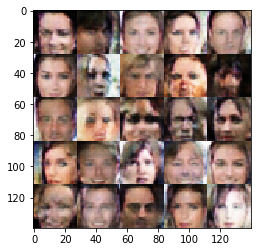

Epoch: 1/3 Discriminator Loss: 1.3356 Generator Loss: 0.7563
Epoch: 1/3 Discriminator Loss: 1.4323 Generator Loss: 0.6637
Epoch: 1/3 Discriminator Loss: 1.3059 Generator Loss: 0.6626
Epoch: 1/3 Discriminator Loss: 1.2285 Generator Loss: 0.8176
Epoch: 1/3 Discriminator Loss: 1.2575 Generator Loss: 0.8624
Epoch: 1/3 Discriminator Loss: 1.3242 Generator Loss: 0.7285
Epoch: 1/3 Discriminator Loss: 1.2734 Generator Loss: 0.7330
Epoch: 1/3 Discriminator Loss: 1.2635 Generator Loss: 0.8018
Epoch: 1/3 Discriminator Loss: 1.2389 Generator Loss: 0.7163
Epoch: 1/3 Discriminator Loss: 1.3398 Generator Loss: 0.6333


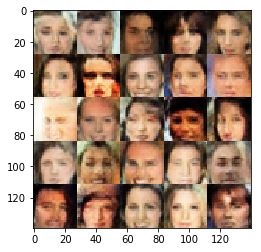

Epoch: 1/3 Discriminator Loss: 1.2415 Generator Loss: 0.9477
Epoch: 1/3 Discriminator Loss: 1.2108 Generator Loss: 0.8819
Epoch: 1/3 Discriminator Loss: 1.4305 Generator Loss: 0.6385
Epoch: 1/3 Discriminator Loss: 1.3341 Generator Loss: 0.8395
Epoch: 1/3 Discriminator Loss: 1.2919 Generator Loss: 0.7466
Epoch: 1/3 Discriminator Loss: 1.2436 Generator Loss: 1.0901
Epoch: 1/3 Discriminator Loss: 1.2591 Generator Loss: 0.7243
Epoch: 1/3 Discriminator Loss: 1.3266 Generator Loss: 0.7985
Epoch: 1/3 Discriminator Loss: 1.2916 Generator Loss: 0.9258
Epoch: 1/3 Discriminator Loss: 1.3476 Generator Loss: 0.6126


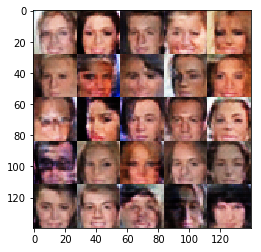

Epoch: 1/3 Discriminator Loss: 1.3851 Generator Loss: 1.1895
Epoch: 1/3 Discriminator Loss: 1.2841 Generator Loss: 0.8050
Epoch: 1/3 Discriminator Loss: 1.2724 Generator Loss: 0.9719
Epoch: 1/3 Discriminator Loss: 1.3161 Generator Loss: 1.2331
Epoch: 1/3 Discriminator Loss: 1.3236 Generator Loss: 0.8815
Epoch: 1/3 Discriminator Loss: 1.3052 Generator Loss: 0.8150
Epoch: 1/3 Discriminator Loss: 1.2699 Generator Loss: 0.8689
Epoch: 1/3 Discriminator Loss: 1.2001 Generator Loss: 0.9594
Epoch: 1/3 Discriminator Loss: 1.2738 Generator Loss: 0.7617
Epoch: 1/3 Discriminator Loss: 1.3898 Generator Loss: 0.6413


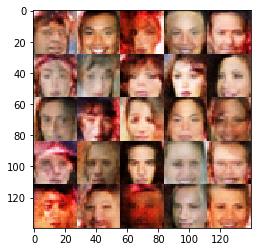

Epoch: 1/3 Discriminator Loss: 1.5633 Generator Loss: 0.4829
Epoch: 1/3 Discriminator Loss: 1.3172 Generator Loss: 0.9375
Epoch: 1/3 Discriminator Loss: 1.2205 Generator Loss: 0.8617
Epoch: 1/3 Discriminator Loss: 1.3299 Generator Loss: 0.7434
Epoch: 1/3 Discriminator Loss: 1.3931 Generator Loss: 0.6493
Epoch: 1/3 Discriminator Loss: 1.3133 Generator Loss: 0.7210
Epoch: 1/3 Discriminator Loss: 1.3524 Generator Loss: 0.6888
Epoch: 1/3 Discriminator Loss: 1.3044 Generator Loss: 0.6724
Epoch: 1/3 Discriminator Loss: 1.3376 Generator Loss: 0.6549
Epoch: 1/3 Discriminator Loss: 1.2132 Generator Loss: 0.9538


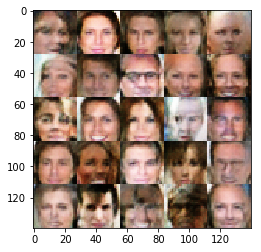

Epoch: 1/3 Discriminator Loss: 1.2305 Generator Loss: 0.9444
Epoch: 1/3 Discriminator Loss: 1.2704 Generator Loss: 0.7895
Epoch: 1/3 Discriminator Loss: 1.2858 Generator Loss: 0.8724
Epoch: 1/3 Discriminator Loss: 1.2714 Generator Loss: 0.6758
Epoch: 1/3 Discriminator Loss: 1.2620 Generator Loss: 0.8738
Epoch: 1/3 Discriminator Loss: 1.3156 Generator Loss: 0.6842
Epoch: 1/3 Discriminator Loss: 1.3402 Generator Loss: 0.8534
Epoch: 1/3 Discriminator Loss: 1.3948 Generator Loss: 0.5652
Epoch: 1/3 Discriminator Loss: 1.3298 Generator Loss: 0.6929
Epoch: 1/3 Discriminator Loss: 1.3970 Generator Loss: 0.6208


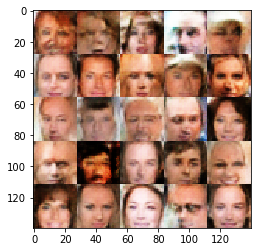

Epoch: 1/3 Discriminator Loss: 1.3055 Generator Loss: 0.6791
Epoch: 1/3 Discriminator Loss: 1.2942 Generator Loss: 0.7764
Epoch: 1/3 Discriminator Loss: 1.4039 Generator Loss: 0.6529
Epoch: 1/3 Discriminator Loss: 1.2181 Generator Loss: 0.8165
Epoch: 1/3 Discriminator Loss: 1.4296 Generator Loss: 0.6762
Epoch: 1/3 Discriminator Loss: 1.5243 Generator Loss: 0.6556
Epoch: 1/3 Discriminator Loss: 1.3455 Generator Loss: 0.8553
Epoch: 1/3 Discriminator Loss: 1.2932 Generator Loss: 0.9762
Epoch: 1/3 Discriminator Loss: 1.3137 Generator Loss: 0.7665
Epoch: 1/3 Discriminator Loss: 1.2521 Generator Loss: 0.8588


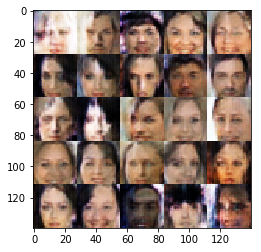

Epoch: 1/3 Discriminator Loss: 1.2909 Generator Loss: 0.8826
Epoch: 1/3 Discriminator Loss: 1.2805 Generator Loss: 0.8487
Epoch: 1/3 Discriminator Loss: 1.0887 Generator Loss: 1.0346
Epoch: 1/3 Discriminator Loss: 1.2702 Generator Loss: 0.9648
Epoch: 1/3 Discriminator Loss: 1.3342 Generator Loss: 0.7877
Epoch: 1/3 Discriminator Loss: 1.2357 Generator Loss: 0.9798
Epoch: 1/3 Discriminator Loss: 1.3011 Generator Loss: 0.8064
Epoch: 1/3 Discriminator Loss: 1.3322 Generator Loss: 0.5743
Epoch: 1/3 Discriminator Loss: 1.3813 Generator Loss: 0.8867
Epoch: 1/3 Discriminator Loss: 1.2323 Generator Loss: 0.9382


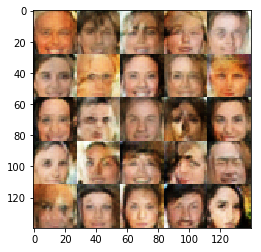

Epoch: 1/3 Discriminator Loss: 1.2300 Generator Loss: 0.9417
Epoch: 1/3 Discriminator Loss: 1.2835 Generator Loss: 0.6735
Epoch: 1/3 Discriminator Loss: 1.4989 Generator Loss: 0.5320
Epoch: 1/3 Discriminator Loss: 1.2981 Generator Loss: 0.7342
Epoch: 1/3 Discriminator Loss: 1.1516 Generator Loss: 0.9629
Epoch: 1/3 Discriminator Loss: 1.2210 Generator Loss: 0.8816
Epoch: 1/3 Discriminator Loss: 1.3429 Generator Loss: 0.7931
Epoch: 1/3 Discriminator Loss: 1.2912 Generator Loss: 0.8260
Epoch: 1/3 Discriminator Loss: 1.2260 Generator Loss: 0.7906
Epoch: 1/3 Discriminator Loss: 1.2272 Generator Loss: 0.8825


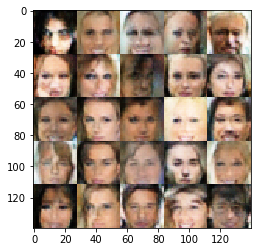

Epoch: 1/3 Discriminator Loss: 1.4580 Generator Loss: 0.8337
Epoch: 1/3 Discriminator Loss: 1.3504 Generator Loss: 0.7937
Epoch: 1/3 Discriminator Loss: 1.2868 Generator Loss: 0.8559
Epoch: 1/3 Discriminator Loss: 1.2521 Generator Loss: 0.7703
Epoch: 1/3 Discriminator Loss: 1.1905 Generator Loss: 0.8079
Epoch: 1/3 Discriminator Loss: 1.2667 Generator Loss: 0.8223
Epoch: 1/3 Discriminator Loss: 1.3177 Generator Loss: 0.6888
Epoch: 1/3 Discriminator Loss: 1.1695 Generator Loss: 0.9087
Epoch: 1/3 Discriminator Loss: 1.3548 Generator Loss: 0.7319
Epoch: 1/3 Discriminator Loss: 1.3199 Generator Loss: 0.7537


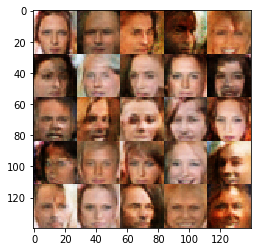

Epoch: 1/3 Discriminator Loss: 1.3035 Generator Loss: 0.8372
Epoch: 1/3 Discriminator Loss: 1.3145 Generator Loss: 0.7732
Epoch: 1/3 Discriminator Loss: 1.1870 Generator Loss: 0.9410
Epoch: 1/3 Discriminator Loss: 1.2101 Generator Loss: 0.9080
Epoch: 1/3 Discriminator Loss: 1.3174 Generator Loss: 0.8693
Epoch: 1/3 Discriminator Loss: 1.3634 Generator Loss: 1.0193
Epoch: 1/3 Discriminator Loss: 1.1732 Generator Loss: 0.9847
Epoch: 1/3 Discriminator Loss: 1.3385 Generator Loss: 0.6481
Epoch: 1/3 Discriminator Loss: 1.2252 Generator Loss: 0.8548
Epoch: 1/3 Discriminator Loss: 1.1866 Generator Loss: 0.8129


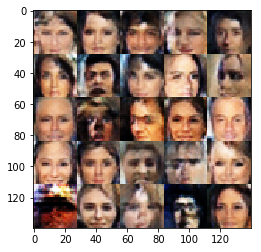

Epoch: 1/3 Discriminator Loss: 1.2699 Generator Loss: 0.7562
Epoch: 1/3 Discriminator Loss: 1.2927 Generator Loss: 0.7701
Epoch: 1/3 Discriminator Loss: 1.2588 Generator Loss: 0.9749
Epoch: 1/3 Discriminator Loss: 1.2742 Generator Loss: 0.8562
Epoch: 1/3 Discriminator Loss: 1.2817 Generator Loss: 0.9105
Epoch: 1/3 Discriminator Loss: 1.2164 Generator Loss: 0.8998
Epoch: 1/3 Discriminator Loss: 1.2331 Generator Loss: 0.7641
Epoch: 1/3 Discriminator Loss: 1.2807 Generator Loss: 0.8628
Epoch: 1/3 Discriminator Loss: 1.4486 Generator Loss: 0.6875
Epoch: 1/3 Discriminator Loss: 1.2163 Generator Loss: 0.8207


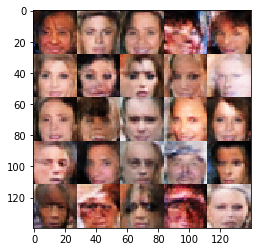

Epoch: 1/3 Discriminator Loss: 1.3887 Generator Loss: 0.6811
Epoch: 1/3 Discriminator Loss: 1.1564 Generator Loss: 0.9009
Epoch: 1/3 Discriminator Loss: 1.3237 Generator Loss: 0.6480
Epoch: 1/3 Discriminator Loss: 1.2975 Generator Loss: 0.9404
Epoch: 1/3 Discriminator Loss: 1.3717 Generator Loss: 0.7264
Epoch: 1/3 Discriminator Loss: 1.3681 Generator Loss: 0.7277
Epoch: 1/3 Discriminator Loss: 1.2665 Generator Loss: 0.7613
Epoch: 1/3 Discriminator Loss: 1.3165 Generator Loss: 0.8160
Epoch: 1/3 Discriminator Loss: 1.1814 Generator Loss: 0.9318
Epoch: 1/3 Discriminator Loss: 1.2628 Generator Loss: 0.8378


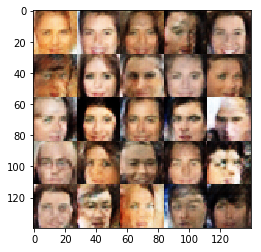

Epoch: 1/3 Discriminator Loss: 1.1874 Generator Loss: 0.8397
Epoch: 1/3 Discriminator Loss: 1.2883 Generator Loss: 0.9710
Epoch: 1/3 Discriminator Loss: 1.2297 Generator Loss: 0.9043
Epoch: 1/3 Discriminator Loss: 1.4023 Generator Loss: 0.8132
Epoch: 1/3 Discriminator Loss: 1.3096 Generator Loss: 0.7923
Epoch: 1/3 Discriminator Loss: 1.2225 Generator Loss: 1.0379
Epoch: 1/3 Discriminator Loss: 1.2766 Generator Loss: 0.6150
Epoch: 1/3 Discriminator Loss: 1.2609 Generator Loss: 0.8898
Epoch: 1/3 Discriminator Loss: 1.3615 Generator Loss: 0.7495
Epoch: 1/3 Discriminator Loss: 1.1177 Generator Loss: 0.9681


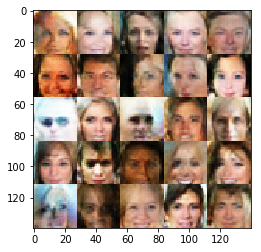

Epoch: 1/3 Discriminator Loss: 1.2468 Generator Loss: 0.8524
Epoch: 1/3 Discriminator Loss: 1.3330 Generator Loss: 0.6618
Epoch: 1/3 Discriminator Loss: 1.1824 Generator Loss: 0.8690
Epoch: 1/3 Discriminator Loss: 1.2913 Generator Loss: 0.8062
Epoch: 1/3 Discriminator Loss: 1.3670 Generator Loss: 0.6220
Epoch: 1/3 Discriminator Loss: 1.3767 Generator Loss: 0.7495
Epoch: 2/3 Discriminator Loss: 1.2578 Generator Loss: 0.8585
Epoch: 2/3 Discriminator Loss: 1.1694 Generator Loss: 1.0447
Epoch: 2/3 Discriminator Loss: 1.1992 Generator Loss: 1.0536
Epoch: 2/3 Discriminator Loss: 1.3925 Generator Loss: 0.8941


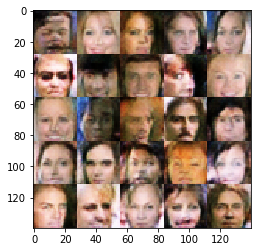

Epoch: 2/3 Discriminator Loss: 1.3916 Generator Loss: 0.6099
Epoch: 2/3 Discriminator Loss: 1.3104 Generator Loss: 0.6660
Epoch: 2/3 Discriminator Loss: 1.2228 Generator Loss: 1.0047
Epoch: 2/3 Discriminator Loss: 1.2326 Generator Loss: 0.9110
Epoch: 2/3 Discriminator Loss: 1.3846 Generator Loss: 0.6107
Epoch: 2/3 Discriminator Loss: 1.3733 Generator Loss: 0.8472
Epoch: 2/3 Discriminator Loss: 1.2641 Generator Loss: 0.7978
Epoch: 2/3 Discriminator Loss: 1.3065 Generator Loss: 0.8119
Epoch: 2/3 Discriminator Loss: 1.3369 Generator Loss: 1.0463
Epoch: 2/3 Discriminator Loss: 1.2793 Generator Loss: 0.7520


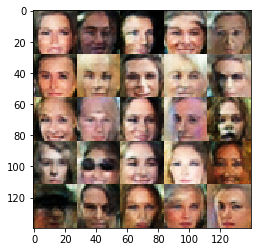

Epoch: 2/3 Discriminator Loss: 1.1994 Generator Loss: 0.8798
Epoch: 2/3 Discriminator Loss: 1.2322 Generator Loss: 0.8394
Epoch: 2/3 Discriminator Loss: 1.3179 Generator Loss: 0.6536
Epoch: 2/3 Discriminator Loss: 1.3581 Generator Loss: 0.6402
Epoch: 2/3 Discriminator Loss: 1.2414 Generator Loss: 0.8218
Epoch: 2/3 Discriminator Loss: 1.2404 Generator Loss: 0.8997
Epoch: 2/3 Discriminator Loss: 1.3330 Generator Loss: 0.7350
Epoch: 2/3 Discriminator Loss: 1.2800 Generator Loss: 0.7166
Epoch: 2/3 Discriminator Loss: 1.2105 Generator Loss: 0.9875
Epoch: 2/3 Discriminator Loss: 1.2028 Generator Loss: 0.7869


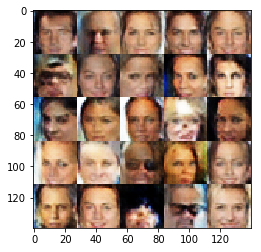

Epoch: 2/3 Discriminator Loss: 1.2852 Generator Loss: 0.9458
Epoch: 2/3 Discriminator Loss: 1.2969 Generator Loss: 0.7550
Epoch: 2/3 Discriminator Loss: 1.2871 Generator Loss: 0.8812
Epoch: 2/3 Discriminator Loss: 1.3654 Generator Loss: 0.6647
Epoch: 2/3 Discriminator Loss: 1.2830 Generator Loss: 0.8699
Epoch: 2/3 Discriminator Loss: 1.4829 Generator Loss: 0.5231
Epoch: 2/3 Discriminator Loss: 1.2236 Generator Loss: 0.9607
Epoch: 2/3 Discriminator Loss: 1.3119 Generator Loss: 0.7372
Epoch: 2/3 Discriminator Loss: 1.2600 Generator Loss: 0.8723
Epoch: 2/3 Discriminator Loss: 1.3341 Generator Loss: 0.6846


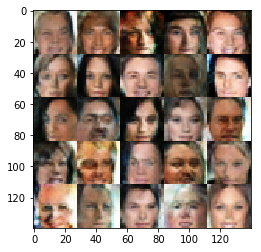

Epoch: 2/3 Discriminator Loss: 1.2560 Generator Loss: 0.9722
Epoch: 2/3 Discriminator Loss: 1.2906 Generator Loss: 1.0044
Epoch: 2/3 Discriminator Loss: 1.2948 Generator Loss: 0.9179
Epoch: 2/3 Discriminator Loss: 1.3831 Generator Loss: 0.8038
Epoch: 2/3 Discriminator Loss: 1.2456 Generator Loss: 0.8283
Epoch: 2/3 Discriminator Loss: 1.1660 Generator Loss: 0.9949
Epoch: 2/3 Discriminator Loss: 1.2584 Generator Loss: 0.7599
Epoch: 2/3 Discriminator Loss: 1.3853 Generator Loss: 0.6352
Epoch: 2/3 Discriminator Loss: 1.3142 Generator Loss: 0.6914
Epoch: 2/3 Discriminator Loss: 1.2822 Generator Loss: 0.9674


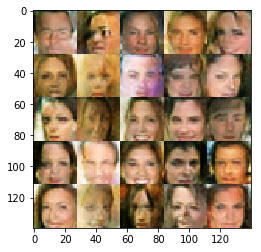

Epoch: 2/3 Discriminator Loss: 1.2954 Generator Loss: 0.9005
Epoch: 2/3 Discriminator Loss: 1.2786 Generator Loss: 0.7055
Epoch: 2/3 Discriminator Loss: 1.3411 Generator Loss: 0.7978
Epoch: 2/3 Discriminator Loss: 1.1843 Generator Loss: 0.9076
Epoch: 2/3 Discriminator Loss: 1.2576 Generator Loss: 0.8621
Epoch: 2/3 Discriminator Loss: 1.3543 Generator Loss: 0.7702
Epoch: 2/3 Discriminator Loss: 1.2925 Generator Loss: 0.7407
Epoch: 2/3 Discriminator Loss: 1.2451 Generator Loss: 0.8388
Epoch: 2/3 Discriminator Loss: 1.3376 Generator Loss: 0.8291
Epoch: 2/3 Discriminator Loss: 1.2236 Generator Loss: 0.6892


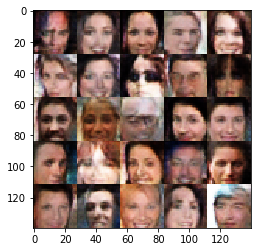

Epoch: 2/3 Discriminator Loss: 1.2859 Generator Loss: 0.9374
Epoch: 2/3 Discriminator Loss: 1.4120 Generator Loss: 0.8639
Epoch: 2/3 Discriminator Loss: 1.2393 Generator Loss: 0.7707
Epoch: 2/3 Discriminator Loss: 1.3294 Generator Loss: 0.6913
Epoch: 2/3 Discriminator Loss: 1.3373 Generator Loss: 0.7095
Epoch: 2/3 Discriminator Loss: 1.3274 Generator Loss: 0.6851
Epoch: 2/3 Discriminator Loss: 1.3261 Generator Loss: 0.6793
Epoch: 2/3 Discriminator Loss: 1.3161 Generator Loss: 0.8210
Epoch: 2/3 Discriminator Loss: 1.3435 Generator Loss: 0.6946
Epoch: 2/3 Discriminator Loss: 1.4025 Generator Loss: 0.7887


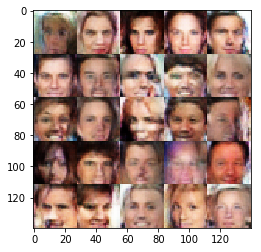

Epoch: 2/3 Discriminator Loss: 1.3386 Generator Loss: 0.7851
Epoch: 2/3 Discriminator Loss: 1.3089 Generator Loss: 0.6949
Epoch: 2/3 Discriminator Loss: 1.2511 Generator Loss: 1.0320
Epoch: 2/3 Discriminator Loss: 1.2558 Generator Loss: 0.9808
Epoch: 2/3 Discriminator Loss: 1.4071 Generator Loss: 0.6352
Epoch: 2/3 Discriminator Loss: 1.3772 Generator Loss: 0.8071
Epoch: 2/3 Discriminator Loss: 1.3547 Generator Loss: 0.6922
Epoch: 2/3 Discriminator Loss: 1.3683 Generator Loss: 0.6834
Epoch: 2/3 Discriminator Loss: 1.4376 Generator Loss: 0.7371
Epoch: 2/3 Discriminator Loss: 1.3712 Generator Loss: 0.7397


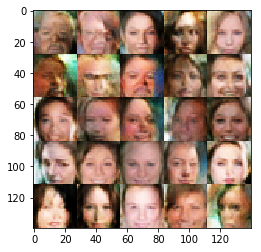

Epoch: 2/3 Discriminator Loss: 1.3030 Generator Loss: 0.7257
Epoch: 2/3 Discriminator Loss: 1.3555 Generator Loss: 0.7905
Epoch: 2/3 Discriminator Loss: 1.4216 Generator Loss: 0.6985
Epoch: 2/3 Discriminator Loss: 1.2336 Generator Loss: 0.8026
Epoch: 2/3 Discriminator Loss: 1.3441 Generator Loss: 0.6676
Epoch: 2/3 Discriminator Loss: 1.2733 Generator Loss: 0.7654
Epoch: 2/3 Discriminator Loss: 1.2821 Generator Loss: 1.0176
Epoch: 2/3 Discriminator Loss: 1.4260 Generator Loss: 0.5694
Epoch: 2/3 Discriminator Loss: 1.5585 Generator Loss: 1.3612
Epoch: 2/3 Discriminator Loss: 1.1987 Generator Loss: 0.8623


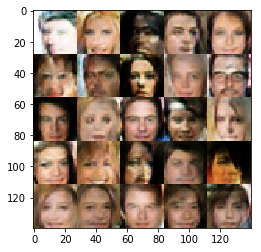

Epoch: 2/3 Discriminator Loss: 1.4326 Generator Loss: 0.8021
Epoch: 2/3 Discriminator Loss: 1.2683 Generator Loss: 0.8138
Epoch: 2/3 Discriminator Loss: 1.2992 Generator Loss: 0.8237
Epoch: 2/3 Discriminator Loss: 1.2781 Generator Loss: 0.8241
Epoch: 2/3 Discriminator Loss: 1.2594 Generator Loss: 0.8159
Epoch: 2/3 Discriminator Loss: 1.2823 Generator Loss: 0.7752
Epoch: 2/3 Discriminator Loss: 1.3135 Generator Loss: 0.7623
Epoch: 2/3 Discriminator Loss: 1.3800 Generator Loss: 0.7371
Epoch: 2/3 Discriminator Loss: 1.2526 Generator Loss: 0.7853
Epoch: 2/3 Discriminator Loss: 1.2546 Generator Loss: 0.9556


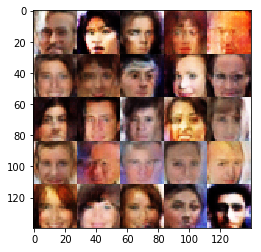

Epoch: 2/3 Discriminator Loss: 1.2391 Generator Loss: 0.8358
Epoch: 2/3 Discriminator Loss: 1.4952 Generator Loss: 0.5346
Epoch: 2/3 Discriminator Loss: 1.3561 Generator Loss: 0.7192
Epoch: 2/3 Discriminator Loss: 1.2169 Generator Loss: 0.8709
Epoch: 2/3 Discriminator Loss: 1.2860 Generator Loss: 0.8382
Epoch: 2/3 Discriminator Loss: 1.3682 Generator Loss: 0.8516
Epoch: 2/3 Discriminator Loss: 1.1955 Generator Loss: 0.8661
Epoch: 2/3 Discriminator Loss: 1.3389 Generator Loss: 0.6631
Epoch: 2/3 Discriminator Loss: 1.3091 Generator Loss: 0.8182
Epoch: 2/3 Discriminator Loss: 1.2506 Generator Loss: 0.9838


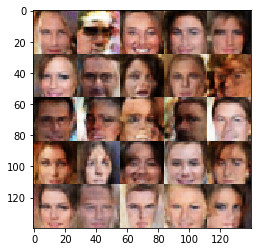

Epoch: 2/3 Discriminator Loss: 1.3413 Generator Loss: 0.6934
Epoch: 2/3 Discriminator Loss: 1.2224 Generator Loss: 0.9110
Epoch: 2/3 Discriminator Loss: 1.3609 Generator Loss: 0.9010
Epoch: 2/3 Discriminator Loss: 1.2417 Generator Loss: 0.7985
Epoch: 2/3 Discriminator Loss: 1.2379 Generator Loss: 0.8157
Epoch: 2/3 Discriminator Loss: 1.3683 Generator Loss: 0.8721
Epoch: 2/3 Discriminator Loss: 1.2879 Generator Loss: 0.7463
Epoch: 2/3 Discriminator Loss: 1.3317 Generator Loss: 0.7732
Epoch: 2/3 Discriminator Loss: 1.3058 Generator Loss: 0.7666
Epoch: 2/3 Discriminator Loss: 1.3043 Generator Loss: 0.7528


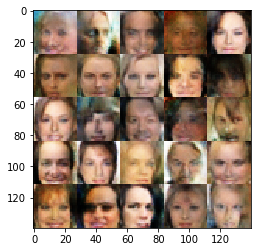

Epoch: 2/3 Discriminator Loss: 1.1721 Generator Loss: 0.9763
Epoch: 2/3 Discriminator Loss: 1.3101 Generator Loss: 0.8967
Epoch: 2/3 Discriminator Loss: 1.2954 Generator Loss: 0.7118
Epoch: 2/3 Discriminator Loss: 1.2909 Generator Loss: 0.7167
Epoch: 2/3 Discriminator Loss: 1.3294 Generator Loss: 0.7735
Epoch: 2/3 Discriminator Loss: 1.1986 Generator Loss: 1.0224
Epoch: 2/3 Discriminator Loss: 1.2324 Generator Loss: 0.8381
Epoch: 2/3 Discriminator Loss: 1.2353 Generator Loss: 0.7638
Epoch: 2/3 Discriminator Loss: 1.3781 Generator Loss: 0.7784
Epoch: 2/3 Discriminator Loss: 1.2713 Generator Loss: 0.7415


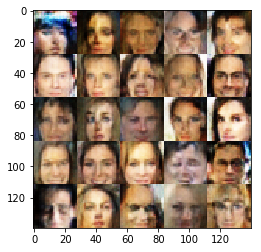

Epoch: 2/3 Discriminator Loss: 1.2636 Generator Loss: 0.7639
Epoch: 2/3 Discriminator Loss: 1.2682 Generator Loss: 1.2390
Epoch: 2/3 Discriminator Loss: 1.4121 Generator Loss: 0.6102
Epoch: 2/3 Discriminator Loss: 1.3239 Generator Loss: 0.7434
Epoch: 2/3 Discriminator Loss: 1.2756 Generator Loss: 0.8706
Epoch: 2/3 Discriminator Loss: 1.3406 Generator Loss: 0.6368
Epoch: 2/3 Discriminator Loss: 1.2525 Generator Loss: 0.8436
Epoch: 2/3 Discriminator Loss: 1.3017 Generator Loss: 0.8134
Epoch: 2/3 Discriminator Loss: 1.3987 Generator Loss: 0.6707
Epoch: 2/3 Discriminator Loss: 1.3134 Generator Loss: 0.7259


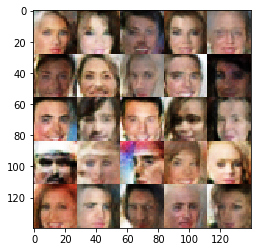

Epoch: 2/3 Discriminator Loss: 1.3818 Generator Loss: 0.6854
Epoch: 2/3 Discriminator Loss: 1.2597 Generator Loss: 0.9595
Epoch: 2/3 Discriminator Loss: 1.2248 Generator Loss: 0.7508
Epoch: 2/3 Discriminator Loss: 1.2464 Generator Loss: 0.8583
Epoch: 2/3 Discriminator Loss: 1.3496 Generator Loss: 0.6965
Epoch: 2/3 Discriminator Loss: 1.2590 Generator Loss: 0.7612
Epoch: 2/3 Discriminator Loss: 1.3340 Generator Loss: 0.9160
Epoch: 2/3 Discriminator Loss: 1.2935 Generator Loss: 0.7434
Epoch: 2/3 Discriminator Loss: 1.4307 Generator Loss: 0.6352
Epoch: 2/3 Discriminator Loss: 1.1867 Generator Loss: 0.9042


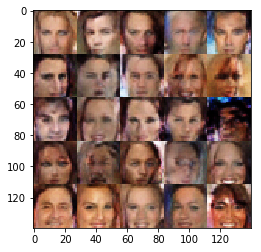

Epoch: 2/3 Discriminator Loss: 1.5592 Generator Loss: 0.5540
Epoch: 2/3 Discriminator Loss: 1.1390 Generator Loss: 0.7787
Epoch: 2/3 Discriminator Loss: 1.1627 Generator Loss: 0.9775
Epoch: 2/3 Discriminator Loss: 1.3747 Generator Loss: 0.8446
Epoch: 2/3 Discriminator Loss: 1.3726 Generator Loss: 0.6605
Epoch: 2/3 Discriminator Loss: 1.3680 Generator Loss: 0.6478
Epoch: 2/3 Discriminator Loss: 1.3458 Generator Loss: 0.6757
Epoch: 2/3 Discriminator Loss: 1.2557 Generator Loss: 0.9230
Epoch: 2/3 Discriminator Loss: 1.2417 Generator Loss: 0.9382
Epoch: 2/3 Discriminator Loss: 1.3305 Generator Loss: 0.7231


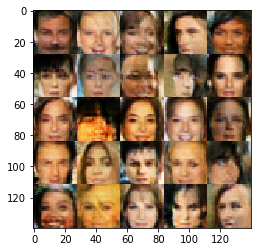

Epoch: 2/3 Discriminator Loss: 1.3852 Generator Loss: 0.6724
Epoch: 2/3 Discriminator Loss: 1.2885 Generator Loss: 0.8115
Epoch: 2/3 Discriminator Loss: 1.2791 Generator Loss: 0.7847
Epoch: 2/3 Discriminator Loss: 1.3043 Generator Loss: 0.8742
Epoch: 2/3 Discriminator Loss: 1.3698 Generator Loss: 0.6656
Epoch: 2/3 Discriminator Loss: 1.2844 Generator Loss: 0.8157
Epoch: 2/3 Discriminator Loss: 1.2627 Generator Loss: 0.9321
Epoch: 2/3 Discriminator Loss: 1.2625 Generator Loss: 1.0037
Epoch: 2/3 Discriminator Loss: 1.1265 Generator Loss: 1.0938
Epoch: 2/3 Discriminator Loss: 1.3777 Generator Loss: 0.7804


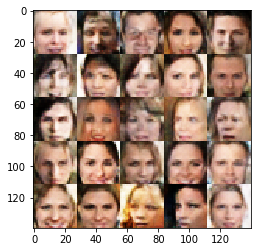

Epoch: 2/3 Discriminator Loss: 1.2328 Generator Loss: 0.8562
Epoch: 2/3 Discriminator Loss: 1.4328 Generator Loss: 0.7007
Epoch: 2/3 Discriminator Loss: 1.3539 Generator Loss: 0.6928
Epoch: 2/3 Discriminator Loss: 1.2870 Generator Loss: 0.7700
Epoch: 2/3 Discriminator Loss: 1.3563 Generator Loss: 0.7589
Epoch: 2/3 Discriminator Loss: 1.1687 Generator Loss: 0.9804
Epoch: 2/3 Discriminator Loss: 1.2492 Generator Loss: 0.8475
Epoch: 2/3 Discriminator Loss: 1.1934 Generator Loss: 0.9128
Epoch: 2/3 Discriminator Loss: 1.3330 Generator Loss: 0.7120
Epoch: 2/3 Discriminator Loss: 1.3123 Generator Loss: 0.7793


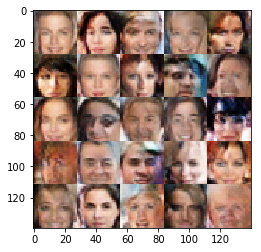

Epoch: 2/3 Discriminator Loss: 1.1665 Generator Loss: 0.9063
Epoch: 2/3 Discriminator Loss: 1.2780 Generator Loss: 0.8330
Epoch: 2/3 Discriminator Loss: 1.2950 Generator Loss: 0.7744
Epoch: 2/3 Discriminator Loss: 1.2379 Generator Loss: 0.9062
Epoch: 2/3 Discriminator Loss: 1.2722 Generator Loss: 0.8787
Epoch: 2/3 Discriminator Loss: 1.2842 Generator Loss: 0.7154
Epoch: 2/3 Discriminator Loss: 1.2655 Generator Loss: 0.7566
Epoch: 2/3 Discriminator Loss: 1.1804 Generator Loss: 0.9736
Epoch: 2/3 Discriminator Loss: 1.2919 Generator Loss: 0.8084
Epoch: 2/3 Discriminator Loss: 1.3740 Generator Loss: 0.7159


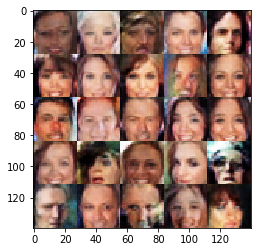

Epoch: 2/3 Discriminator Loss: 1.2791 Generator Loss: 1.0484
Epoch: 2/3 Discriminator Loss: 1.3821 Generator Loss: 0.8768
Epoch: 2/3 Discriminator Loss: 1.3223 Generator Loss: 0.7042
Epoch: 2/3 Discriminator Loss: 1.3413 Generator Loss: 0.8088
Epoch: 2/3 Discriminator Loss: 1.4219 Generator Loss: 0.6260
Epoch: 2/3 Discriminator Loss: 1.3618 Generator Loss: 0.6773
Epoch: 2/3 Discriminator Loss: 1.2363 Generator Loss: 0.9208
Epoch: 2/3 Discriminator Loss: 1.3205 Generator Loss: 0.7320
Epoch: 2/3 Discriminator Loss: 1.3168 Generator Loss: 0.9192
Epoch: 2/3 Discriminator Loss: 1.2418 Generator Loss: 0.7448


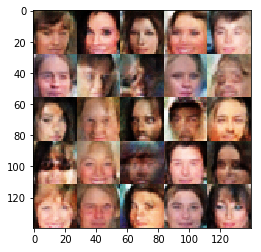

Epoch: 2/3 Discriminator Loss: 1.3354 Generator Loss: 0.8302
Epoch: 2/3 Discriminator Loss: 1.3754 Generator Loss: 0.7456
Epoch: 2/3 Discriminator Loss: 1.3961 Generator Loss: 0.6595
Epoch: 2/3 Discriminator Loss: 1.4117 Generator Loss: 0.6908
Epoch: 2/3 Discriminator Loss: 1.2908 Generator Loss: 0.6363
Epoch: 2/3 Discriminator Loss: 1.2091 Generator Loss: 0.8486
Epoch: 2/3 Discriminator Loss: 1.3566 Generator Loss: 0.7780
Epoch: 2/3 Discriminator Loss: 1.2334 Generator Loss: 0.9486
Epoch: 2/3 Discriminator Loss: 1.2786 Generator Loss: 0.7926
Epoch: 2/3 Discriminator Loss: 1.3558 Generator Loss: 0.6520


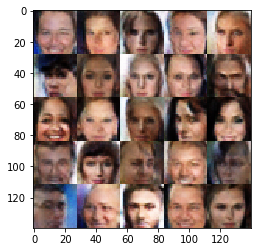

Epoch: 2/3 Discriminator Loss: 1.3474 Generator Loss: 0.7090
Epoch: 2/3 Discriminator Loss: 1.4041 Generator Loss: 0.7761
Epoch: 2/3 Discriminator Loss: 1.3596 Generator Loss: 0.6844
Epoch: 2/3 Discriminator Loss: 1.4022 Generator Loss: 0.6088
Epoch: 2/3 Discriminator Loss: 1.2369 Generator Loss: 0.9041
Epoch: 2/3 Discriminator Loss: 1.2642 Generator Loss: 0.8518
Epoch: 2/3 Discriminator Loss: 1.2933 Generator Loss: 0.7829
Epoch: 2/3 Discriminator Loss: 1.2587 Generator Loss: 0.7826
Epoch: 2/3 Discriminator Loss: 1.2717 Generator Loss: 0.7790
Epoch: 2/3 Discriminator Loss: 1.3653 Generator Loss: 0.7238


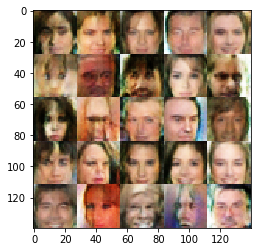

Epoch: 2/3 Discriminator Loss: 1.2778 Generator Loss: 0.7104
Epoch: 2/3 Discriminator Loss: 1.2123 Generator Loss: 0.8949
Epoch: 2/3 Discriminator Loss: 1.2645 Generator Loss: 0.8453
Epoch: 2/3 Discriminator Loss: 1.2873 Generator Loss: 0.7138
Epoch: 2/3 Discriminator Loss: 1.2802 Generator Loss: 0.8373
Epoch: 2/3 Discriminator Loss: 1.3409 Generator Loss: 0.9633
Epoch: 2/3 Discriminator Loss: 1.2966 Generator Loss: 0.7136
Epoch: 2/3 Discriminator Loss: 1.3170 Generator Loss: 0.7424
Epoch: 2/3 Discriminator Loss: 1.4177 Generator Loss: 0.7791
Epoch: 2/3 Discriminator Loss: 1.2728 Generator Loss: 0.7256


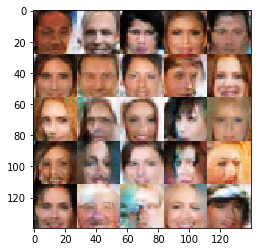

Epoch: 2/3 Discriminator Loss: 1.2993 Generator Loss: 0.7699
Epoch: 2/3 Discriminator Loss: 1.3503 Generator Loss: 0.6759
Epoch: 2/3 Discriminator Loss: 1.2938 Generator Loss: 0.7182
Epoch: 2/3 Discriminator Loss: 1.2773 Generator Loss: 0.7815
Epoch: 2/3 Discriminator Loss: 1.3092 Generator Loss: 0.8053
Epoch: 2/3 Discriminator Loss: 1.3184 Generator Loss: 0.9282
Epoch: 2/3 Discriminator Loss: 1.2552 Generator Loss: 0.7206
Epoch: 2/3 Discriminator Loss: 1.3210 Generator Loss: 0.7886
Epoch: 2/3 Discriminator Loss: 1.3291 Generator Loss: 0.6922
Epoch: 2/3 Discriminator Loss: 1.2484 Generator Loss: 0.7547


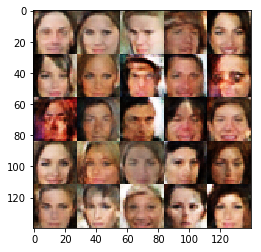

Epoch: 2/3 Discriminator Loss: 1.3108 Generator Loss: 0.8301
Epoch: 2/3 Discriminator Loss: 1.2277 Generator Loss: 0.9375
Epoch: 2/3 Discriminator Loss: 1.3123 Generator Loss: 0.6818
Epoch: 2/3 Discriminator Loss: 1.2832 Generator Loss: 0.7577
Epoch: 2/3 Discriminator Loss: 1.2713 Generator Loss: 0.8416
Epoch: 2/3 Discriminator Loss: 1.3079 Generator Loss: 0.8519
Epoch: 2/3 Discriminator Loss: 1.2351 Generator Loss: 0.8469
Epoch: 2/3 Discriminator Loss: 1.3240 Generator Loss: 0.7138
Epoch: 2/3 Discriminator Loss: 1.2274 Generator Loss: 0.8513
Epoch: 2/3 Discriminator Loss: 1.2880 Generator Loss: 0.7711


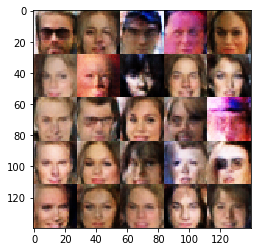

Epoch: 2/3 Discriminator Loss: 1.3726 Generator Loss: 0.7552
Epoch: 2/3 Discriminator Loss: 1.2701 Generator Loss: 0.8097
Epoch: 2/3 Discriminator Loss: 1.2934 Generator Loss: 0.8213
Epoch: 2/3 Discriminator Loss: 1.2211 Generator Loss: 0.8658
Epoch: 2/3 Discriminator Loss: 1.3259 Generator Loss: 0.7888
Epoch: 2/3 Discriminator Loss: 1.2789 Generator Loss: 0.9287
Epoch: 2/3 Discriminator Loss: 1.2992 Generator Loss: 0.6880
Epoch: 2/3 Discriminator Loss: 1.3421 Generator Loss: 0.6911
Epoch: 2/3 Discriminator Loss: 1.2344 Generator Loss: 0.9496
Epoch: 2/3 Discriminator Loss: 1.3270 Generator Loss: 0.8317


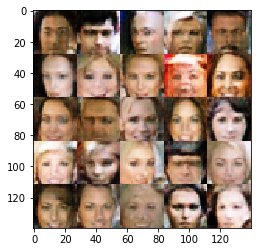

Epoch: 2/3 Discriminator Loss: 1.2434 Generator Loss: 0.8806
Epoch: 2/3 Discriminator Loss: 1.2590 Generator Loss: 0.7699
Epoch: 2/3 Discriminator Loss: 1.2536 Generator Loss: 0.7799
Epoch: 2/3 Discriminator Loss: 1.2801 Generator Loss: 0.7906
Epoch: 2/3 Discriminator Loss: 1.3603 Generator Loss: 0.6825
Epoch: 2/3 Discriminator Loss: 1.2954 Generator Loss: 0.8023
Epoch: 2/3 Discriminator Loss: 1.3827 Generator Loss: 0.9612
Epoch: 2/3 Discriminator Loss: 1.3457 Generator Loss: 0.7373
Epoch: 2/3 Discriminator Loss: 1.1961 Generator Loss: 0.8517
Epoch: 2/3 Discriminator Loss: 1.3452 Generator Loss: 0.7037


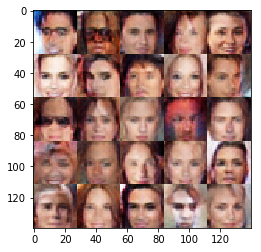

Epoch: 2/3 Discriminator Loss: 1.2870 Generator Loss: 0.8615
Epoch: 2/3 Discriminator Loss: 1.2803 Generator Loss: 0.8406
Epoch: 2/3 Discriminator Loss: 1.2869 Generator Loss: 0.8643
Epoch: 2/3 Discriminator Loss: 1.2885 Generator Loss: 0.9329
Epoch: 2/3 Discriminator Loss: 1.1648 Generator Loss: 0.8149
Epoch: 2/3 Discriminator Loss: 1.2819 Generator Loss: 0.7399
Epoch: 2/3 Discriminator Loss: 1.2998 Generator Loss: 0.8765
Epoch: 2/3 Discriminator Loss: 1.2032 Generator Loss: 0.9688
Epoch: 2/3 Discriminator Loss: 1.3177 Generator Loss: 0.7073
Epoch: 2/3 Discriminator Loss: 1.2530 Generator Loss: 0.9340


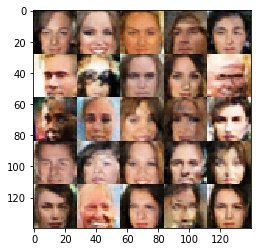

Epoch: 2/3 Discriminator Loss: 1.4146 Generator Loss: 0.6340
Epoch: 2/3 Discriminator Loss: 1.1903 Generator Loss: 1.0482
Epoch: 2/3 Discriminator Loss: 1.4194 Generator Loss: 0.7390
Epoch: 2/3 Discriminator Loss: 1.3810 Generator Loss: 1.0037
Epoch: 2/3 Discriminator Loss: 1.2196 Generator Loss: 0.9741
Epoch: 2/3 Discriminator Loss: 1.4296 Generator Loss: 0.6071
Epoch: 2/3 Discriminator Loss: 1.3267 Generator Loss: 0.6554
Epoch: 2/3 Discriminator Loss: 1.3727 Generator Loss: 0.6568
Epoch: 2/3 Discriminator Loss: 1.5160 Generator Loss: 0.6721
Epoch: 2/3 Discriminator Loss: 1.2387 Generator Loss: 0.8802


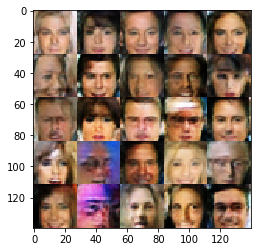

Epoch: 2/3 Discriminator Loss: 1.2983 Generator Loss: 0.7281
Epoch: 2/3 Discriminator Loss: 1.1590 Generator Loss: 0.8607
Epoch: 2/3 Discriminator Loss: 1.4105 Generator Loss: 0.7499
Epoch: 2/3 Discriminator Loss: 1.3482 Generator Loss: 0.7497
Epoch: 2/3 Discriminator Loss: 1.3827 Generator Loss: 0.6890
Epoch: 2/3 Discriminator Loss: 1.3197 Generator Loss: 0.8040
Epoch: 2/3 Discriminator Loss: 1.3927 Generator Loss: 0.7487
Epoch: 2/3 Discriminator Loss: 1.3375 Generator Loss: 0.6089
Epoch: 2/3 Discriminator Loss: 1.2012 Generator Loss: 0.8866
Epoch: 2/3 Discriminator Loss: 1.2510 Generator Loss: 0.8572


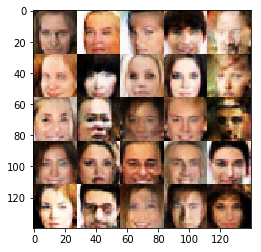

Epoch: 2/3 Discriminator Loss: 1.3154 Generator Loss: 0.7929
Epoch: 2/3 Discriminator Loss: 1.4072 Generator Loss: 0.6132
Epoch: 2/3 Discriminator Loss: 1.2466 Generator Loss: 0.9060
Epoch: 2/3 Discriminator Loss: 1.3294 Generator Loss: 0.8784
Epoch: 2/3 Discriminator Loss: 1.2276 Generator Loss: 0.8156
Epoch: 2/3 Discriminator Loss: 1.1525 Generator Loss: 1.0158
Epoch: 2/3 Discriminator Loss: 1.2981 Generator Loss: 0.6507
Epoch: 2/3 Discriminator Loss: 1.3084 Generator Loss: 0.7477
Epoch: 2/3 Discriminator Loss: 1.3453 Generator Loss: 0.8417
Epoch: 2/3 Discriminator Loss: 1.2778 Generator Loss: 0.8321


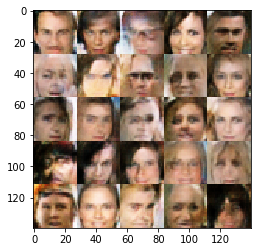

Epoch: 2/3 Discriminator Loss: 1.3029 Generator Loss: 0.7497
Epoch: 2/3 Discriminator Loss: 1.2558 Generator Loss: 0.7755
Epoch: 2/3 Discriminator Loss: 1.3951 Generator Loss: 0.6340
Epoch: 2/3 Discriminator Loss: 1.2594 Generator Loss: 0.9242
Epoch: 2/3 Discriminator Loss: 1.2983 Generator Loss: 0.8578
Epoch: 2/3 Discriminator Loss: 1.3982 Generator Loss: 0.7750
Epoch: 2/3 Discriminator Loss: 1.3757 Generator Loss: 0.6980
Epoch: 2/3 Discriminator Loss: 1.3173 Generator Loss: 0.8419
Epoch: 2/3 Discriminator Loss: 1.4189 Generator Loss: 0.6419
Epoch: 2/3 Discriminator Loss: 1.2880 Generator Loss: 0.8415


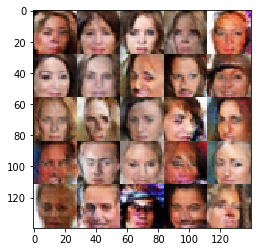

Epoch: 2/3 Discriminator Loss: 1.2742 Generator Loss: 0.7544
Epoch: 2/3 Discriminator Loss: 1.3195 Generator Loss: 0.8113
Epoch: 2/3 Discriminator Loss: 1.4285 Generator Loss: 0.6440
Epoch: 2/3 Discriminator Loss: 1.2737 Generator Loss: 0.8584
Epoch: 2/3 Discriminator Loss: 1.2241 Generator Loss: 0.8444
Epoch: 2/3 Discriminator Loss: 1.4481 Generator Loss: 0.6952
Epoch: 2/3 Discriminator Loss: 1.2943 Generator Loss: 0.7715
Epoch: 2/3 Discriminator Loss: 1.3280 Generator Loss: 0.7337
Epoch: 2/3 Discriminator Loss: 1.3688 Generator Loss: 0.7624
Epoch: 2/3 Discriminator Loss: 1.2192 Generator Loss: 0.8786


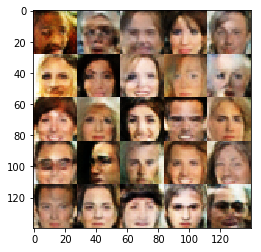

Epoch: 2/3 Discriminator Loss: 1.4902 Generator Loss: 0.6650
Epoch: 2/3 Discriminator Loss: 1.2032 Generator Loss: 0.8027
Epoch: 2/3 Discriminator Loss: 1.3487 Generator Loss: 0.7519
Epoch: 2/3 Discriminator Loss: 1.2409 Generator Loss: 0.9529
Epoch: 2/3 Discriminator Loss: 1.2781 Generator Loss: 0.8497
Epoch: 2/3 Discriminator Loss: 1.3259 Generator Loss: 0.7645
Epoch: 2/3 Discriminator Loss: 1.2335 Generator Loss: 0.8434
Epoch: 2/3 Discriminator Loss: 1.2154 Generator Loss: 1.1492
Epoch: 2/3 Discriminator Loss: 1.3635 Generator Loss: 0.6870
Epoch: 2/3 Discriminator Loss: 1.4101 Generator Loss: 0.7854


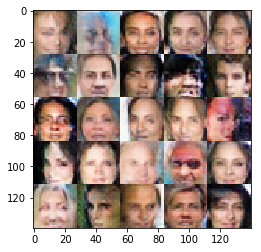

Epoch: 2/3 Discriminator Loss: 1.1937 Generator Loss: 0.8862
Epoch: 2/3 Discriminator Loss: 1.3351 Generator Loss: 0.7994
Epoch: 2/3 Discriminator Loss: 1.1773 Generator Loss: 0.9732
Epoch: 2/3 Discriminator Loss: 1.3002 Generator Loss: 0.7752
Epoch: 2/3 Discriminator Loss: 1.1853 Generator Loss: 0.8514
Epoch: 2/3 Discriminator Loss: 1.3549 Generator Loss: 0.7095
Epoch: 2/3 Discriminator Loss: 1.2917 Generator Loss: 0.7938
Epoch: 2/3 Discriminator Loss: 1.3416 Generator Loss: 0.7293
Epoch: 2/3 Discriminator Loss: 1.4094 Generator Loss: 0.6807
Epoch: 2/3 Discriminator Loss: 1.3866 Generator Loss: 0.6785


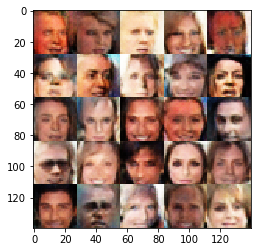

Epoch: 2/3 Discriminator Loss: 1.2781 Generator Loss: 0.8234
Epoch: 2/3 Discriminator Loss: 1.2505 Generator Loss: 0.8766
Epoch: 2/3 Discriminator Loss: 1.3118 Generator Loss: 0.7875
Epoch: 2/3 Discriminator Loss: 1.2999 Generator Loss: 0.8258
Epoch: 2/3 Discriminator Loss: 1.3181 Generator Loss: 0.8382
Epoch: 2/3 Discriminator Loss: 1.4039 Generator Loss: 0.7684
Epoch: 2/3 Discriminator Loss: 1.4281 Generator Loss: 0.6751
Epoch: 2/3 Discriminator Loss: 1.1576 Generator Loss: 1.0116
Epoch: 2/3 Discriminator Loss: 1.4025 Generator Loss: 0.6919
Epoch: 2/3 Discriminator Loss: 1.3365 Generator Loss: 0.8365


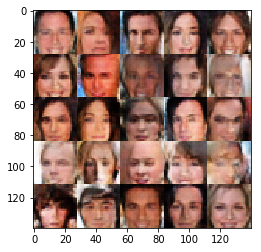

Epoch: 2/3 Discriminator Loss: 1.3603 Generator Loss: 0.7492
Epoch: 2/3 Discriminator Loss: 1.2290 Generator Loss: 0.8094
Epoch: 2/3 Discriminator Loss: 1.2681 Generator Loss: 0.8437
Epoch: 2/3 Discriminator Loss: 1.2369 Generator Loss: 0.9797
Epoch: 2/3 Discriminator Loss: 1.2274 Generator Loss: 0.8196
Epoch: 2/3 Discriminator Loss: 1.3759 Generator Loss: 0.7374
Epoch: 2/3 Discriminator Loss: 1.2803 Generator Loss: 0.8021
Epoch: 2/3 Discriminator Loss: 1.3272 Generator Loss: 0.8238
Epoch: 2/3 Discriminator Loss: 1.2501 Generator Loss: 0.8185
Epoch: 2/3 Discriminator Loss: 1.2674 Generator Loss: 0.8127


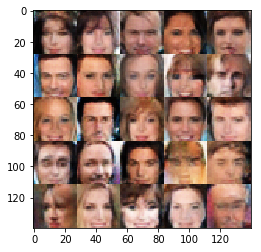

Epoch: 2/3 Discriminator Loss: 1.2745 Generator Loss: 0.8366
Epoch: 2/3 Discriminator Loss: 1.2421 Generator Loss: 0.8310
Epoch: 2/3 Discriminator Loss: 1.3209 Generator Loss: 0.8301
Epoch: 2/3 Discriminator Loss: 1.3673 Generator Loss: 0.6530
Epoch: 2/3 Discriminator Loss: 1.3619 Generator Loss: 0.8969
Epoch: 2/3 Discriminator Loss: 1.1986 Generator Loss: 0.9755
Epoch: 2/3 Discriminator Loss: 1.2190 Generator Loss: 0.8923
Epoch: 2/3 Discriminator Loss: 1.4498 Generator Loss: 0.6973
Epoch: 2/3 Discriminator Loss: 1.2403 Generator Loss: 0.7951
Epoch: 2/3 Discriminator Loss: 1.3277 Generator Loss: 0.8222


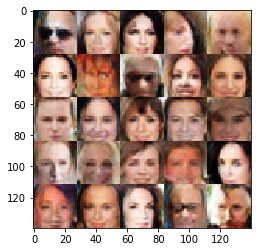

Epoch: 2/3 Discriminator Loss: 1.3545 Generator Loss: 0.7111
Epoch: 2/3 Discriminator Loss: 1.3171 Generator Loss: 0.8960
Epoch: 2/3 Discriminator Loss: 1.2250 Generator Loss: 0.8228
Epoch: 2/3 Discriminator Loss: 1.3556 Generator Loss: 0.8424
Epoch: 2/3 Discriminator Loss: 1.4001 Generator Loss: 0.6850
Epoch: 2/3 Discriminator Loss: 1.3193 Generator Loss: 0.6744
Epoch: 2/3 Discriminator Loss: 1.3334 Generator Loss: 0.7642
Epoch: 2/3 Discriminator Loss: 1.4612 Generator Loss: 0.6090
Epoch: 2/3 Discriminator Loss: 1.1405 Generator Loss: 0.9150
Epoch: 2/3 Discriminator Loss: 1.2582 Generator Loss: 1.1463


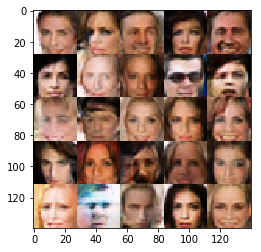

Epoch: 2/3 Discriminator Loss: 1.3600 Generator Loss: 0.8116
Epoch: 2/3 Discriminator Loss: 1.2601 Generator Loss: 0.8120
Epoch: 2/3 Discriminator Loss: 1.4610 Generator Loss: 0.7203
Epoch: 2/3 Discriminator Loss: 1.3616 Generator Loss: 0.7874
Epoch: 2/3 Discriminator Loss: 1.2397 Generator Loss: 0.9251
Epoch: 2/3 Discriminator Loss: 1.2461 Generator Loss: 0.9287
Epoch: 2/3 Discriminator Loss: 1.2815 Generator Loss: 0.9301
Epoch: 2/3 Discriminator Loss: 1.4019 Generator Loss: 0.7025
Epoch: 2/3 Discriminator Loss: 1.3215 Generator Loss: 0.7006
Epoch: 2/3 Discriminator Loss: 1.3813 Generator Loss: 0.7699


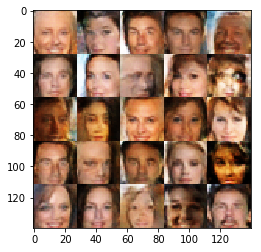

Epoch: 2/3 Discriminator Loss: 1.4054 Generator Loss: 0.7999
Epoch: 2/3 Discriminator Loss: 1.3656 Generator Loss: 0.7023
Epoch: 2/3 Discriminator Loss: 1.2737 Generator Loss: 0.8427
Epoch: 2/3 Discriminator Loss: 1.3604 Generator Loss: 0.7006
Epoch: 2/3 Discriminator Loss: 1.3096 Generator Loss: 0.8061
Epoch: 2/3 Discriminator Loss: 1.3235 Generator Loss: 0.7880
Epoch: 2/3 Discriminator Loss: 1.2504 Generator Loss: 0.7954
Epoch: 2/3 Discriminator Loss: 1.2110 Generator Loss: 0.9630
Epoch: 2/3 Discriminator Loss: 1.3833 Generator Loss: 0.6625
Epoch: 2/3 Discriminator Loss: 1.2730 Generator Loss: 0.7817


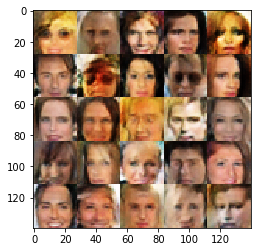

Epoch: 2/3 Discriminator Loss: 1.1860 Generator Loss: 0.9852
Epoch: 2/3 Discriminator Loss: 1.3776 Generator Loss: 0.7838
Epoch: 2/3 Discriminator Loss: 1.2822 Generator Loss: 0.8874
Epoch: 2/3 Discriminator Loss: 1.3602 Generator Loss: 0.7769
Epoch: 2/3 Discriminator Loss: 1.1922 Generator Loss: 1.0006
Epoch: 2/3 Discriminator Loss: 1.2559 Generator Loss: 0.8128
Epoch: 2/3 Discriminator Loss: 1.2434 Generator Loss: 0.8429
Epoch: 2/3 Discriminator Loss: 1.3380 Generator Loss: 0.7096
Epoch: 2/3 Discriminator Loss: 1.2540 Generator Loss: 0.8865
Epoch: 2/3 Discriminator Loss: 1.3258 Generator Loss: 0.7126


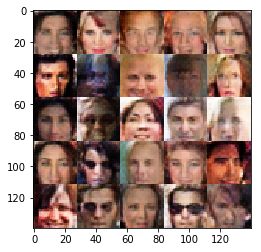

Epoch: 2/3 Discriminator Loss: 1.3390 Generator Loss: 0.7630
Epoch: 2/3 Discriminator Loss: 1.2756 Generator Loss: 0.9170
Epoch: 2/3 Discriminator Loss: 1.3668 Generator Loss: 1.2348
Epoch: 2/3 Discriminator Loss: 1.3077 Generator Loss: 0.7454
Epoch: 2/3 Discriminator Loss: 1.2955 Generator Loss: 0.8011
Epoch: 2/3 Discriminator Loss: 1.3815 Generator Loss: 0.6832
Epoch: 2/3 Discriminator Loss: 1.3062 Generator Loss: 0.7327
Epoch: 2/3 Discriminator Loss: 1.2776 Generator Loss: 0.9153
Epoch: 2/3 Discriminator Loss: 1.2879 Generator Loss: 0.8614
Epoch: 2/3 Discriminator Loss: 1.2864 Generator Loss: 0.8087


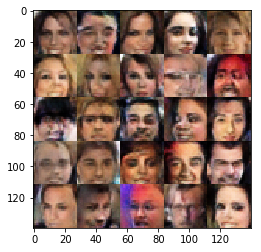

Epoch: 2/3 Discriminator Loss: 1.2437 Generator Loss: 0.8531
Epoch: 2/3 Discriminator Loss: 1.3380 Generator Loss: 0.7826
Epoch: 2/3 Discriminator Loss: 1.3411 Generator Loss: 0.7341
Epoch: 2/3 Discriminator Loss: 1.2173 Generator Loss: 0.7841
Epoch: 2/3 Discriminator Loss: 1.2670 Generator Loss: 0.9381
Epoch: 2/3 Discriminator Loss: 1.1979 Generator Loss: 0.8757
Epoch: 2/3 Discriminator Loss: 1.3024 Generator Loss: 0.7845
Epoch: 2/3 Discriminator Loss: 1.3307 Generator Loss: 0.7175
Epoch: 2/3 Discriminator Loss: 1.3441 Generator Loss: 0.8223
Epoch: 2/3 Discriminator Loss: 1.4410 Generator Loss: 0.7372


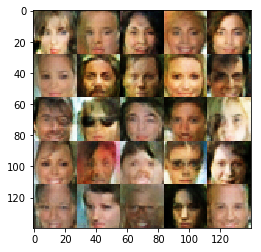

Epoch: 2/3 Discriminator Loss: 1.2583 Generator Loss: 0.6999
Epoch: 2/3 Discriminator Loss: 1.2843 Generator Loss: 0.7314
Epoch: 2/3 Discriminator Loss: 1.3580 Generator Loss: 0.7940
Epoch: 2/3 Discriminator Loss: 1.2356 Generator Loss: 0.8549
Epoch: 2/3 Discriminator Loss: 1.3847 Generator Loss: 0.7576
Epoch: 2/3 Discriminator Loss: 1.2535 Generator Loss: 0.7177
Epoch: 2/3 Discriminator Loss: 1.3403 Generator Loss: 0.7810
Epoch: 2/3 Discriminator Loss: 1.1964 Generator Loss: 0.8166
Epoch: 2/3 Discriminator Loss: 1.2990 Generator Loss: 0.8304
Epoch: 2/3 Discriminator Loss: 1.2907 Generator Loss: 0.7838


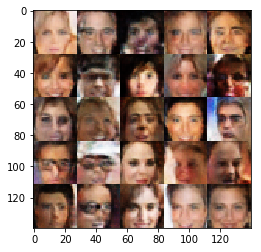

Epoch: 2/3 Discriminator Loss: 1.2809 Generator Loss: 0.7789
Epoch: 2/3 Discriminator Loss: 1.3583 Generator Loss: 0.9107
Epoch: 2/3 Discriminator Loss: 1.2888 Generator Loss: 0.8707
Epoch: 2/3 Discriminator Loss: 1.2794 Generator Loss: 0.8684
Epoch: 2/3 Discriminator Loss: 1.2944 Generator Loss: 0.7377
Epoch: 2/3 Discriminator Loss: 1.2577 Generator Loss: 0.8186
Epoch: 2/3 Discriminator Loss: 1.3229 Generator Loss: 0.7860
Epoch: 2/3 Discriminator Loss: 1.3546 Generator Loss: 0.6282
Epoch: 2/3 Discriminator Loss: 1.3231 Generator Loss: 0.7983
Epoch: 2/3 Discriminator Loss: 1.3166 Generator Loss: 0.8328


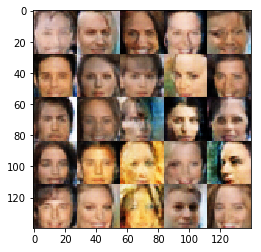

Epoch: 2/3 Discriminator Loss: 1.2977 Generator Loss: 0.8066
Epoch: 2/3 Discriminator Loss: 1.3779 Generator Loss: 0.7089
Epoch: 2/3 Discriminator Loss: 1.3550 Generator Loss: 0.7343
Epoch: 2/3 Discriminator Loss: 1.3560 Generator Loss: 0.6590
Epoch: 2/3 Discriminator Loss: 1.1577 Generator Loss: 0.9371
Epoch: 2/3 Discriminator Loss: 1.2680 Generator Loss: 0.7629
Epoch: 2/3 Discriminator Loss: 1.4060 Generator Loss: 0.7686
Epoch: 2/3 Discriminator Loss: 1.3175 Generator Loss: 0.7768
Epoch: 2/3 Discriminator Loss: 1.3035 Generator Loss: 0.7443
Epoch: 2/3 Discriminator Loss: 1.3513 Generator Loss: 0.7084


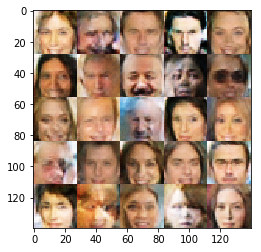

Epoch: 2/3 Discriminator Loss: 1.2113 Generator Loss: 0.9087
Epoch: 2/3 Discriminator Loss: 1.2833 Generator Loss: 0.7843
Epoch: 2/3 Discriminator Loss: 1.3870 Generator Loss: 0.6906
Epoch: 2/3 Discriminator Loss: 1.3218 Generator Loss: 0.7674
Epoch: 2/3 Discriminator Loss: 1.2426 Generator Loss: 0.8251
Epoch: 2/3 Discriminator Loss: 1.4964 Generator Loss: 0.6726
Epoch: 2/3 Discriminator Loss: 1.3208 Generator Loss: 0.7261
Epoch: 2/3 Discriminator Loss: 1.2648 Generator Loss: 0.7584
Epoch: 2/3 Discriminator Loss: 1.4060 Generator Loss: 0.6455
Epoch: 2/3 Discriminator Loss: 1.2029 Generator Loss: 0.9294


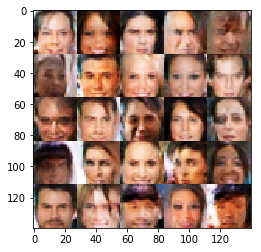

Epoch: 2/3 Discriminator Loss: 1.2136 Generator Loss: 0.9497
Epoch: 2/3 Discriminator Loss: 1.2197 Generator Loss: 0.8452
Epoch: 2/3 Discriminator Loss: 1.3068 Generator Loss: 0.7756
Epoch: 2/3 Discriminator Loss: 1.3617 Generator Loss: 0.6724
Epoch: 2/3 Discriminator Loss: 1.2892 Generator Loss: 0.8084
Epoch: 2/3 Discriminator Loss: 1.3430 Generator Loss: 0.8120
Epoch: 2/3 Discriminator Loss: 1.3844 Generator Loss: 0.7103
Epoch: 2/3 Discriminator Loss: 1.2782 Generator Loss: 0.7610
Epoch: 2/3 Discriminator Loss: 1.3211 Generator Loss: 0.7542
Epoch: 2/3 Discriminator Loss: 1.3563 Generator Loss: 0.7519


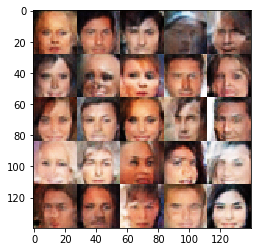

Epoch: 2/3 Discriminator Loss: 1.3230 Generator Loss: 0.7069
Epoch: 2/3 Discriminator Loss: 1.3489 Generator Loss: 0.7860
Epoch: 2/3 Discriminator Loss: 1.2818 Generator Loss: 0.8339
Epoch: 2/3 Discriminator Loss: 1.4162 Generator Loss: 0.7191
Epoch: 2/3 Discriminator Loss: 1.2974 Generator Loss: 0.7313
Epoch: 2/3 Discriminator Loss: 1.2573 Generator Loss: 0.7695
Epoch: 2/3 Discriminator Loss: 1.2719 Generator Loss: 0.7602
Epoch: 2/3 Discriminator Loss: 1.3339 Generator Loss: 0.7190
Epoch: 2/3 Discriminator Loss: 1.3600 Generator Loss: 0.7526
Epoch: 2/3 Discriminator Loss: 1.4096 Generator Loss: 0.9057


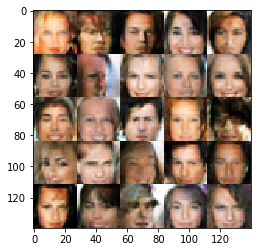

Epoch: 2/3 Discriminator Loss: 1.3342 Generator Loss: 0.7253
Epoch: 2/3 Discriminator Loss: 1.5132 Generator Loss: 0.6764
Epoch: 2/3 Discriminator Loss: 1.2464 Generator Loss: 0.8922
Epoch: 2/3 Discriminator Loss: 1.3982 Generator Loss: 0.6474
Epoch: 2/3 Discriminator Loss: 1.4116 Generator Loss: 0.7260
Epoch: 2/3 Discriminator Loss: 1.2911 Generator Loss: 0.8068
Epoch: 2/3 Discriminator Loss: 1.3546 Generator Loss: 0.7542
Epoch: 2/3 Discriminator Loss: 1.3210 Generator Loss: 0.7795
Epoch: 2/3 Discriminator Loss: 1.3103 Generator Loss: 0.7905
Epoch: 2/3 Discriminator Loss: 1.2830 Generator Loss: 0.7716


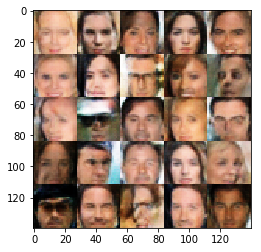

Epoch: 2/3 Discriminator Loss: 1.4750 Generator Loss: 0.7105
Epoch: 2/3 Discriminator Loss: 1.3594 Generator Loss: 0.7395
Epoch: 2/3 Discriminator Loss: 1.3614 Generator Loss: 0.6962
Epoch: 2/3 Discriminator Loss: 1.2931 Generator Loss: 0.8187
Epoch: 2/3 Discriminator Loss: 1.2443 Generator Loss: 0.8492
Epoch: 2/3 Discriminator Loss: 1.3823 Generator Loss: 0.7056
Epoch: 2/3 Discriminator Loss: 1.3939 Generator Loss: 0.6696
Epoch: 2/3 Discriminator Loss: 1.3797 Generator Loss: 0.7975
Epoch: 2/3 Discriminator Loss: 1.2570 Generator Loss: 0.8330
Epoch: 2/3 Discriminator Loss: 1.2806 Generator Loss: 0.7739


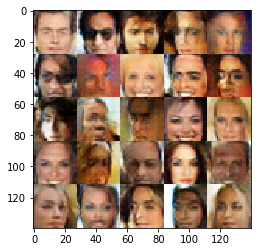

Epoch: 2/3 Discriminator Loss: 1.3719 Generator Loss: 0.6934
Epoch: 2/3 Discriminator Loss: 1.3075 Generator Loss: 0.7794
Epoch: 2/3 Discriminator Loss: 1.2785 Generator Loss: 0.8322
Epoch: 2/3 Discriminator Loss: 1.1947 Generator Loss: 0.9555
Epoch: 2/3 Discriminator Loss: 1.3717 Generator Loss: 0.7079
Epoch: 2/3 Discriminator Loss: 1.2472 Generator Loss: 0.8153
Epoch: 2/3 Discriminator Loss: 1.2133 Generator Loss: 0.9136
Epoch: 2/3 Discriminator Loss: 1.2553 Generator Loss: 0.8576
Epoch: 2/3 Discriminator Loss: 1.3141 Generator Loss: 0.8332
Epoch: 2/3 Discriminator Loss: 1.2798 Generator Loss: 0.8620


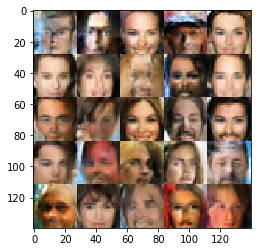

Epoch: 2/3 Discriminator Loss: 1.2751 Generator Loss: 0.9044
Epoch: 2/3 Discriminator Loss: 1.4562 Generator Loss: 0.7347
Epoch: 2/3 Discriminator Loss: 1.3844 Generator Loss: 0.6708
Epoch: 2/3 Discriminator Loss: 1.2638 Generator Loss: 0.8350
Epoch: 2/3 Discriminator Loss: 1.2839 Generator Loss: 0.7273
Epoch: 2/3 Discriminator Loss: 1.2064 Generator Loss: 1.0048
Epoch: 2/3 Discriminator Loss: 1.3635 Generator Loss: 0.7454
Epoch: 2/3 Discriminator Loss: 1.2917 Generator Loss: 0.7810
Epoch: 2/3 Discriminator Loss: 1.2335 Generator Loss: 0.8752
Epoch: 2/3 Discriminator Loss: 1.2171 Generator Loss: 0.8783


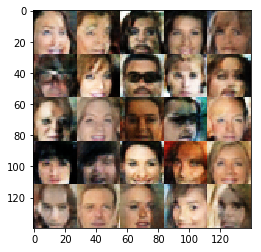

Epoch: 2/3 Discriminator Loss: 1.3054 Generator Loss: 0.7398
Epoch: 2/3 Discriminator Loss: 1.3177 Generator Loss: 0.7691
Epoch: 2/3 Discriminator Loss: 1.2983 Generator Loss: 0.6835
Epoch: 2/3 Discriminator Loss: 1.3103 Generator Loss: 0.8768
Epoch: 2/3 Discriminator Loss: 1.3019 Generator Loss: 0.8207
Epoch: 2/3 Discriminator Loss: 1.2424 Generator Loss: 0.9097
Epoch: 2/3 Discriminator Loss: 1.4114 Generator Loss: 0.7071
Epoch: 2/3 Discriminator Loss: 1.2260 Generator Loss: 1.0404
Epoch: 2/3 Discriminator Loss: 1.2869 Generator Loss: 0.7827
Epoch: 2/3 Discriminator Loss: 1.2916 Generator Loss: 0.7865


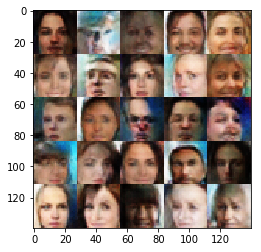

Epoch: 2/3 Discriminator Loss: 1.3396 Generator Loss: 0.9764
Epoch: 2/3 Discriminator Loss: 1.3325 Generator Loss: 0.8628
Epoch: 2/3 Discriminator Loss: 1.3669 Generator Loss: 0.6496
Epoch: 2/3 Discriminator Loss: 1.3278 Generator Loss: 0.7675
Epoch: 2/3 Discriminator Loss: 1.3427 Generator Loss: 0.8440
Epoch: 2/3 Discriminator Loss: 1.3609 Generator Loss: 0.7365
Epoch: 2/3 Discriminator Loss: 1.3859 Generator Loss: 0.8660
Epoch: 2/3 Discriminator Loss: 1.3256 Generator Loss: 0.7395
Epoch: 2/3 Discriminator Loss: 1.3208 Generator Loss: 0.8704
Epoch: 2/3 Discriminator Loss: 1.2111 Generator Loss: 0.7741


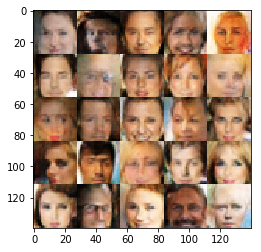

Epoch: 2/3 Discriminator Loss: 1.3217 Generator Loss: 0.9027
Epoch: 2/3 Discriminator Loss: 1.3354 Generator Loss: 0.7033
Epoch: 2/3 Discriminator Loss: 1.3023 Generator Loss: 0.8996
Epoch: 2/3 Discriminator Loss: 1.3144 Generator Loss: 0.6595
Epoch: 2/3 Discriminator Loss: 1.2777 Generator Loss: 0.8005
Epoch: 2/3 Discriminator Loss: 1.3711 Generator Loss: 0.8336
Epoch: 2/3 Discriminator Loss: 1.2277 Generator Loss: 0.8543
Epoch: 2/3 Discriminator Loss: 1.4619 Generator Loss: 0.6043
Epoch: 2/3 Discriminator Loss: 1.3473 Generator Loss: 0.7435
Epoch: 2/3 Discriminator Loss: 1.2907 Generator Loss: 0.7402


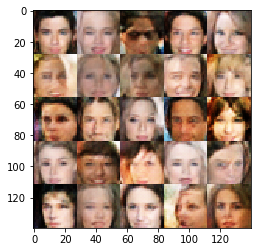

Epoch: 2/3 Discriminator Loss: 1.3091 Generator Loss: 0.6978
Epoch: 2/3 Discriminator Loss: 1.3261 Generator Loss: 0.7807
Epoch: 2/3 Discriminator Loss: 1.4122 Generator Loss: 0.7490
Epoch: 2/3 Discriminator Loss: 1.2476 Generator Loss: 0.9753
Epoch: 2/3 Discriminator Loss: 1.2409 Generator Loss: 0.9081
Epoch: 2/3 Discriminator Loss: 1.3262 Generator Loss: 0.7749
Epoch: 2/3 Discriminator Loss: 1.2476 Generator Loss: 0.9393
Epoch: 2/3 Discriminator Loss: 1.2811 Generator Loss: 0.8604
Epoch: 2/3 Discriminator Loss: 1.3137 Generator Loss: 0.9111
Epoch: 2/3 Discriminator Loss: 1.3113 Generator Loss: 0.7334


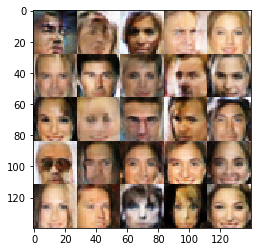

Epoch: 2/3 Discriminator Loss: 1.2611 Generator Loss: 0.8574
Epoch: 2/3 Discriminator Loss: 1.3030 Generator Loss: 0.8937
Epoch: 2/3 Discriminator Loss: 1.3089 Generator Loss: 0.7179
Epoch: 2/3 Discriminator Loss: 1.4611 Generator Loss: 0.5824
Epoch: 2/3 Discriminator Loss: 1.3545 Generator Loss: 0.8107
Epoch: 2/3 Discriminator Loss: 1.2227 Generator Loss: 0.7819
Epoch: 2/3 Discriminator Loss: 1.3372 Generator Loss: 0.7692
Epoch: 2/3 Discriminator Loss: 1.3443 Generator Loss: 0.7927
Epoch: 2/3 Discriminator Loss: 1.4196 Generator Loss: 0.7590
Epoch: 2/3 Discriminator Loss: 1.2327 Generator Loss: 0.8933


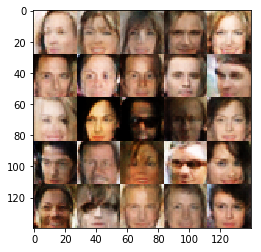

Epoch: 2/3 Discriminator Loss: 1.2791 Generator Loss: 0.7785
Epoch: 2/3 Discriminator Loss: 1.2287 Generator Loss: 0.8901
Epoch: 2/3 Discriminator Loss: 1.3403 Generator Loss: 0.7629
Epoch: 2/3 Discriminator Loss: 1.3232 Generator Loss: 0.7394
Epoch: 2/3 Discriminator Loss: 1.2394 Generator Loss: 0.7446
Epoch: 2/3 Discriminator Loss: 1.3754 Generator Loss: 0.7457
Epoch: 2/3 Discriminator Loss: 1.3359 Generator Loss: 0.7677
Epoch: 2/3 Discriminator Loss: 1.3790 Generator Loss: 0.8353
Epoch: 2/3 Discriminator Loss: 1.2761 Generator Loss: 0.7460
Epoch: 2/3 Discriminator Loss: 1.3140 Generator Loss: 0.7183


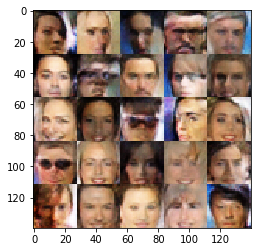

Epoch: 2/3 Discriminator Loss: 1.3089 Generator Loss: 0.8468
Epoch: 2/3 Discriminator Loss: 1.3532 Generator Loss: 0.7379
Epoch: 2/3 Discriminator Loss: 1.2942 Generator Loss: 0.8057
Epoch: 2/3 Discriminator Loss: 1.2677 Generator Loss: 0.8450
Epoch: 2/3 Discriminator Loss: 1.3022 Generator Loss: 0.9310
Epoch: 2/3 Discriminator Loss: 1.2337 Generator Loss: 0.8309
Epoch: 2/3 Discriminator Loss: 1.3135 Generator Loss: 0.8054
Epoch: 2/3 Discriminator Loss: 1.3216 Generator Loss: 0.6836
Epoch: 2/3 Discriminator Loss: 1.3144 Generator Loss: 0.8064
Epoch: 2/3 Discriminator Loss: 1.3367 Generator Loss: 0.8166


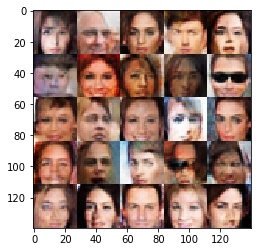

Epoch: 2/3 Discriminator Loss: 1.3172 Generator Loss: 0.9575
Epoch: 2/3 Discriminator Loss: 1.1825 Generator Loss: 0.9407
Epoch: 2/3 Discriminator Loss: 1.3416 Generator Loss: 0.8206
Epoch: 2/3 Discriminator Loss: 1.4099 Generator Loss: 0.6648
Epoch: 2/3 Discriminator Loss: 1.2778 Generator Loss: 0.8029
Epoch: 2/3 Discriminator Loss: 1.3911 Generator Loss: 0.6187
Epoch: 2/3 Discriminator Loss: 1.2375 Generator Loss: 0.8538
Epoch: 2/3 Discriminator Loss: 1.3361 Generator Loss: 0.7228
Epoch: 2/3 Discriminator Loss: 1.3955 Generator Loss: 0.6547
Epoch: 2/3 Discriminator Loss: 1.3268 Generator Loss: 0.7262


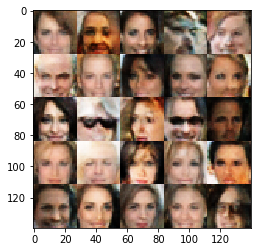

Epoch: 2/3 Discriminator Loss: 1.3130 Generator Loss: 0.8911
Epoch: 2/3 Discriminator Loss: 1.4188 Generator Loss: 0.7296
Epoch: 2/3 Discriminator Loss: 1.3003 Generator Loss: 0.8254
Epoch: 2/3 Discriminator Loss: 1.2613 Generator Loss: 0.8316
Epoch: 2/3 Discriminator Loss: 1.3833 Generator Loss: 0.6465
Epoch: 2/3 Discriminator Loss: 1.3007 Generator Loss: 0.7943
Epoch: 2/3 Discriminator Loss: 1.2341 Generator Loss: 0.8783
Epoch: 2/3 Discriminator Loss: 1.2746 Generator Loss: 0.8393
Epoch: 2/3 Discriminator Loss: 1.3973 Generator Loss: 0.6403
Epoch: 2/3 Discriminator Loss: 1.3323 Generator Loss: 0.7379


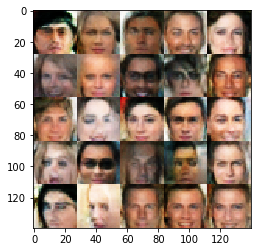

Epoch: 2/3 Discriminator Loss: 1.3378 Generator Loss: 0.7782
Epoch: 2/3 Discriminator Loss: 1.2717 Generator Loss: 0.8608
Epoch: 2/3 Discriminator Loss: 1.4596 Generator Loss: 0.6396
Epoch: 2/3 Discriminator Loss: 1.2619 Generator Loss: 0.8520
Epoch: 2/3 Discriminator Loss: 1.3086 Generator Loss: 0.7907
Epoch: 2/3 Discriminator Loss: 1.3411 Generator Loss: 0.8216
Epoch: 2/3 Discriminator Loss: 1.3395 Generator Loss: 0.7445
Epoch: 2/3 Discriminator Loss: 1.3258 Generator Loss: 0.6534
Epoch: 2/3 Discriminator Loss: 1.3655 Generator Loss: 0.6514
Epoch: 2/3 Discriminator Loss: 1.5078 Generator Loss: 0.5361


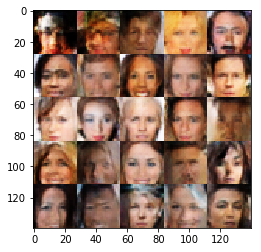

Epoch: 2/3 Discriminator Loss: 1.2940 Generator Loss: 0.7529
Epoch: 2/3 Discriminator Loss: 1.3401 Generator Loss: 0.8299
Epoch: 2/3 Discriminator Loss: 1.3501 Generator Loss: 0.6657
Epoch: 2/3 Discriminator Loss: 1.1566 Generator Loss: 0.9415
Epoch: 2/3 Discriminator Loss: 1.2580 Generator Loss: 0.8555
Epoch: 2/3 Discriminator Loss: 1.3697 Generator Loss: 0.8083
Epoch: 2/3 Discriminator Loss: 1.3315 Generator Loss: 0.8142
Epoch: 2/3 Discriminator Loss: 1.4296 Generator Loss: 0.6504
Epoch: 2/3 Discriminator Loss: 1.3408 Generator Loss: 0.7865
Epoch: 2/3 Discriminator Loss: 1.3157 Generator Loss: 0.8137


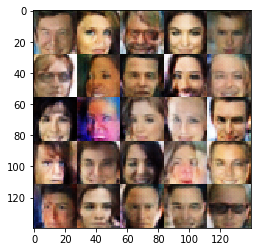

Epoch: 2/3 Discriminator Loss: 1.3370 Generator Loss: 0.6917
Epoch: 2/3 Discriminator Loss: 1.3003 Generator Loss: 0.9658
Epoch: 2/3 Discriminator Loss: 1.3898 Generator Loss: 0.7168
Epoch: 2/3 Discriminator Loss: 1.3953 Generator Loss: 0.6932
Epoch: 2/3 Discriminator Loss: 1.3338 Generator Loss: 0.6761
Epoch: 2/3 Discriminator Loss: 1.3503 Generator Loss: 0.7285
Epoch: 2/3 Discriminator Loss: 1.2454 Generator Loss: 0.7781
Epoch: 2/3 Discriminator Loss: 1.3083 Generator Loss: 0.9149
Epoch: 2/3 Discriminator Loss: 1.3269 Generator Loss: 0.8319
Epoch: 2/3 Discriminator Loss: 1.3880 Generator Loss: 0.7486


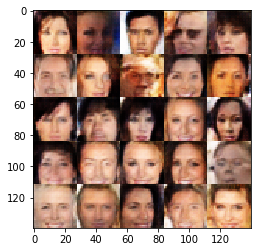

Epoch: 2/3 Discriminator Loss: 1.3062 Generator Loss: 0.7525
Epoch: 2/3 Discriminator Loss: 1.2658 Generator Loss: 0.7246
Epoch: 2/3 Discriminator Loss: 1.4178 Generator Loss: 0.6485
Epoch: 2/3 Discriminator Loss: 1.3389 Generator Loss: 0.7764
Epoch: 2/3 Discriminator Loss: 1.2632 Generator Loss: 0.7875
Epoch: 2/3 Discriminator Loss: 1.2892 Generator Loss: 0.8517
Epoch: 2/3 Discriminator Loss: 1.3700 Generator Loss: 0.7057
Epoch: 2/3 Discriminator Loss: 1.2891 Generator Loss: 0.7901
Epoch: 2/3 Discriminator Loss: 1.3725 Generator Loss: 0.7188
Epoch: 2/3 Discriminator Loss: 1.2290 Generator Loss: 0.8618


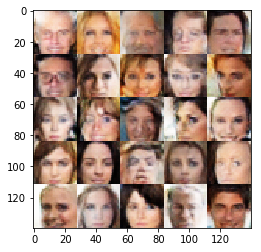

Epoch: 2/3 Discriminator Loss: 1.1984 Generator Loss: 0.9709
Epoch: 2/3 Discriminator Loss: 1.3028 Generator Loss: 0.7087
Epoch: 2/3 Discriminator Loss: 1.2300 Generator Loss: 0.8170
Epoch: 2/3 Discriminator Loss: 1.4187 Generator Loss: 0.7462
Epoch: 2/3 Discriminator Loss: 1.3808 Generator Loss: 0.7611
Epoch: 2/3 Discriminator Loss: 1.3725 Generator Loss: 0.6668
Epoch: 2/3 Discriminator Loss: 1.2704 Generator Loss: 0.8150
Epoch: 2/3 Discriminator Loss: 1.3748 Generator Loss: 0.8040
Epoch: 2/3 Discriminator Loss: 1.2561 Generator Loss: 0.8406
Epoch: 2/3 Discriminator Loss: 1.2616 Generator Loss: 0.7971


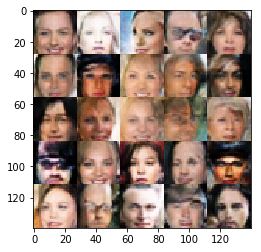

Epoch: 2/3 Discriminator Loss: 1.4286 Generator Loss: 0.6627
Epoch: 2/3 Discriminator Loss: 1.2752 Generator Loss: 0.8511
Epoch: 2/3 Discriminator Loss: 1.3209 Generator Loss: 0.7587
Epoch: 2/3 Discriminator Loss: 1.2894 Generator Loss: 0.7011
Epoch: 2/3 Discriminator Loss: 1.3123 Generator Loss: 0.7835
Epoch: 2/3 Discriminator Loss: 1.3750 Generator Loss: 0.7410
Epoch: 2/3 Discriminator Loss: 1.3145 Generator Loss: 0.7434
Epoch: 2/3 Discriminator Loss: 1.2251 Generator Loss: 1.0090
Epoch: 2/3 Discriminator Loss: 1.3274 Generator Loss: 0.7998
Epoch: 2/3 Discriminator Loss: 1.2741 Generator Loss: 0.7699


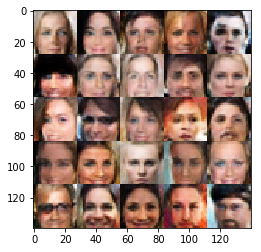

Epoch: 2/3 Discriminator Loss: 1.2167 Generator Loss: 0.9059
Epoch: 2/3 Discriminator Loss: 1.3653 Generator Loss: 0.7287
Epoch: 2/3 Discriminator Loss: 1.4875 Generator Loss: 0.6274
Epoch: 2/3 Discriminator Loss: 1.3991 Generator Loss: 0.7033
Epoch: 2/3 Discriminator Loss: 1.3390 Generator Loss: 0.7628
Epoch: 2/3 Discriminator Loss: 1.3051 Generator Loss: 0.8041
Epoch: 2/3 Discriminator Loss: 1.3120 Generator Loss: 0.7692
Epoch: 2/3 Discriminator Loss: 1.2857 Generator Loss: 0.8081
Epoch: 2/3 Discriminator Loss: 1.1958 Generator Loss: 0.8652
Epoch: 2/3 Discriminator Loss: 1.3100 Generator Loss: 0.7122


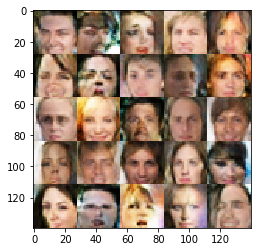

Epoch: 2/3 Discriminator Loss: 1.2887 Generator Loss: 0.7813
Epoch: 2/3 Discriminator Loss: 1.3276 Generator Loss: 0.7271
Epoch: 2/3 Discriminator Loss: 1.2896 Generator Loss: 0.7325
Epoch: 2/3 Discriminator Loss: 1.3500 Generator Loss: 0.8122
Epoch: 2/3 Discriminator Loss: 1.4464 Generator Loss: 0.6929
Epoch: 2/3 Discriminator Loss: 1.3163 Generator Loss: 0.8332
Epoch: 2/3 Discriminator Loss: 1.2164 Generator Loss: 0.9236
Epoch: 2/3 Discriminator Loss: 1.2619 Generator Loss: 0.7398
Epoch: 2/3 Discriminator Loss: 1.3096 Generator Loss: 0.8208
Epoch: 2/3 Discriminator Loss: 1.2767 Generator Loss: 0.7288


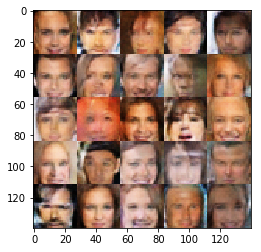

Epoch: 2/3 Discriminator Loss: 1.3152 Generator Loss: 0.8786
Epoch: 2/3 Discriminator Loss: 1.4287 Generator Loss: 0.8157
Epoch: 2/3 Discriminator Loss: 1.2563 Generator Loss: 0.7998
Epoch: 2/3 Discriminator Loss: 1.2674 Generator Loss: 0.7972
Epoch: 2/3 Discriminator Loss: 1.3318 Generator Loss: 0.7455
Epoch: 2/3 Discriminator Loss: 1.3587 Generator Loss: 0.6500
Epoch: 2/3 Discriminator Loss: 1.3572 Generator Loss: 0.8069
Epoch: 2/3 Discriminator Loss: 1.2966 Generator Loss: 0.7339
Epoch: 2/3 Discriminator Loss: 1.3792 Generator Loss: 0.7997
Epoch: 2/3 Discriminator Loss: 1.3974 Generator Loss: 0.6622


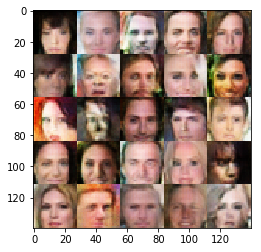

Epoch: 2/3 Discriminator Loss: 1.3292 Generator Loss: 0.7939
Epoch: 2/3 Discriminator Loss: 1.3346 Generator Loss: 0.7755
Epoch: 2/3 Discriminator Loss: 1.2235 Generator Loss: 0.8703
Epoch: 2/3 Discriminator Loss: 1.4374 Generator Loss: 0.6511
Epoch: 2/3 Discriminator Loss: 1.3976 Generator Loss: 0.6558
Epoch: 2/3 Discriminator Loss: 1.2255 Generator Loss: 0.9646
Epoch: 2/3 Discriminator Loss: 1.3479 Generator Loss: 0.7270
Epoch: 2/3 Discriminator Loss: 1.3549 Generator Loss: 0.7231
Epoch: 2/3 Discriminator Loss: 1.2578 Generator Loss: 0.9168
Epoch: 2/3 Discriminator Loss: 1.3608 Generator Loss: 0.7036


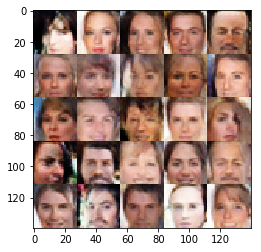

Epoch: 2/3 Discriminator Loss: 1.3549 Generator Loss: 0.7535
Epoch: 2/3 Discriminator Loss: 1.2886 Generator Loss: 0.7755
Epoch: 2/3 Discriminator Loss: 1.2564 Generator Loss: 0.8779
Epoch: 2/3 Discriminator Loss: 1.2564 Generator Loss: 0.8330
Epoch: 2/3 Discriminator Loss: 1.3969 Generator Loss: 0.6569
Epoch: 2/3 Discriminator Loss: 1.2854 Generator Loss: 0.7217
Epoch: 2/3 Discriminator Loss: 1.3826 Generator Loss: 0.8574
Epoch: 2/3 Discriminator Loss: 1.3654 Generator Loss: 0.7010
Epoch: 2/3 Discriminator Loss: 1.2592 Generator Loss: 0.7568
Epoch: 2/3 Discriminator Loss: 1.2900 Generator Loss: 0.8894


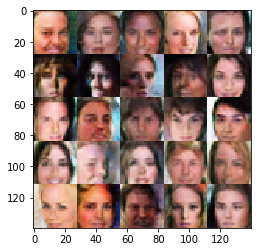

Epoch: 2/3 Discriminator Loss: 1.4197 Generator Loss: 0.6178
Epoch: 2/3 Discriminator Loss: 1.2854 Generator Loss: 0.9728
Epoch: 2/3 Discriminator Loss: 1.3203 Generator Loss: 0.7020
Epoch: 2/3 Discriminator Loss: 1.3259 Generator Loss: 0.7995
Epoch: 2/3 Discriminator Loss: 1.3615 Generator Loss: 0.6762
Epoch: 2/3 Discriminator Loss: 1.3490 Generator Loss: 0.7773
Epoch: 2/3 Discriminator Loss: 1.3140 Generator Loss: 0.7676
Epoch: 2/3 Discriminator Loss: 1.2733 Generator Loss: 0.8542
Epoch: 2/3 Discriminator Loss: 1.3217 Generator Loss: 0.8728
Epoch: 2/3 Discriminator Loss: 1.2982 Generator Loss: 0.8031


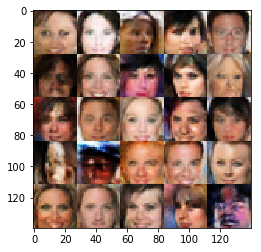

Epoch: 2/3 Discriminator Loss: 1.2920 Generator Loss: 0.7613
Epoch: 2/3 Discriminator Loss: 1.3208 Generator Loss: 0.7645
Epoch: 2/3 Discriminator Loss: 1.3949 Generator Loss: 0.7363
Epoch: 2/3 Discriminator Loss: 1.2958 Generator Loss: 0.7669
Epoch: 2/3 Discriminator Loss: 1.3949 Generator Loss: 0.7760
Epoch: 2/3 Discriminator Loss: 1.3128 Generator Loss: 0.7686
Epoch: 2/3 Discriminator Loss: 1.3021 Generator Loss: 0.7812
Epoch: 2/3 Discriminator Loss: 1.3413 Generator Loss: 0.7991
Epoch: 2/3 Discriminator Loss: 1.2453 Generator Loss: 0.8170
Epoch: 2/3 Discriminator Loss: 1.3567 Generator Loss: 0.6922


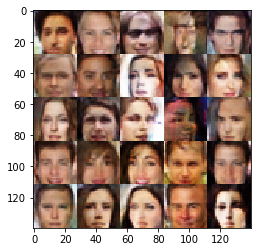

Epoch: 2/3 Discriminator Loss: 1.2780 Generator Loss: 0.7666
Epoch: 2/3 Discriminator Loss: 1.3398 Generator Loss: 0.8428
Epoch: 2/3 Discriminator Loss: 1.3323 Generator Loss: 0.5982
Epoch: 2/3 Discriminator Loss: 1.4124 Generator Loss: 0.8958
Epoch: 2/3 Discriminator Loss: 1.2318 Generator Loss: 0.9047
Epoch: 2/3 Discriminator Loss: 1.2658 Generator Loss: 0.7736
Epoch: 2/3 Discriminator Loss: 1.2611 Generator Loss: 0.8719
Epoch: 2/3 Discriminator Loss: 1.3986 Generator Loss: 0.7208
Epoch: 2/3 Discriminator Loss: 1.3286 Generator Loss: 0.7537
Epoch: 2/3 Discriminator Loss: 1.3145 Generator Loss: 0.7517


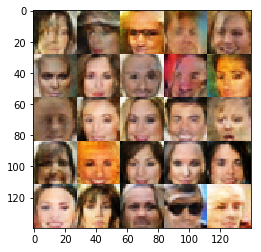

Epoch: 2/3 Discriminator Loss: 1.3605 Generator Loss: 0.7687
Epoch: 2/3 Discriminator Loss: 1.3743 Generator Loss: 0.7088
Epoch: 2/3 Discriminator Loss: 1.2591 Generator Loss: 0.7719
Epoch: 2/3 Discriminator Loss: 1.3078 Generator Loss: 0.8040
Epoch: 2/3 Discriminator Loss: 1.3550 Generator Loss: 0.7327
Epoch: 2/3 Discriminator Loss: 1.2789 Generator Loss: 0.7818
Epoch: 2/3 Discriminator Loss: 1.3320 Generator Loss: 0.7166
Epoch: 2/3 Discriminator Loss: 1.4145 Generator Loss: 0.6463
Epoch: 2/3 Discriminator Loss: 1.3317 Generator Loss: 0.7386
Epoch: 2/3 Discriminator Loss: 1.3798 Generator Loss: 0.6144


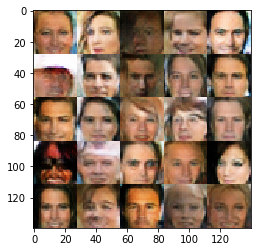

Epoch: 2/3 Discriminator Loss: 1.3250 Generator Loss: 0.7632
Epoch: 2/3 Discriminator Loss: 1.4027 Generator Loss: 0.7064
Epoch: 2/3 Discriminator Loss: 1.3074 Generator Loss: 0.8750
Epoch: 2/3 Discriminator Loss: 1.3339 Generator Loss: 0.7023
Epoch: 2/3 Discriminator Loss: 1.2909 Generator Loss: 0.8469
Epoch: 2/3 Discriminator Loss: 1.3192 Generator Loss: 0.8143
Epoch: 2/3 Discriminator Loss: 1.2487 Generator Loss: 0.7457
Epoch: 2/3 Discriminator Loss: 1.3608 Generator Loss: 0.8573
Epoch: 2/3 Discriminator Loss: 1.3335 Generator Loss: 0.7897
Epoch: 2/3 Discriminator Loss: 1.3562 Generator Loss: 0.7769


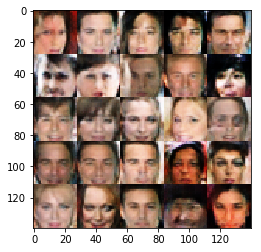

Epoch: 2/3 Discriminator Loss: 1.3239 Generator Loss: 0.7644
Epoch: 2/3 Discriminator Loss: 1.2852 Generator Loss: 0.8566
Epoch: 2/3 Discriminator Loss: 1.3298 Generator Loss: 0.7182
Epoch: 2/3 Discriminator Loss: 1.3450 Generator Loss: 0.7942
Epoch: 2/3 Discriminator Loss: 1.2957 Generator Loss: 0.8313
Epoch: 2/3 Discriminator Loss: 1.2850 Generator Loss: 0.8453
Epoch: 2/3 Discriminator Loss: 1.3944 Generator Loss: 0.6344
Epoch: 2/3 Discriminator Loss: 1.3157 Generator Loss: 0.6822
Epoch: 2/3 Discriminator Loss: 1.3349 Generator Loss: 0.8333
Epoch: 2/3 Discriminator Loss: 1.3276 Generator Loss: 0.8001


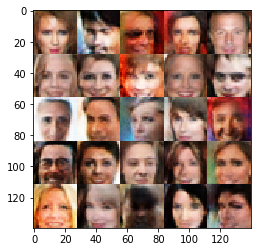

Epoch: 2/3 Discriminator Loss: 1.3179 Generator Loss: 0.7579
Epoch: 2/3 Discriminator Loss: 1.3098 Generator Loss: 0.7073
Epoch: 2/3 Discriminator Loss: 1.3619 Generator Loss: 0.6375
Epoch: 2/3 Discriminator Loss: 1.3343 Generator Loss: 0.7775
Epoch: 2/3 Discriminator Loss: 1.2601 Generator Loss: 0.8259
Epoch: 2/3 Discriminator Loss: 1.3051 Generator Loss: 0.7208
Epoch: 2/3 Discriminator Loss: 1.2825 Generator Loss: 0.8679
Epoch: 2/3 Discriminator Loss: 1.3418 Generator Loss: 0.7170
Epoch: 2/3 Discriminator Loss: 1.3957 Generator Loss: 0.6624
Epoch: 2/3 Discriminator Loss: 1.3141 Generator Loss: 0.7364


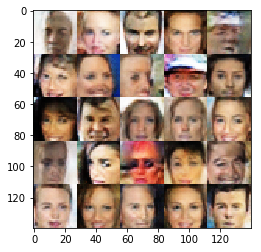

Epoch: 2/3 Discriminator Loss: 1.3122 Generator Loss: 0.7579
Epoch: 2/3 Discriminator Loss: 1.2910 Generator Loss: 0.8459
Epoch: 2/3 Discriminator Loss: 1.3405 Generator Loss: 0.7541
Epoch: 2/3 Discriminator Loss: 1.2984 Generator Loss: 0.7120
Epoch: 2/3 Discriminator Loss: 1.2903 Generator Loss: 0.8168
Epoch: 2/3 Discriminator Loss: 1.2523 Generator Loss: 0.8485
Epoch: 2/3 Discriminator Loss: 1.3582 Generator Loss: 0.7089
Epoch: 2/3 Discriminator Loss: 1.3573 Generator Loss: 0.7652
Epoch: 2/3 Discriminator Loss: 1.3310 Generator Loss: 0.9241
Epoch: 2/3 Discriminator Loss: 1.3588 Generator Loss: 0.6601


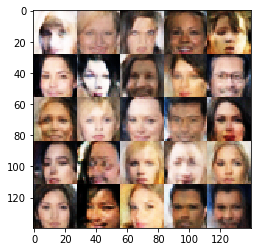

Epoch: 2/3 Discriminator Loss: 1.3723 Generator Loss: 0.7176
Epoch: 2/3 Discriminator Loss: 1.2734 Generator Loss: 0.8530
Epoch: 2/3 Discriminator Loss: 1.2486 Generator Loss: 0.8283
Epoch: 2/3 Discriminator Loss: 1.3322 Generator Loss: 0.7520
Epoch: 2/3 Discriminator Loss: 1.3953 Generator Loss: 0.6054
Epoch: 2/3 Discriminator Loss: 1.2607 Generator Loss: 0.8603
Epoch: 2/3 Discriminator Loss: 1.3088 Generator Loss: 0.7877
Epoch: 2/3 Discriminator Loss: 1.2712 Generator Loss: 0.7797
Epoch: 2/3 Discriminator Loss: 1.3765 Generator Loss: 0.8373
Epoch: 2/3 Discriminator Loss: 1.3055 Generator Loss: 0.7111


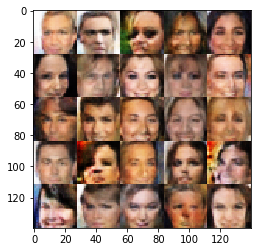

Epoch: 2/3 Discriminator Loss: 1.3486 Generator Loss: 0.9476
Epoch: 2/3 Discriminator Loss: 1.2025 Generator Loss: 0.9931
Epoch: 2/3 Discriminator Loss: 1.4088 Generator Loss: 0.6320
Epoch: 2/3 Discriminator Loss: 1.3425 Generator Loss: 0.7378
Epoch: 2/3 Discriminator Loss: 1.3644 Generator Loss: 0.6897
Epoch: 2/3 Discriminator Loss: 1.3345 Generator Loss: 0.9110
Epoch: 2/3 Discriminator Loss: 1.3565 Generator Loss: 0.6644
Epoch: 2/3 Discriminator Loss: 1.3362 Generator Loss: 0.7312
Epoch: 2/3 Discriminator Loss: 1.4055 Generator Loss: 0.6833
Epoch: 2/3 Discriminator Loss: 1.3021 Generator Loss: 0.7604


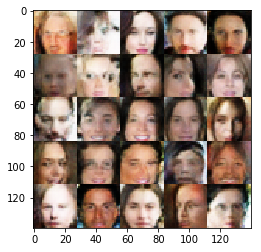

Epoch: 2/3 Discriminator Loss: 1.2750 Generator Loss: 0.8740
Epoch: 2/3 Discriminator Loss: 1.3857 Generator Loss: 0.7306
Epoch: 2/3 Discriminator Loss: 1.2396 Generator Loss: 0.8195
Epoch: 2/3 Discriminator Loss: 1.3482 Generator Loss: 0.6948
Epoch: 2/3 Discriminator Loss: 1.2541 Generator Loss: 0.8389
Epoch: 2/3 Discriminator Loss: 1.4595 Generator Loss: 0.7026
Epoch: 2/3 Discriminator Loss: 1.2767 Generator Loss: 0.8431
Epoch: 2/3 Discriminator Loss: 1.3035 Generator Loss: 0.8356
Epoch: 2/3 Discriminator Loss: 1.3358 Generator Loss: 0.7655
Epoch: 2/3 Discriminator Loss: 1.3261 Generator Loss: 0.7473


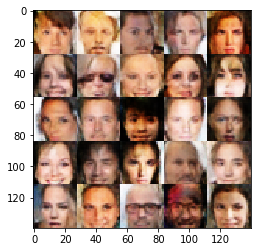

Epoch: 2/3 Discriminator Loss: 1.2274 Generator Loss: 0.8553
Epoch: 2/3 Discriminator Loss: 1.4229 Generator Loss: 0.7069
Epoch: 2/3 Discriminator Loss: 1.2855 Generator Loss: 0.9336
Epoch: 2/3 Discriminator Loss: 1.4537 Generator Loss: 0.6641
Epoch: 2/3 Discriminator Loss: 1.3983 Generator Loss: 0.6192
Epoch: 2/3 Discriminator Loss: 1.1335 Generator Loss: 0.9270
Epoch: 2/3 Discriminator Loss: 1.4085 Generator Loss: 0.6803
Epoch: 2/3 Discriminator Loss: 1.3141 Generator Loss: 0.7998
Epoch: 2/3 Discriminator Loss: 1.3248 Generator Loss: 0.8515
Epoch: 2/3 Discriminator Loss: 1.4294 Generator Loss: 0.7259


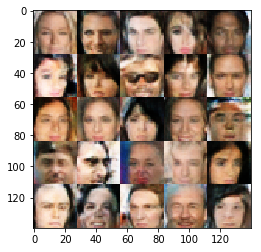

Epoch: 2/3 Discriminator Loss: 1.2622 Generator Loss: 0.7611
Epoch: 2/3 Discriminator Loss: 1.4385 Generator Loss: 0.7550
Epoch: 2/3 Discriminator Loss: 1.3097 Generator Loss: 0.7706
Epoch: 2/3 Discriminator Loss: 1.3045 Generator Loss: 0.7486
Epoch: 2/3 Discriminator Loss: 1.3236 Generator Loss: 0.8212
Epoch: 2/3 Discriminator Loss: 1.2916 Generator Loss: 0.7151
Epoch: 2/3 Discriminator Loss: 1.4288 Generator Loss: 0.7252
Epoch: 2/3 Discriminator Loss: 1.2983 Generator Loss: 0.7235
Epoch: 2/3 Discriminator Loss: 1.3096 Generator Loss: 0.8324
Epoch: 2/3 Discriminator Loss: 1.4220 Generator Loss: 0.6359


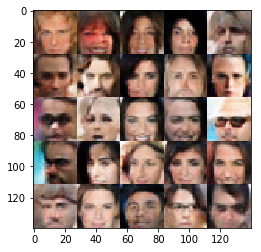

Epoch: 2/3 Discriminator Loss: 1.2984 Generator Loss: 0.8557
Epoch: 2/3 Discriminator Loss: 1.1939 Generator Loss: 0.7796
Epoch: 2/3 Discriminator Loss: 1.3153 Generator Loss: 0.8087
Epoch: 2/3 Discriminator Loss: 1.2986 Generator Loss: 0.8211
Epoch: 2/3 Discriminator Loss: 1.2917 Generator Loss: 0.8940
Epoch: 2/3 Discriminator Loss: 1.2760 Generator Loss: 0.8897
Epoch: 2/3 Discriminator Loss: 1.3848 Generator Loss: 0.7136
Epoch: 2/3 Discriminator Loss: 1.3306 Generator Loss: 0.7751
Epoch: 2/3 Discriminator Loss: 1.3075 Generator Loss: 0.7981
Epoch: 2/3 Discriminator Loss: 1.3548 Generator Loss: 0.6504


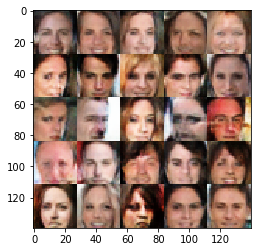

Epoch: 2/3 Discriminator Loss: 1.3316 Generator Loss: 0.8265
Epoch: 2/3 Discriminator Loss: 1.3504 Generator Loss: 0.8577
Epoch: 2/3 Discriminator Loss: 1.2503 Generator Loss: 0.8536
Epoch: 2/3 Discriminator Loss: 1.3300 Generator Loss: 0.7003
Epoch: 2/3 Discriminator Loss: 1.2755 Generator Loss: 0.9157
Epoch: 2/3 Discriminator Loss: 1.3426 Generator Loss: 0.7147
Epoch: 2/3 Discriminator Loss: 1.2926 Generator Loss: 0.9278
Epoch: 2/3 Discriminator Loss: 1.2995 Generator Loss: 0.7409
Epoch: 2/3 Discriminator Loss: 1.2961 Generator Loss: 0.8528
Epoch: 2/3 Discriminator Loss: 1.3138 Generator Loss: 0.7982


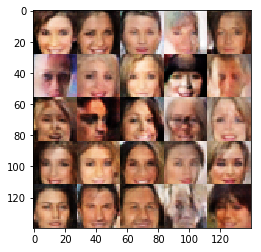

Epoch: 2/3 Discriminator Loss: 1.2921 Generator Loss: 0.8492
Epoch: 2/3 Discriminator Loss: 1.3152 Generator Loss: 0.6341
Epoch: 2/3 Discriminator Loss: 1.2909 Generator Loss: 0.8509
Epoch: 2/3 Discriminator Loss: 1.2101 Generator Loss: 0.8724
Epoch: 2/3 Discriminator Loss: 1.3619 Generator Loss: 0.7342
Epoch: 2/3 Discriminator Loss: 1.3290 Generator Loss: 0.6126
Epoch: 2/3 Discriminator Loss: 1.2736 Generator Loss: 0.8465
Epoch: 2/3 Discriminator Loss: 1.2866 Generator Loss: 0.7203
Epoch: 2/3 Discriminator Loss: 1.3529 Generator Loss: 0.7649
Epoch: 2/3 Discriminator Loss: 1.4196 Generator Loss: 0.7040


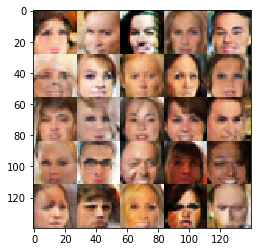

Epoch: 2/3 Discriminator Loss: 1.3017 Generator Loss: 0.9536
Epoch: 2/3 Discriminator Loss: 1.3199 Generator Loss: 0.8524
Epoch: 2/3 Discriminator Loss: 1.4082 Generator Loss: 0.5999
Epoch: 2/3 Discriminator Loss: 1.3273 Generator Loss: 0.7656
Epoch: 2/3 Discriminator Loss: 1.3026 Generator Loss: 0.8254
Epoch: 2/3 Discriminator Loss: 1.3099 Generator Loss: 0.6799
Epoch: 2/3 Discriminator Loss: 1.2653 Generator Loss: 0.8320
Epoch: 2/3 Discriminator Loss: 1.4124 Generator Loss: 0.6451
Epoch: 2/3 Discriminator Loss: 1.1197 Generator Loss: 0.9205
Epoch: 2/3 Discriminator Loss: 1.3816 Generator Loss: 0.7096


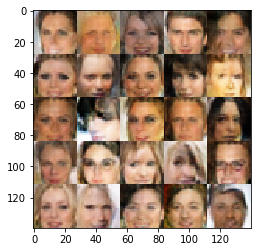

Epoch: 2/3 Discriminator Loss: 1.3302 Generator Loss: 0.7304
Epoch: 2/3 Discriminator Loss: 1.2338 Generator Loss: 0.8443
Epoch: 2/3 Discriminator Loss: 1.2812 Generator Loss: 0.8492
Epoch: 2/3 Discriminator Loss: 1.4296 Generator Loss: 0.6676
Epoch: 2/3 Discriminator Loss: 1.3976 Generator Loss: 0.7133
Epoch: 2/3 Discriminator Loss: 1.2763 Generator Loss: 0.9816
Epoch: 2/3 Discriminator Loss: 1.3393 Generator Loss: 0.7490
Epoch: 2/3 Discriminator Loss: 1.2589 Generator Loss: 0.7563
Epoch: 2/3 Discriminator Loss: 1.3752 Generator Loss: 0.7108
Epoch: 2/3 Discriminator Loss: 1.3987 Generator Loss: 0.7028


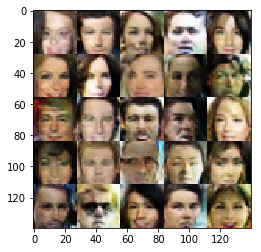

Epoch: 2/3 Discriminator Loss: 1.3793 Generator Loss: 0.6950
Epoch: 2/3 Discriminator Loss: 1.2919 Generator Loss: 0.7072
Epoch: 2/3 Discriminator Loss: 1.3914 Generator Loss: 0.7471
Epoch: 2/3 Discriminator Loss: 1.2127 Generator Loss: 0.8060
Epoch: 2/3 Discriminator Loss: 1.3214 Generator Loss: 0.7894
Epoch: 2/3 Discriminator Loss: 1.3517 Generator Loss: 0.8346
Epoch: 2/3 Discriminator Loss: 1.3871 Generator Loss: 0.8219
Epoch: 2/3 Discriminator Loss: 1.2843 Generator Loss: 0.7378
Epoch: 2/3 Discriminator Loss: 1.3813 Generator Loss: 0.8040
Epoch: 2/3 Discriminator Loss: 1.2351 Generator Loss: 0.8731


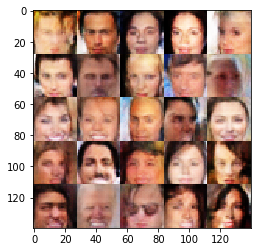

Epoch: 2/3 Discriminator Loss: 1.2974 Generator Loss: 0.8337
Epoch: 2/3 Discriminator Loss: 1.3444 Generator Loss: 0.7519
Epoch: 2/3 Discriminator Loss: 1.3411 Generator Loss: 0.6972
Epoch: 2/3 Discriminator Loss: 1.3434 Generator Loss: 0.7772
Epoch: 2/3 Discriminator Loss: 1.3121 Generator Loss: 0.7969
Epoch: 2/3 Discriminator Loss: 1.2194 Generator Loss: 0.9213
Epoch: 2/3 Discriminator Loss: 1.2161 Generator Loss: 0.8783
Epoch: 2/3 Discriminator Loss: 1.2628 Generator Loss: 0.8737
Epoch: 2/3 Discriminator Loss: 1.2572 Generator Loss: 0.9275
Epoch: 2/3 Discriminator Loss: 1.2984 Generator Loss: 0.8929


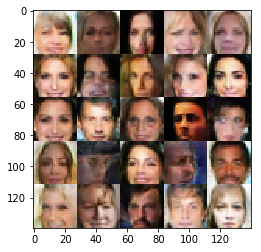

Epoch: 2/3 Discriminator Loss: 1.2700 Generator Loss: 0.8850
Epoch: 2/3 Discriminator Loss: 1.2830 Generator Loss: 0.7986
Epoch: 2/3 Discriminator Loss: 1.2711 Generator Loss: 0.6693
Epoch: 2/3 Discriminator Loss: 1.2330 Generator Loss: 0.8476
Epoch: 2/3 Discriminator Loss: 1.3126 Generator Loss: 0.7493
Epoch: 2/3 Discriminator Loss: 1.2516 Generator Loss: 0.8416
Epoch: 2/3 Discriminator Loss: 1.3716 Generator Loss: 0.7630
Epoch: 2/3 Discriminator Loss: 1.2416 Generator Loss: 0.8198
Epoch: 2/3 Discriminator Loss: 1.3533 Generator Loss: 0.6813
Epoch: 2/3 Discriminator Loss: 1.3292 Generator Loss: 0.8448


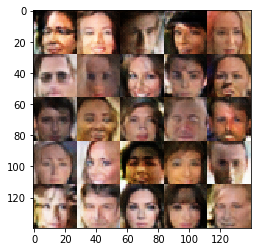

Epoch: 2/3 Discriminator Loss: 1.2943 Generator Loss: 0.8390
Epoch: 2/3 Discriminator Loss: 1.3943 Generator Loss: 0.7183
Epoch: 2/3 Discriminator Loss: 1.3100 Generator Loss: 0.7697
Epoch: 2/3 Discriminator Loss: 1.2089 Generator Loss: 0.9109
Epoch: 2/3 Discriminator Loss: 1.2492 Generator Loss: 0.9074
Epoch: 2/3 Discriminator Loss: 1.3579 Generator Loss: 0.6756
Epoch: 2/3 Discriminator Loss: 1.3381 Generator Loss: 0.8007
Epoch: 2/3 Discriminator Loss: 1.4020 Generator Loss: 0.6304
Epoch: 2/3 Discriminator Loss: 1.2627 Generator Loss: 0.8195
Epoch: 2/3 Discriminator Loss: 1.2144 Generator Loss: 0.8681


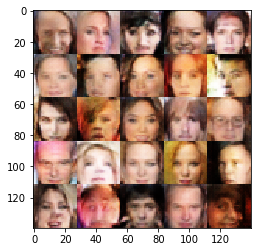

Epoch: 2/3 Discriminator Loss: 1.3431 Generator Loss: 0.8464
Epoch: 2/3 Discriminator Loss: 1.4027 Generator Loss: 0.6225
Epoch: 2/3 Discriminator Loss: 1.3919 Generator Loss: 0.7188
Epoch: 2/3 Discriminator Loss: 1.4639 Generator Loss: 0.6007
Epoch: 2/3 Discriminator Loss: 1.3057 Generator Loss: 0.7503
Epoch: 2/3 Discriminator Loss: 1.3228 Generator Loss: 0.7466
Epoch: 2/3 Discriminator Loss: 1.1615 Generator Loss: 1.0289
Epoch: 2/3 Discriminator Loss: 1.2583 Generator Loss: 0.8306
Epoch: 2/3 Discriminator Loss: 1.3337 Generator Loss: 0.7966
Epoch: 2/3 Discriminator Loss: 1.2710 Generator Loss: 0.8645


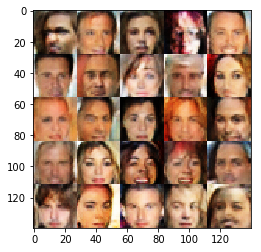

Epoch: 2/3 Discriminator Loss: 1.2798 Generator Loss: 0.7234
Epoch: 2/3 Discriminator Loss: 1.3364 Generator Loss: 0.8127
Epoch: 2/3 Discriminator Loss: 1.3041 Generator Loss: 0.7183
Epoch: 2/3 Discriminator Loss: 1.4035 Generator Loss: 0.7297
Epoch: 2/3 Discriminator Loss: 1.3592 Generator Loss: 0.6559
Epoch: 2/3 Discriminator Loss: 1.3415 Generator Loss: 0.7929
Epoch: 2/3 Discriminator Loss: 1.1584 Generator Loss: 0.9043
Epoch: 2/3 Discriminator Loss: 1.4479 Generator Loss: 0.6911
Epoch: 2/3 Discriminator Loss: 1.2778 Generator Loss: 0.8206
Epoch: 2/3 Discriminator Loss: 1.2353 Generator Loss: 0.8220


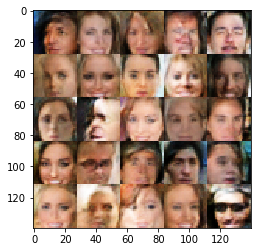

Epoch: 2/3 Discriminator Loss: 1.3232 Generator Loss: 0.8538
Epoch: 2/3 Discriminator Loss: 1.2854 Generator Loss: 0.9430
Epoch: 2/3 Discriminator Loss: 1.3647 Generator Loss: 0.7898
Epoch: 2/3 Discriminator Loss: 1.1778 Generator Loss: 0.9844
Epoch: 2/3 Discriminator Loss: 1.2731 Generator Loss: 0.8229
Epoch: 2/3 Discriminator Loss: 1.3842 Generator Loss: 0.6765
Epoch: 2/3 Discriminator Loss: 1.2135 Generator Loss: 0.8607
Epoch: 2/3 Discriminator Loss: 1.4756 Generator Loss: 0.5292
Epoch: 2/3 Discriminator Loss: 1.2362 Generator Loss: 0.8235
Epoch: 2/3 Discriminator Loss: 1.4025 Generator Loss: 0.6666


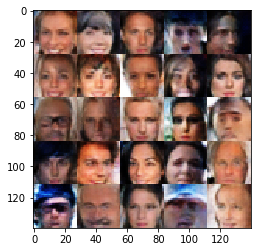

Epoch: 2/3 Discriminator Loss: 1.3451 Generator Loss: 0.7535
Epoch: 2/3 Discriminator Loss: 1.4143 Generator Loss: 0.6177
Epoch: 2/3 Discriminator Loss: 1.4146 Generator Loss: 0.7597
Epoch: 2/3 Discriminator Loss: 1.3416 Generator Loss: 0.7834
Epoch: 2/3 Discriminator Loss: 1.4634 Generator Loss: 0.5824
Epoch: 2/3 Discriminator Loss: 1.2565 Generator Loss: 0.8177
Epoch: 2/3 Discriminator Loss: 1.3791 Generator Loss: 0.7146
Epoch: 2/3 Discriminator Loss: 1.2405 Generator Loss: 0.8790
Epoch: 2/3 Discriminator Loss: 1.3388 Generator Loss: 0.7917
Epoch: 2/3 Discriminator Loss: 1.3328 Generator Loss: 0.7276


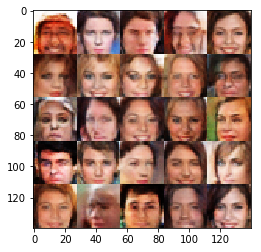

Epoch: 2/3 Discriminator Loss: 1.2936 Generator Loss: 0.7686
Epoch: 2/3 Discriminator Loss: 1.3001 Generator Loss: 0.8534
Epoch: 2/3 Discriminator Loss: 1.3295 Generator Loss: 0.8032
Epoch: 2/3 Discriminator Loss: 1.2319 Generator Loss: 0.8400
Epoch: 2/3 Discriminator Loss: 1.3590 Generator Loss: 0.7817
Epoch: 2/3 Discriminator Loss: 1.2984 Generator Loss: 0.8425
Epoch: 2/3 Discriminator Loss: 1.2638 Generator Loss: 0.8448
Epoch: 2/3 Discriminator Loss: 1.3202 Generator Loss: 0.8213
Epoch: 2/3 Discriminator Loss: 1.3498 Generator Loss: 0.7293
Epoch: 2/3 Discriminator Loss: 1.3078 Generator Loss: 0.6988


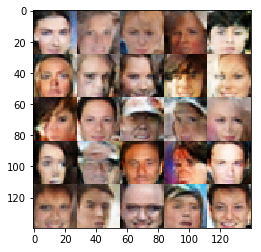

Epoch: 2/3 Discriminator Loss: 1.4230 Generator Loss: 0.6842
Epoch: 2/3 Discriminator Loss: 1.2686 Generator Loss: 0.7935
Epoch: 2/3 Discriminator Loss: 1.3045 Generator Loss: 0.8620
Epoch: 2/3 Discriminator Loss: 1.1915 Generator Loss: 0.8822
Epoch: 2/3 Discriminator Loss: 1.3578 Generator Loss: 0.7344
Epoch: 2/3 Discriminator Loss: 1.2158 Generator Loss: 0.9848
Epoch: 2/3 Discriminator Loss: 1.2013 Generator Loss: 0.8782
Epoch: 2/3 Discriminator Loss: 1.3742 Generator Loss: 0.6637
Epoch: 2/3 Discriminator Loss: 1.2967 Generator Loss: 0.7912
Epoch: 2/3 Discriminator Loss: 1.3490 Generator Loss: 0.7503


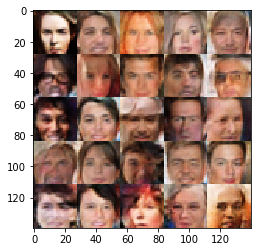

Epoch: 2/3 Discriminator Loss: 1.4256 Generator Loss: 0.6791
Epoch: 2/3 Discriminator Loss: 1.3751 Generator Loss: 0.6665
Epoch: 2/3 Discriminator Loss: 1.3436 Generator Loss: 0.7264
Epoch: 2/3 Discriminator Loss: 1.2609 Generator Loss: 0.7245
Epoch: 2/3 Discriminator Loss: 1.2100 Generator Loss: 0.8720
Epoch: 2/3 Discriminator Loss: 1.5895 Generator Loss: 0.5404
Epoch: 2/3 Discriminator Loss: 1.3176 Generator Loss: 1.0408
Epoch: 2/3 Discriminator Loss: 1.3404 Generator Loss: 0.7735
Epoch: 2/3 Discriminator Loss: 1.3931 Generator Loss: 0.6151
Epoch: 2/3 Discriminator Loss: 1.4122 Generator Loss: 0.6706


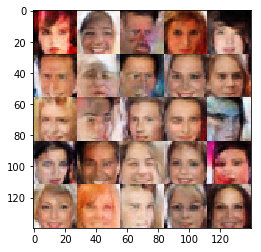

Epoch: 2/3 Discriminator Loss: 1.3893 Generator Loss: 0.6873
Epoch: 2/3 Discriminator Loss: 1.4232 Generator Loss: 0.6293
Epoch: 2/3 Discriminator Loss: 1.3044 Generator Loss: 0.7983
Epoch: 2/3 Discriminator Loss: 1.3364 Generator Loss: 0.6735
Epoch: 2/3 Discriminator Loss: 1.2770 Generator Loss: 0.8172
Epoch: 2/3 Discriminator Loss: 1.4186 Generator Loss: 0.8112
Epoch: 2/3 Discriminator Loss: 1.2950 Generator Loss: 0.8227
Epoch: 2/3 Discriminator Loss: 1.3716 Generator Loss: 0.6907
Epoch: 2/3 Discriminator Loss: 1.4003 Generator Loss: 0.6499
Epoch: 2/3 Discriminator Loss: 1.2993 Generator Loss: 0.9064


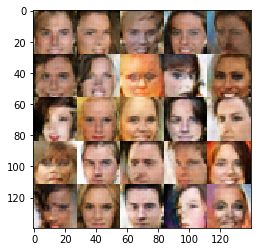

Epoch: 2/3 Discriminator Loss: 1.3441 Generator Loss: 0.8285
Epoch: 2/3 Discriminator Loss: 1.3527 Generator Loss: 0.6302
Epoch: 2/3 Discriminator Loss: 1.2928 Generator Loss: 0.7395
Epoch: 2/3 Discriminator Loss: 1.4101 Generator Loss: 0.6378
Epoch: 2/3 Discriminator Loss: 1.3536 Generator Loss: 0.7163
Epoch: 2/3 Discriminator Loss: 1.4175 Generator Loss: 0.8019
Epoch: 2/3 Discriminator Loss: 1.3140 Generator Loss: 0.8168
Epoch: 2/3 Discriminator Loss: 1.5059 Generator Loss: 0.6503
Epoch: 2/3 Discriminator Loss: 1.3285 Generator Loss: 0.7315
Epoch: 2/3 Discriminator Loss: 1.3603 Generator Loss: 0.8246


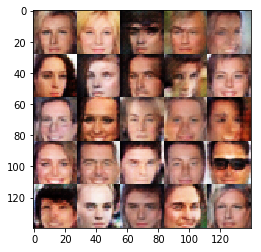

Epoch: 2/3 Discriminator Loss: 1.3930 Generator Loss: 0.7582
Epoch: 2/3 Discriminator Loss: 1.2588 Generator Loss: 0.8040
Epoch: 2/3 Discriminator Loss: 1.3270 Generator Loss: 0.7300
Epoch: 2/3 Discriminator Loss: 1.3740 Generator Loss: 0.6539
Epoch: 2/3 Discriminator Loss: 1.3572 Generator Loss: 0.7563
Epoch: 2/3 Discriminator Loss: 1.4495 Generator Loss: 0.6503
Epoch: 2/3 Discriminator Loss: 1.3177 Generator Loss: 0.7336
Epoch: 2/3 Discriminator Loss: 1.3093 Generator Loss: 0.8538
Epoch: 2/3 Discriminator Loss: 1.3291 Generator Loss: 0.7595
Epoch: 2/3 Discriminator Loss: 1.4302 Generator Loss: 0.7042


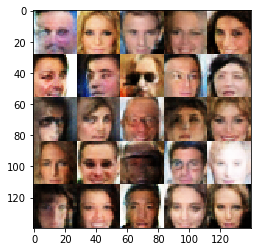

Epoch: 2/3 Discriminator Loss: 1.3055 Generator Loss: 0.7524
Epoch: 2/3 Discriminator Loss: 1.3173 Generator Loss: 0.8827
Epoch: 2/3 Discriminator Loss: 1.2991 Generator Loss: 0.9026
Epoch: 2/3 Discriminator Loss: 1.2233 Generator Loss: 0.9058
Epoch: 2/3 Discriminator Loss: 1.3586 Generator Loss: 0.7309
Epoch: 2/3 Discriminator Loss: 1.3529 Generator Loss: 0.7479
Epoch: 2/3 Discriminator Loss: 1.4116 Generator Loss: 0.7076
Epoch: 2/3 Discriminator Loss: 1.3207 Generator Loss: 0.7396
Epoch: 2/3 Discriminator Loss: 1.2520 Generator Loss: 0.7990
Epoch: 2/3 Discriminator Loss: 1.2650 Generator Loss: 0.8762


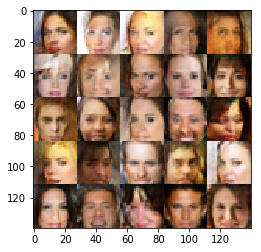

Epoch: 2/3 Discriminator Loss: 1.4451 Generator Loss: 0.6145
Epoch: 2/3 Discriminator Loss: 1.2943 Generator Loss: 0.7106
Epoch: 2/3 Discriminator Loss: 1.2670 Generator Loss: 0.7679
Epoch: 2/3 Discriminator Loss: 1.3875 Generator Loss: 0.7554
Epoch: 2/3 Discriminator Loss: 1.1700 Generator Loss: 0.9196
Epoch: 2/3 Discriminator Loss: 1.3928 Generator Loss: 0.6788
Epoch: 2/3 Discriminator Loss: 1.2442 Generator Loss: 0.8346
Epoch: 2/3 Discriminator Loss: 1.3253 Generator Loss: 0.7731
Epoch: 2/3 Discriminator Loss: 1.2868 Generator Loss: 0.7945
Epoch: 2/3 Discriminator Loss: 1.3063 Generator Loss: 0.8375


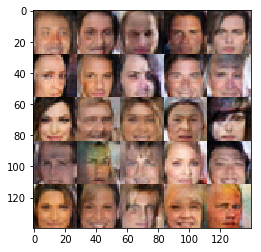

Epoch: 2/3 Discriminator Loss: 1.3278 Generator Loss: 0.8187
Epoch: 2/3 Discriminator Loss: 1.4185 Generator Loss: 0.6945
Epoch: 2/3 Discriminator Loss: 1.3595 Generator Loss: 0.8488
Epoch: 2/3 Discriminator Loss: 1.2597 Generator Loss: 0.8315
Epoch: 2/3 Discriminator Loss: 1.4251 Generator Loss: 0.6238
Epoch: 2/3 Discriminator Loss: 1.2628 Generator Loss: 0.8385
Epoch: 2/3 Discriminator Loss: 1.3509 Generator Loss: 0.7302
Epoch: 2/3 Discriminator Loss: 1.3605 Generator Loss: 0.8494
Epoch: 2/3 Discriminator Loss: 1.4266 Generator Loss: 0.7277
Epoch: 2/3 Discriminator Loss: 1.3258 Generator Loss: 0.8137


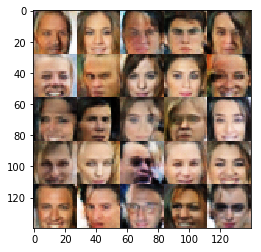

Epoch: 2/3 Discriminator Loss: 1.3558 Generator Loss: 0.7322
Epoch: 2/3 Discriminator Loss: 1.3503 Generator Loss: 0.7501
Epoch: 2/3 Discriminator Loss: 1.3673 Generator Loss: 0.7179
Epoch: 2/3 Discriminator Loss: 1.2849 Generator Loss: 0.8222
Epoch: 2/3 Discriminator Loss: 1.2878 Generator Loss: 0.8001
Epoch: 2/3 Discriminator Loss: 1.2428 Generator Loss: 0.8768
Epoch: 2/3 Discriminator Loss: 1.3151 Generator Loss: 0.7241
Epoch: 2/3 Discriminator Loss: 1.3009 Generator Loss: 0.7359
Epoch: 2/3 Discriminator Loss: 1.3212 Generator Loss: 0.7915
Epoch: 2/3 Discriminator Loss: 1.2562 Generator Loss: 0.8392


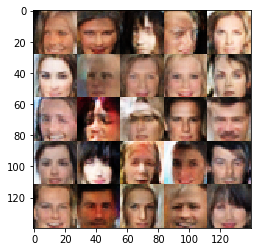

Epoch: 2/3 Discriminator Loss: 1.2357 Generator Loss: 0.8661
Epoch: 2/3 Discriminator Loss: 1.3818 Generator Loss: 0.8331
Epoch: 2/3 Discriminator Loss: 1.2720 Generator Loss: 0.7813
Epoch: 2/3 Discriminator Loss: 1.2882 Generator Loss: 0.8201
Epoch: 2/3 Discriminator Loss: 1.2220 Generator Loss: 0.8761
Epoch: 2/3 Discriminator Loss: 1.2711 Generator Loss: 0.7744
Epoch: 2/3 Discriminator Loss: 1.2760 Generator Loss: 0.7793
Epoch: 2/3 Discriminator Loss: 1.3779 Generator Loss: 0.7811
Epoch: 2/3 Discriminator Loss: 1.3426 Generator Loss: 0.6726
Epoch: 2/3 Discriminator Loss: 1.3450 Generator Loss: 0.7701


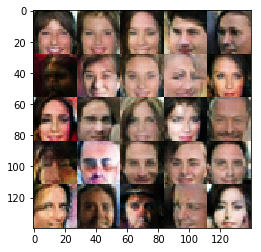

Epoch: 2/3 Discriminator Loss: 1.3750 Generator Loss: 0.6821
Epoch: 2/3 Discriminator Loss: 1.2673 Generator Loss: 0.8246
Epoch: 2/3 Discriminator Loss: 1.3192 Generator Loss: 0.7285
Epoch: 2/3 Discriminator Loss: 1.4863 Generator Loss: 0.6364
Epoch: 2/3 Discriminator Loss: 1.2478 Generator Loss: 0.8178
Epoch: 2/3 Discriminator Loss: 1.3015 Generator Loss: 0.7179
Epoch: 2/3 Discriminator Loss: 1.3449 Generator Loss: 0.7551
Epoch: 2/3 Discriminator Loss: 1.3087 Generator Loss: 0.8050
Epoch: 2/3 Discriminator Loss: 1.3639 Generator Loss: 0.7894
Epoch: 2/3 Discriminator Loss: 1.3372 Generator Loss: 0.8675


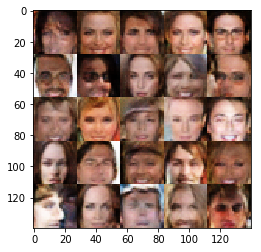

Epoch: 2/3 Discriminator Loss: 1.3384 Generator Loss: 0.6969
Epoch: 2/3 Discriminator Loss: 1.3086 Generator Loss: 0.7964
Epoch: 2/3 Discriminator Loss: 1.3605 Generator Loss: 0.7982
Epoch: 2/3 Discriminator Loss: 1.2488 Generator Loss: 0.8967
Epoch: 2/3 Discriminator Loss: 1.2839 Generator Loss: 0.8378
Epoch: 2/3 Discriminator Loss: 1.3081 Generator Loss: 0.7820
Epoch: 2/3 Discriminator Loss: 1.3062 Generator Loss: 0.7845
Epoch: 2/3 Discriminator Loss: 1.2946 Generator Loss: 0.8014
Epoch: 2/3 Discriminator Loss: 1.2950 Generator Loss: 0.7454
Epoch: 2/3 Discriminator Loss: 1.2536 Generator Loss: 0.7207


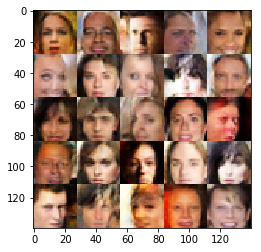

Epoch: 2/3 Discriminator Loss: 1.3891 Generator Loss: 0.7185
Epoch: 2/3 Discriminator Loss: 1.2825 Generator Loss: 0.8142
Epoch: 2/3 Discriminator Loss: 1.3254 Generator Loss: 0.7658
Epoch: 2/3 Discriminator Loss: 1.3118 Generator Loss: 0.7903
Epoch: 2/3 Discriminator Loss: 1.3130 Generator Loss: 0.7989
Epoch: 2/3 Discriminator Loss: 1.4230 Generator Loss: 0.6288
Epoch: 2/3 Discriminator Loss: 1.2955 Generator Loss: 0.7387
Epoch: 2/3 Discriminator Loss: 1.3068 Generator Loss: 0.7675
Epoch: 2/3 Discriminator Loss: 1.3291 Generator Loss: 0.7947
Epoch: 2/3 Discriminator Loss: 1.2795 Generator Loss: 0.7928


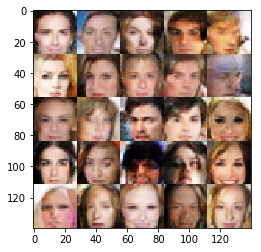

Epoch: 2/3 Discriminator Loss: 1.3720 Generator Loss: 0.6969
Epoch: 2/3 Discriminator Loss: 1.3897 Generator Loss: 0.8267
Epoch: 2/3 Discriminator Loss: 1.3757 Generator Loss: 0.7197
Epoch: 2/3 Discriminator Loss: 1.3386 Generator Loss: 0.8071
Epoch: 2/3 Discriminator Loss: 1.2049 Generator Loss: 0.8085
Epoch: 2/3 Discriminator Loss: 1.3613 Generator Loss: 0.6132
Epoch: 2/3 Discriminator Loss: 1.2435 Generator Loss: 0.9381
Epoch: 2/3 Discriminator Loss: 1.3122 Generator Loss: 0.7368
Epoch: 2/3 Discriminator Loss: 1.1901 Generator Loss: 0.8937
Epoch: 2/3 Discriminator Loss: 1.3541 Generator Loss: 0.7163


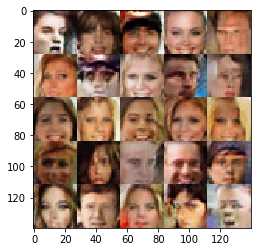

Epoch: 2/3 Discriminator Loss: 1.2718 Generator Loss: 0.7748
Epoch: 2/3 Discriminator Loss: 1.2575 Generator Loss: 0.8362
Epoch: 2/3 Discriminator Loss: 1.2915 Generator Loss: 0.8920
Epoch: 2/3 Discriminator Loss: 1.4044 Generator Loss: 0.6504
Epoch: 2/3 Discriminator Loss: 1.1955 Generator Loss: 0.8703
Epoch: 2/3 Discriminator Loss: 1.2109 Generator Loss: 1.1682
Epoch: 2/3 Discriminator Loss: 1.3639 Generator Loss: 0.9134
Epoch: 2/3 Discriminator Loss: 1.3526 Generator Loss: 0.7136
Epoch: 2/3 Discriminator Loss: 1.3261 Generator Loss: 0.7557
Epoch: 2/3 Discriminator Loss: 1.3326 Generator Loss: 0.7258


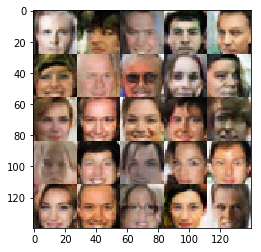

Epoch: 2/3 Discriminator Loss: 1.2894 Generator Loss: 0.8491
Epoch: 2/3 Discriminator Loss: 1.3131 Generator Loss: 0.7380
Epoch: 2/3 Discriminator Loss: 1.3979 Generator Loss: 0.7995
Epoch: 2/3 Discriminator Loss: 1.3193 Generator Loss: 0.7569
Epoch: 2/3 Discriminator Loss: 1.2603 Generator Loss: 0.8269
Epoch: 2/3 Discriminator Loss: 1.2859 Generator Loss: 0.8550
Epoch: 2/3 Discriminator Loss: 1.3219 Generator Loss: 0.7120
Epoch: 2/3 Discriminator Loss: 1.3664 Generator Loss: 0.7508
Epoch: 2/3 Discriminator Loss: 1.3179 Generator Loss: 0.8031
Epoch: 2/3 Discriminator Loss: 1.2702 Generator Loss: 0.7962


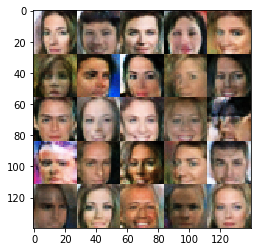

Epoch: 2/3 Discriminator Loss: 1.3143 Generator Loss: 0.7194
Epoch: 2/3 Discriminator Loss: 1.3375 Generator Loss: 0.7283
Epoch: 2/3 Discriminator Loss: 1.3196 Generator Loss: 0.7931
Epoch: 2/3 Discriminator Loss: 1.2780 Generator Loss: 0.8048
Epoch: 2/3 Discriminator Loss: 1.3423 Generator Loss: 0.8342
Epoch: 2/3 Discriminator Loss: 1.3035 Generator Loss: 0.7558
Epoch: 2/3 Discriminator Loss: 1.3695 Generator Loss: 0.7932
Epoch: 2/3 Discriminator Loss: 1.4359 Generator Loss: 0.6882
Epoch: 2/3 Discriminator Loss: 1.3449 Generator Loss: 0.8300
Epoch: 2/3 Discriminator Loss: 1.4069 Generator Loss: 0.7049


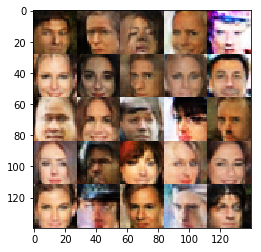

Epoch: 2/3 Discriminator Loss: 1.2764 Generator Loss: 0.9532
Epoch: 2/3 Discriminator Loss: 1.3638 Generator Loss: 0.7267
Epoch: 2/3 Discriminator Loss: 1.3668 Generator Loss: 0.6805
Epoch: 2/3 Discriminator Loss: 1.2118 Generator Loss: 0.8727
Epoch: 2/3 Discriminator Loss: 1.2164 Generator Loss: 0.9111
Epoch: 2/3 Discriminator Loss: 1.3314 Generator Loss: 0.7622
Epoch: 2/3 Discriminator Loss: 1.1936 Generator Loss: 0.9500
Epoch: 2/3 Discriminator Loss: 1.3650 Generator Loss: 0.6337
Epoch: 2/3 Discriminator Loss: 1.3483 Generator Loss: 0.7767
Epoch: 2/3 Discriminator Loss: 1.3026 Generator Loss: 0.7650


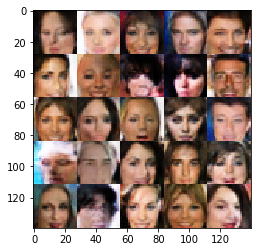

Epoch: 2/3 Discriminator Loss: 1.3072 Generator Loss: 0.9032
Epoch: 2/3 Discriminator Loss: 1.1895 Generator Loss: 0.8600
Epoch: 2/3 Discriminator Loss: 1.4378 Generator Loss: 0.8013
Epoch: 2/3 Discriminator Loss: 1.2649 Generator Loss: 0.7624
Epoch: 2/3 Discriminator Loss: 1.2829 Generator Loss: 0.7696
Epoch: 2/3 Discriminator Loss: 1.4184 Generator Loss: 0.7094
Epoch: 2/3 Discriminator Loss: 1.4436 Generator Loss: 0.6575
Epoch: 2/3 Discriminator Loss: 1.2632 Generator Loss: 0.8573
Epoch: 2/3 Discriminator Loss: 1.4381 Generator Loss: 0.7421
Epoch: 2/3 Discriminator Loss: 1.2812 Generator Loss: 0.7903


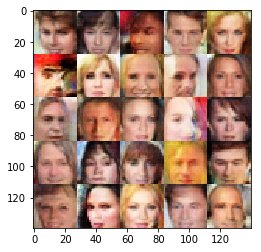

Epoch: 2/3 Discriminator Loss: 1.4028 Generator Loss: 0.7768
Epoch: 2/3 Discriminator Loss: 1.2630 Generator Loss: 0.8410
Epoch: 2/3 Discriminator Loss: 1.3230 Generator Loss: 0.7909
Epoch: 2/3 Discriminator Loss: 1.3189 Generator Loss: 0.8109
Epoch: 2/3 Discriminator Loss: 1.2526 Generator Loss: 0.8128
Epoch: 2/3 Discriminator Loss: 1.3141 Generator Loss: 0.7713
Epoch: 2/3 Discriminator Loss: 1.3594 Generator Loss: 0.8028
Epoch: 2/3 Discriminator Loss: 1.4215 Generator Loss: 0.7188
Epoch: 2/3 Discriminator Loss: 1.3260 Generator Loss: 0.7678
Epoch: 2/3 Discriminator Loss: 1.2985 Generator Loss: 0.7916


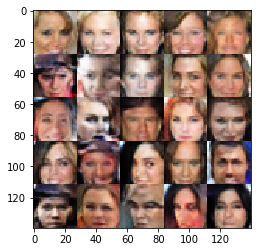

Epoch: 2/3 Discriminator Loss: 1.3381 Generator Loss: 0.8299
Epoch: 2/3 Discriminator Loss: 1.3086 Generator Loss: 0.7788
Epoch: 2/3 Discriminator Loss: 1.2963 Generator Loss: 0.7379
Epoch: 2/3 Discriminator Loss: 1.2922 Generator Loss: 0.7878
Epoch: 2/3 Discriminator Loss: 1.3264 Generator Loss: 0.7796
Epoch: 2/3 Discriminator Loss: 1.3618 Generator Loss: 0.6932
Epoch: 2/3 Discriminator Loss: 1.3852 Generator Loss: 0.6901
Epoch: 2/3 Discriminator Loss: 1.3199 Generator Loss: 0.7706
Epoch: 2/3 Discriminator Loss: 1.3163 Generator Loss: 0.7600
Epoch: 2/3 Discriminator Loss: 1.3233 Generator Loss: 0.7881


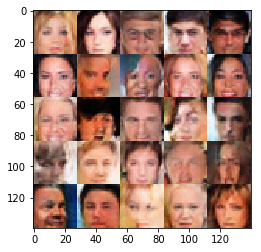

Epoch: 2/3 Discriminator Loss: 1.3658 Generator Loss: 0.6846
Epoch: 2/3 Discriminator Loss: 1.3519 Generator Loss: 0.6873
Epoch: 2/3 Discriminator Loss: 1.3155 Generator Loss: 0.6780
Epoch: 2/3 Discriminator Loss: 1.4496 Generator Loss: 0.7746
Epoch: 2/3 Discriminator Loss: 1.2936 Generator Loss: 0.8295
Epoch: 2/3 Discriminator Loss: 1.3963 Generator Loss: 0.7339
Epoch: 2/3 Discriminator Loss: 1.3177 Generator Loss: 0.7043
Epoch: 2/3 Discriminator Loss: 1.2350 Generator Loss: 0.8989
Epoch: 2/3 Discriminator Loss: 1.2825 Generator Loss: 0.9293
Epoch: 2/3 Discriminator Loss: 1.3488 Generator Loss: 0.8093


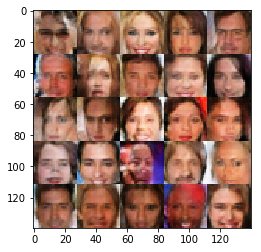

Epoch: 2/3 Discriminator Loss: 1.2778 Generator Loss: 0.9661
Epoch: 2/3 Discriminator Loss: 1.3434 Generator Loss: 0.7071
Epoch: 2/3 Discriminator Loss: 1.3132 Generator Loss: 0.8337
Epoch: 2/3 Discriminator Loss: 1.2996 Generator Loss: 0.8273
Epoch: 2/3 Discriminator Loss: 1.4551 Generator Loss: 0.7394
Epoch: 2/3 Discriminator Loss: 1.3396 Generator Loss: 0.7608
Epoch: 2/3 Discriminator Loss: 1.3432 Generator Loss: 0.7612
Epoch: 2/3 Discriminator Loss: 1.2907 Generator Loss: 0.7353
Epoch: 2/3 Discriminator Loss: 1.2717 Generator Loss: 0.7111
Epoch: 2/3 Discriminator Loss: 1.3214 Generator Loss: 0.7516


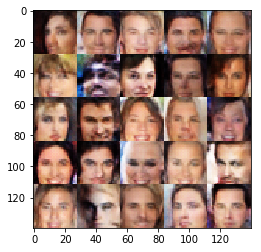

Epoch: 2/3 Discriminator Loss: 1.4102 Generator Loss: 0.7777
Epoch: 2/3 Discriminator Loss: 1.3764 Generator Loss: 0.6727
Epoch: 2/3 Discriminator Loss: 1.2225 Generator Loss: 0.9409
Epoch: 2/3 Discriminator Loss: 1.4030 Generator Loss: 0.6607
Epoch: 2/3 Discriminator Loss: 1.2876 Generator Loss: 0.9262
Epoch: 2/3 Discriminator Loss: 1.3863 Generator Loss: 0.7415
Epoch: 2/3 Discriminator Loss: 1.3117 Generator Loss: 0.7769
Epoch: 2/3 Discriminator Loss: 1.3238 Generator Loss: 0.8482
Epoch: 2/3 Discriminator Loss: 1.3427 Generator Loss: 0.7761
Epoch: 2/3 Discriminator Loss: 1.2797 Generator Loss: 0.7813


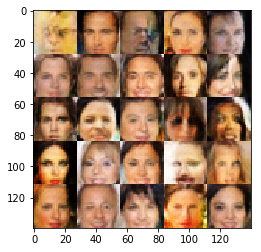

Epoch: 2/3 Discriminator Loss: 1.3804 Generator Loss: 0.7595
Epoch: 2/3 Discriminator Loss: 1.2094 Generator Loss: 0.9459
Epoch: 2/3 Discriminator Loss: 1.2621 Generator Loss: 0.9171
Epoch: 2/3 Discriminator Loss: 1.3244 Generator Loss: 0.8708
Epoch: 2/3 Discriminator Loss: 1.3114 Generator Loss: 0.8565
Epoch: 2/3 Discriminator Loss: 1.2774 Generator Loss: 0.8366
Epoch: 2/3 Discriminator Loss: 1.3405 Generator Loss: 0.7401
Epoch: 2/3 Discriminator Loss: 1.4594 Generator Loss: 0.6353
Epoch: 2/3 Discriminator Loss: 1.3979 Generator Loss: 0.6924
Epoch: 2/3 Discriminator Loss: 1.2687 Generator Loss: 0.7347


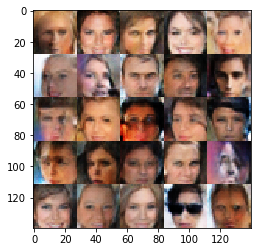

Epoch: 2/3 Discriminator Loss: 1.3381 Generator Loss: 0.7649
Epoch: 2/3 Discriminator Loss: 1.3498 Generator Loss: 0.7308
Epoch: 2/3 Discriminator Loss: 1.2386 Generator Loss: 0.9130
Epoch: 2/3 Discriminator Loss: 1.3653 Generator Loss: 0.6809
Epoch: 2/3 Discriminator Loss: 1.4741 Generator Loss: 0.5851
Epoch: 2/3 Discriminator Loss: 1.3183 Generator Loss: 0.8192
Epoch: 2/3 Discriminator Loss: 1.3439 Generator Loss: 0.6616
Epoch: 2/3 Discriminator Loss: 1.3090 Generator Loss: 0.9763
Epoch: 2/3 Discriminator Loss: 1.3185 Generator Loss: 0.8144
Epoch: 2/3 Discriminator Loss: 1.2677 Generator Loss: 0.8918


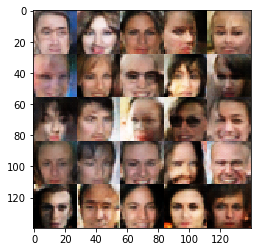

Epoch: 2/3 Discriminator Loss: 1.3026 Generator Loss: 0.7752
Epoch: 2/3 Discriminator Loss: 1.2888 Generator Loss: 0.8848
Epoch: 3/3 Discriminator Loss: 1.2500 Generator Loss: 0.8709
Epoch: 3/3 Discriminator Loss: 1.3453 Generator Loss: 0.8222
Epoch: 3/3 Discriminator Loss: 1.3277 Generator Loss: 0.7470
Epoch: 3/3 Discriminator Loss: 1.4074 Generator Loss: 0.7016
Epoch: 3/3 Discriminator Loss: 1.3128 Generator Loss: 0.8453
Epoch: 3/3 Discriminator Loss: 1.3051 Generator Loss: 0.7984
Epoch: 3/3 Discriminator Loss: 1.3250 Generator Loss: 0.7331
Epoch: 3/3 Discriminator Loss: 1.2913 Generator Loss: 0.8370


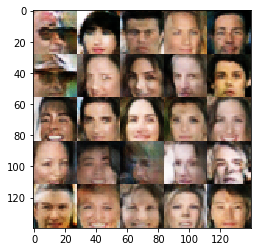

Epoch: 3/3 Discriminator Loss: 1.2775 Generator Loss: 0.8203
Epoch: 3/3 Discriminator Loss: 1.4364 Generator Loss: 0.6283
Epoch: 3/3 Discriminator Loss: 1.3539 Generator Loss: 0.8187
Epoch: 3/3 Discriminator Loss: 1.3852 Generator Loss: 0.7560
Epoch: 3/3 Discriminator Loss: 1.3695 Generator Loss: 0.6930
Epoch: 3/3 Discriminator Loss: 1.2839 Generator Loss: 0.8214
Epoch: 3/3 Discriminator Loss: 1.2917 Generator Loss: 0.8409
Epoch: 3/3 Discriminator Loss: 1.3028 Generator Loss: 0.6809
Epoch: 3/3 Discriminator Loss: 1.3383 Generator Loss: 0.7617
Epoch: 3/3 Discriminator Loss: 1.2814 Generator Loss: 0.8426


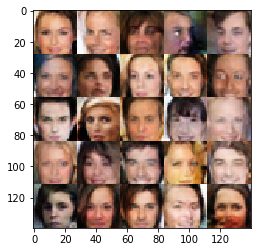

Epoch: 3/3 Discriminator Loss: 1.3532 Generator Loss: 0.7544
Epoch: 3/3 Discriminator Loss: 1.3376 Generator Loss: 0.7204
Epoch: 3/3 Discriminator Loss: 1.4110 Generator Loss: 0.7481
Epoch: 3/3 Discriminator Loss: 1.2786 Generator Loss: 0.8574
Epoch: 3/3 Discriminator Loss: 1.3801 Generator Loss: 0.7010
Epoch: 3/3 Discriminator Loss: 1.2744 Generator Loss: 0.7406
Epoch: 3/3 Discriminator Loss: 1.4379 Generator Loss: 0.7275
Epoch: 3/3 Discriminator Loss: 1.3943 Generator Loss: 0.7475
Epoch: 3/3 Discriminator Loss: 1.3876 Generator Loss: 0.8407
Epoch: 3/3 Discriminator Loss: 1.2785 Generator Loss: 0.8213


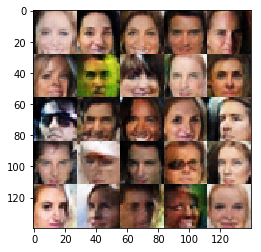

Epoch: 3/3 Discriminator Loss: 1.3559 Generator Loss: 0.7177
Epoch: 3/3 Discriminator Loss: 1.2978 Generator Loss: 0.8373
Epoch: 3/3 Discriminator Loss: 1.3699 Generator Loss: 0.7795
Epoch: 3/3 Discriminator Loss: 1.3287 Generator Loss: 0.7223
Epoch: 3/3 Discriminator Loss: 1.3961 Generator Loss: 0.7495
Epoch: 3/3 Discriminator Loss: 1.3023 Generator Loss: 0.8064
Epoch: 3/3 Discriminator Loss: 1.3949 Generator Loss: 0.6245
Epoch: 3/3 Discriminator Loss: 1.4249 Generator Loss: 0.6062
Epoch: 3/3 Discriminator Loss: 1.4607 Generator Loss: 0.8278
Epoch: 3/3 Discriminator Loss: 1.5825 Generator Loss: 0.5257


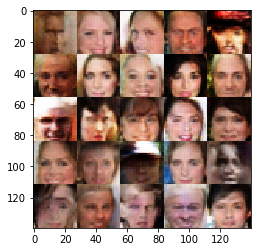

Epoch: 3/3 Discriminator Loss: 1.2637 Generator Loss: 0.8342
Epoch: 3/3 Discriminator Loss: 1.3190 Generator Loss: 0.8410
Epoch: 3/3 Discriminator Loss: 1.3219 Generator Loss: 0.7828
Epoch: 3/3 Discriminator Loss: 1.3503 Generator Loss: 0.7671
Epoch: 3/3 Discriminator Loss: 1.2725 Generator Loss: 0.8969
Epoch: 3/3 Discriminator Loss: 1.3150 Generator Loss: 0.7762
Epoch: 3/3 Discriminator Loss: 1.2813 Generator Loss: 1.1711
Epoch: 3/3 Discriminator Loss: 1.3802 Generator Loss: 0.7080
Epoch: 3/3 Discriminator Loss: 1.2230 Generator Loss: 0.8207
Epoch: 3/3 Discriminator Loss: 1.5138 Generator Loss: 0.6582


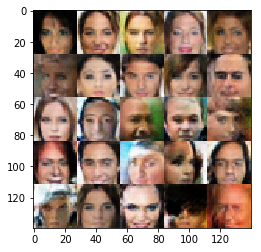

Epoch: 3/3 Discriminator Loss: 1.2396 Generator Loss: 0.8983
Epoch: 3/3 Discriminator Loss: 1.2855 Generator Loss: 0.7035
Epoch: 3/3 Discriminator Loss: 1.2782 Generator Loss: 0.8400
Epoch: 3/3 Discriminator Loss: 1.4083 Generator Loss: 0.7181
Epoch: 3/3 Discriminator Loss: 1.3676 Generator Loss: 0.8109
Epoch: 3/3 Discriminator Loss: 1.4060 Generator Loss: 0.6916
Epoch: 3/3 Discriminator Loss: 1.3140 Generator Loss: 0.8467
Epoch: 3/3 Discriminator Loss: 1.3382 Generator Loss: 0.7112
Epoch: 3/3 Discriminator Loss: 1.3137 Generator Loss: 0.8054
Epoch: 3/3 Discriminator Loss: 1.2837 Generator Loss: 0.7864


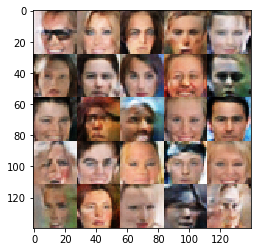

Epoch: 3/3 Discriminator Loss: 1.2621 Generator Loss: 0.8845
Epoch: 3/3 Discriminator Loss: 1.3483 Generator Loss: 0.6956
Epoch: 3/3 Discriminator Loss: 1.3511 Generator Loss: 0.8067
Epoch: 3/3 Discriminator Loss: 1.3194 Generator Loss: 0.7581
Epoch: 3/3 Discriminator Loss: 1.4447 Generator Loss: 0.6398
Epoch: 3/3 Discriminator Loss: 1.2773 Generator Loss: 0.8432
Epoch: 3/3 Discriminator Loss: 1.3139 Generator Loss: 0.7664
Epoch: 3/3 Discriminator Loss: 1.3440 Generator Loss: 0.6620
Epoch: 3/3 Discriminator Loss: 1.3669 Generator Loss: 0.6435
Epoch: 3/3 Discriminator Loss: 1.3891 Generator Loss: 0.7139


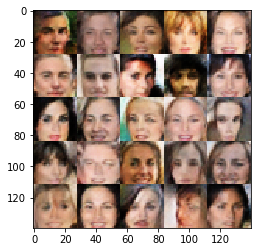

Epoch: 3/3 Discriminator Loss: 1.3249 Generator Loss: 0.8588
Epoch: 3/3 Discriminator Loss: 1.2752 Generator Loss: 0.8302
Epoch: 3/3 Discriminator Loss: 1.2979 Generator Loss: 0.7546
Epoch: 3/3 Discriminator Loss: 1.3533 Generator Loss: 0.7943
Epoch: 3/3 Discriminator Loss: 1.3578 Generator Loss: 0.7801
Epoch: 3/3 Discriminator Loss: 1.3104 Generator Loss: 0.7841
Epoch: 3/3 Discriminator Loss: 1.2200 Generator Loss: 0.8624
Epoch: 3/3 Discriminator Loss: 1.3728 Generator Loss: 0.7073
Epoch: 3/3 Discriminator Loss: 1.3698 Generator Loss: 0.6725
Epoch: 3/3 Discriminator Loss: 1.3387 Generator Loss: 0.7302


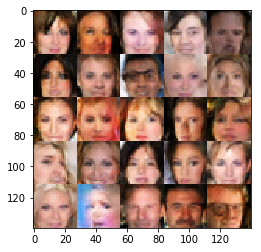

Epoch: 3/3 Discriminator Loss: 1.3930 Generator Loss: 0.8268
Epoch: 3/3 Discriminator Loss: 1.4527 Generator Loss: 0.6040
Epoch: 3/3 Discriminator Loss: 1.3061 Generator Loss: 0.7477
Epoch: 3/3 Discriminator Loss: 1.2456 Generator Loss: 0.9623
Epoch: 3/3 Discriminator Loss: 1.3471 Generator Loss: 0.7206
Epoch: 3/3 Discriminator Loss: 1.2871 Generator Loss: 0.9064
Epoch: 3/3 Discriminator Loss: 1.3273 Generator Loss: 0.7136
Epoch: 3/3 Discriminator Loss: 1.3638 Generator Loss: 0.8045
Epoch: 3/3 Discriminator Loss: 1.3817 Generator Loss: 0.6817
Epoch: 3/3 Discriminator Loss: 1.2788 Generator Loss: 0.7314


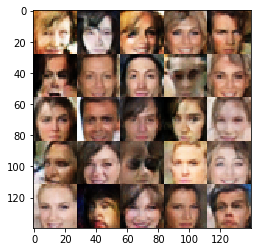

Epoch: 3/3 Discriminator Loss: 1.3015 Generator Loss: 0.9743
Epoch: 3/3 Discriminator Loss: 1.2614 Generator Loss: 0.8791
Epoch: 3/3 Discriminator Loss: 1.3123 Generator Loss: 0.7467
Epoch: 3/3 Discriminator Loss: 1.3960 Generator Loss: 0.6675
Epoch: 3/3 Discriminator Loss: 1.2340 Generator Loss: 0.9071
Epoch: 3/3 Discriminator Loss: 1.2865 Generator Loss: 0.8784
Epoch: 3/3 Discriminator Loss: 1.3521 Generator Loss: 0.7452
Epoch: 3/3 Discriminator Loss: 1.2928 Generator Loss: 0.8103
Epoch: 3/3 Discriminator Loss: 1.3307 Generator Loss: 0.6998
Epoch: 3/3 Discriminator Loss: 1.2554 Generator Loss: 0.8185


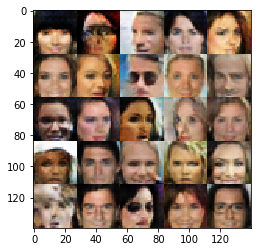

Epoch: 3/3 Discriminator Loss: 1.3914 Generator Loss: 0.6435
Epoch: 3/3 Discriminator Loss: 1.4168 Generator Loss: 0.7031
Epoch: 3/3 Discriminator Loss: 1.4468 Generator Loss: 0.6271
Epoch: 3/3 Discriminator Loss: 1.2842 Generator Loss: 0.8082
Epoch: 3/3 Discriminator Loss: 1.4054 Generator Loss: 0.5840
Epoch: 3/3 Discriminator Loss: 1.3602 Generator Loss: 0.7158
Epoch: 3/3 Discriminator Loss: 1.3056 Generator Loss: 0.8008
Epoch: 3/3 Discriminator Loss: 1.3052 Generator Loss: 0.7457
Epoch: 3/3 Discriminator Loss: 1.3286 Generator Loss: 0.8025
Epoch: 3/3 Discriminator Loss: 1.3119 Generator Loss: 0.7663


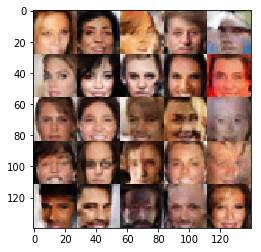

Epoch: 3/3 Discriminator Loss: 1.2483 Generator Loss: 0.9822
Epoch: 3/3 Discriminator Loss: 1.4022 Generator Loss: 0.6251
Epoch: 3/3 Discriminator Loss: 1.3168 Generator Loss: 0.7171
Epoch: 3/3 Discriminator Loss: 1.3201 Generator Loss: 0.8240
Epoch: 3/3 Discriminator Loss: 1.3560 Generator Loss: 0.7259
Epoch: 3/3 Discriminator Loss: 1.2832 Generator Loss: 0.8103
Epoch: 3/3 Discriminator Loss: 1.3025 Generator Loss: 0.7801
Epoch: 3/3 Discriminator Loss: 1.3117 Generator Loss: 0.8087
Epoch: 3/3 Discriminator Loss: 1.2315 Generator Loss: 0.8713
Epoch: 3/3 Discriminator Loss: 1.3009 Generator Loss: 0.9309


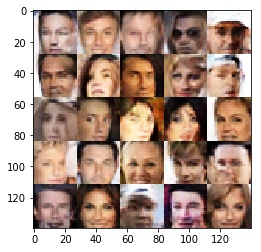

Epoch: 3/3 Discriminator Loss: 1.3159 Generator Loss: 0.8633
Epoch: 3/3 Discriminator Loss: 1.3799 Generator Loss: 0.7216
Epoch: 3/3 Discriminator Loss: 1.3356 Generator Loss: 0.7690
Epoch: 3/3 Discriminator Loss: 1.4096 Generator Loss: 0.6421
Epoch: 3/3 Discriminator Loss: 1.3589 Generator Loss: 0.7912
Epoch: 3/3 Discriminator Loss: 1.3376 Generator Loss: 0.7977
Epoch: 3/3 Discriminator Loss: 1.2108 Generator Loss: 0.9836
Epoch: 3/3 Discriminator Loss: 1.4015 Generator Loss: 0.6443
Epoch: 3/3 Discriminator Loss: 1.3504 Generator Loss: 0.7903
Epoch: 3/3 Discriminator Loss: 1.3171 Generator Loss: 0.7379


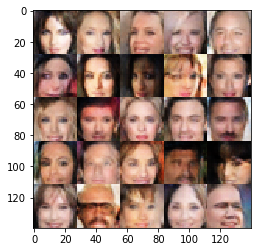

Epoch: 3/3 Discriminator Loss: 1.3138 Generator Loss: 0.7628
Epoch: 3/3 Discriminator Loss: 1.3175 Generator Loss: 0.8624
Epoch: 3/3 Discriminator Loss: 1.3110 Generator Loss: 0.7289
Epoch: 3/3 Discriminator Loss: 1.4027 Generator Loss: 0.7370
Epoch: 3/3 Discriminator Loss: 1.3634 Generator Loss: 0.6877
Epoch: 3/3 Discriminator Loss: 1.3536 Generator Loss: 0.7778
Epoch: 3/3 Discriminator Loss: 1.3142 Generator Loss: 0.8142
Epoch: 3/3 Discriminator Loss: 1.3334 Generator Loss: 0.7249
Epoch: 3/3 Discriminator Loss: 1.3825 Generator Loss: 0.7050
Epoch: 3/3 Discriminator Loss: 1.3366 Generator Loss: 1.0117


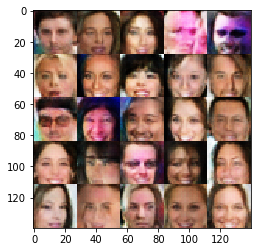

Epoch: 3/3 Discriminator Loss: 1.2432 Generator Loss: 0.7604
Epoch: 3/3 Discriminator Loss: 1.3183 Generator Loss: 0.8312
Epoch: 3/3 Discriminator Loss: 1.2485 Generator Loss: 0.9313
Epoch: 3/3 Discriminator Loss: 1.3346 Generator Loss: 0.6108
Epoch: 3/3 Discriminator Loss: 1.4238 Generator Loss: 0.7031
Epoch: 3/3 Discriminator Loss: 1.2393 Generator Loss: 0.9055
Epoch: 3/3 Discriminator Loss: 1.2252 Generator Loss: 0.7884
Epoch: 3/3 Discriminator Loss: 1.1642 Generator Loss: 0.8881
Epoch: 3/3 Discriminator Loss: 1.4794 Generator Loss: 0.6173
Epoch: 3/3 Discriminator Loss: 1.3575 Generator Loss: 0.7966


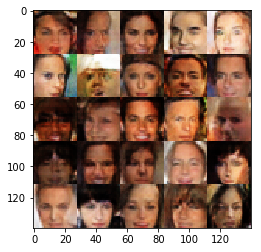

Epoch: 3/3 Discriminator Loss: 1.4772 Generator Loss: 0.9172
Epoch: 3/3 Discriminator Loss: 1.2614 Generator Loss: 0.7372
Epoch: 3/3 Discriminator Loss: 1.4270 Generator Loss: 0.7789
Epoch: 3/3 Discriminator Loss: 1.3043 Generator Loss: 0.8529
Epoch: 3/3 Discriminator Loss: 1.3023 Generator Loss: 0.7863
Epoch: 3/3 Discriminator Loss: 1.1970 Generator Loss: 0.8964
Epoch: 3/3 Discriminator Loss: 1.3104 Generator Loss: 0.7577
Epoch: 3/3 Discriminator Loss: 1.2537 Generator Loss: 0.8070
Epoch: 3/3 Discriminator Loss: 1.3590 Generator Loss: 0.7904
Epoch: 3/3 Discriminator Loss: 1.3894 Generator Loss: 0.7526


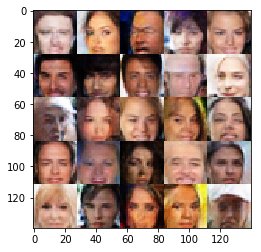

Epoch: 3/3 Discriminator Loss: 1.3219 Generator Loss: 0.8746
Epoch: 3/3 Discriminator Loss: 1.2992 Generator Loss: 0.7247
Epoch: 3/3 Discriminator Loss: 1.2946 Generator Loss: 0.8440
Epoch: 3/3 Discriminator Loss: 1.2772 Generator Loss: 0.7797
Epoch: 3/3 Discriminator Loss: 1.4548 Generator Loss: 0.7358
Epoch: 3/3 Discriminator Loss: 1.3929 Generator Loss: 0.7729
Epoch: 3/3 Discriminator Loss: 1.4527 Generator Loss: 0.6374
Epoch: 3/3 Discriminator Loss: 1.2664 Generator Loss: 0.9308
Epoch: 3/3 Discriminator Loss: 1.3337 Generator Loss: 0.8101
Epoch: 3/3 Discriminator Loss: 1.3688 Generator Loss: 0.6622


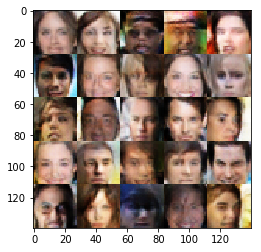

Epoch: 3/3 Discriminator Loss: 1.3558 Generator Loss: 0.7261
Epoch: 3/3 Discriminator Loss: 1.3242 Generator Loss: 0.7327
Epoch: 3/3 Discriminator Loss: 1.3240 Generator Loss: 0.8267
Epoch: 3/3 Discriminator Loss: 1.3419 Generator Loss: 0.8224
Epoch: 3/3 Discriminator Loss: 1.3853 Generator Loss: 0.6974
Epoch: 3/3 Discriminator Loss: 1.3161 Generator Loss: 0.7508
Epoch: 3/3 Discriminator Loss: 1.2539 Generator Loss: 0.8724
Epoch: 3/3 Discriminator Loss: 1.3289 Generator Loss: 0.7477
Epoch: 3/3 Discriminator Loss: 1.3229 Generator Loss: 0.7568
Epoch: 3/3 Discriminator Loss: 1.3802 Generator Loss: 0.6460


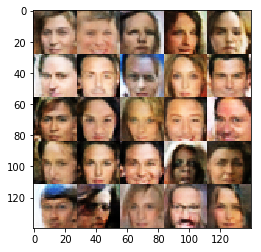

Epoch: 3/3 Discriminator Loss: 1.3713 Generator Loss: 0.8089
Epoch: 3/3 Discriminator Loss: 1.2580 Generator Loss: 0.8473
Epoch: 3/3 Discriminator Loss: 1.3256 Generator Loss: 0.7480
Epoch: 3/3 Discriminator Loss: 1.3498 Generator Loss: 0.8004
Epoch: 3/3 Discriminator Loss: 1.3382 Generator Loss: 0.7769
Epoch: 3/3 Discriminator Loss: 1.3441 Generator Loss: 0.7533
Epoch: 3/3 Discriminator Loss: 1.3660 Generator Loss: 0.7115
Epoch: 3/3 Discriminator Loss: 1.2591 Generator Loss: 0.8481
Epoch: 3/3 Discriminator Loss: 1.2516 Generator Loss: 0.8385
Epoch: 3/3 Discriminator Loss: 1.3022 Generator Loss: 0.7956


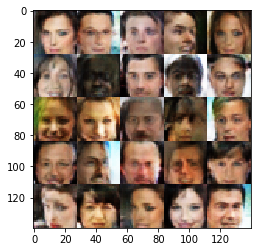

Epoch: 3/3 Discriminator Loss: 1.2675 Generator Loss: 0.9060
Epoch: 3/3 Discriminator Loss: 1.3635 Generator Loss: 0.7035
Epoch: 3/3 Discriminator Loss: 1.2966 Generator Loss: 0.7559
Epoch: 3/3 Discriminator Loss: 1.2382 Generator Loss: 0.8697
Epoch: 3/3 Discriminator Loss: 1.2863 Generator Loss: 0.8363
Epoch: 3/3 Discriminator Loss: 1.3309 Generator Loss: 0.7107
Epoch: 3/3 Discriminator Loss: 1.3387 Generator Loss: 0.7746
Epoch: 3/3 Discriminator Loss: 1.3217 Generator Loss: 0.7782
Epoch: 3/3 Discriminator Loss: 1.2300 Generator Loss: 0.9017
Epoch: 3/3 Discriminator Loss: 1.3809 Generator Loss: 0.7847


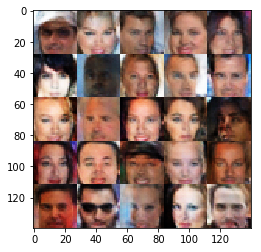

Epoch: 3/3 Discriminator Loss: 1.2987 Generator Loss: 0.8394
Epoch: 3/3 Discriminator Loss: 1.3068 Generator Loss: 0.8116
Epoch: 3/3 Discriminator Loss: 1.3435 Generator Loss: 0.7846
Epoch: 3/3 Discriminator Loss: 1.3154 Generator Loss: 0.7943
Epoch: 3/3 Discriminator Loss: 1.2984 Generator Loss: 0.7182
Epoch: 3/3 Discriminator Loss: 1.2746 Generator Loss: 0.8443
Epoch: 3/3 Discriminator Loss: 1.2758 Generator Loss: 0.7305
Epoch: 3/3 Discriminator Loss: 1.3566 Generator Loss: 0.7209
Epoch: 3/3 Discriminator Loss: 1.4010 Generator Loss: 0.5758
Epoch: 3/3 Discriminator Loss: 1.2432 Generator Loss: 0.8438


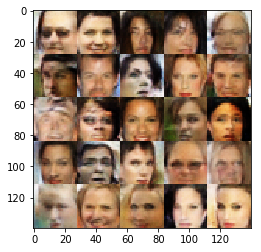

Epoch: 3/3 Discriminator Loss: 1.4511 Generator Loss: 0.6265
Epoch: 3/3 Discriminator Loss: 1.3550 Generator Loss: 0.6978
Epoch: 3/3 Discriminator Loss: 1.3657 Generator Loss: 0.7331
Epoch: 3/3 Discriminator Loss: 1.3012 Generator Loss: 0.7901
Epoch: 3/3 Discriminator Loss: 1.2972 Generator Loss: 0.7386
Epoch: 3/3 Discriminator Loss: 1.3054 Generator Loss: 0.6913
Epoch: 3/3 Discriminator Loss: 1.3103 Generator Loss: 0.8632
Epoch: 3/3 Discriminator Loss: 1.3254 Generator Loss: 0.8244
Epoch: 3/3 Discriminator Loss: 1.4287 Generator Loss: 0.6656
Epoch: 3/3 Discriminator Loss: 1.3346 Generator Loss: 0.9212


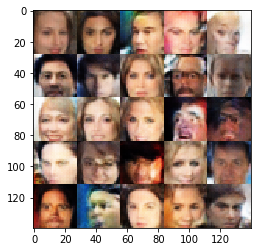

Epoch: 3/3 Discriminator Loss: 1.3017 Generator Loss: 0.7152
Epoch: 3/3 Discriminator Loss: 1.3357 Generator Loss: 0.6756
Epoch: 3/3 Discriminator Loss: 1.2917 Generator Loss: 0.8658
Epoch: 3/3 Discriminator Loss: 1.2798 Generator Loss: 0.7813
Epoch: 3/3 Discriminator Loss: 1.3295 Generator Loss: 0.6776
Epoch: 3/3 Discriminator Loss: 1.3435 Generator Loss: 0.7794
Epoch: 3/3 Discriminator Loss: 1.4003 Generator Loss: 0.5678
Epoch: 3/3 Discriminator Loss: 1.3944 Generator Loss: 0.6620
Epoch: 3/3 Discriminator Loss: 1.3104 Generator Loss: 0.7978
Epoch: 3/3 Discriminator Loss: 1.3617 Generator Loss: 0.7188


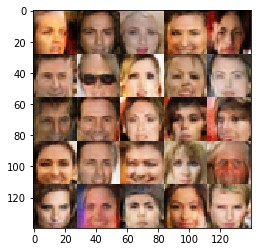

Epoch: 3/3 Discriminator Loss: 1.2899 Generator Loss: 0.8685
Epoch: 3/3 Discriminator Loss: 1.4279 Generator Loss: 0.6587
Epoch: 3/3 Discriminator Loss: 1.2246 Generator Loss: 0.9051
Epoch: 3/3 Discriminator Loss: 1.4057 Generator Loss: 0.7022
Epoch: 3/3 Discriminator Loss: 1.2720 Generator Loss: 0.8219
Epoch: 3/3 Discriminator Loss: 1.4100 Generator Loss: 0.7501
Epoch: 3/3 Discriminator Loss: 1.2733 Generator Loss: 0.8140
Epoch: 3/3 Discriminator Loss: 1.3769 Generator Loss: 0.6144
Epoch: 3/3 Discriminator Loss: 1.3610 Generator Loss: 0.6525
Epoch: 3/3 Discriminator Loss: 1.3298 Generator Loss: 0.8263


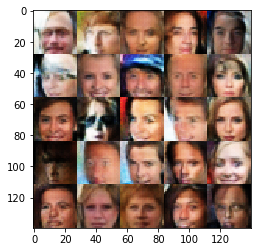

Epoch: 3/3 Discriminator Loss: 1.2772 Generator Loss: 0.8102
Epoch: 3/3 Discriminator Loss: 1.3481 Generator Loss: 0.7064
Epoch: 3/3 Discriminator Loss: 1.3265 Generator Loss: 0.7657
Epoch: 3/3 Discriminator Loss: 1.2977 Generator Loss: 0.7488
Epoch: 3/3 Discriminator Loss: 1.3124 Generator Loss: 0.9384
Epoch: 3/3 Discriminator Loss: 1.2832 Generator Loss: 0.7341
Epoch: 3/3 Discriminator Loss: 1.3849 Generator Loss: 0.7355
Epoch: 3/3 Discriminator Loss: 1.2961 Generator Loss: 0.7837
Epoch: 3/3 Discriminator Loss: 1.3731 Generator Loss: 0.6478
Epoch: 3/3 Discriminator Loss: 1.2901 Generator Loss: 0.6743


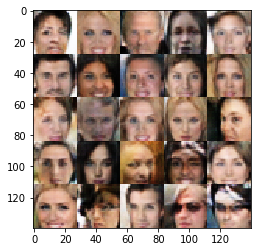

Epoch: 3/3 Discriminator Loss: 1.3115 Generator Loss: 0.7506
Epoch: 3/3 Discriminator Loss: 1.2636 Generator Loss: 0.7515
Epoch: 3/3 Discriminator Loss: 1.3181 Generator Loss: 0.7857
Epoch: 3/3 Discriminator Loss: 1.3633 Generator Loss: 0.8020
Epoch: 3/3 Discriminator Loss: 1.3472 Generator Loss: 0.7284
Epoch: 3/3 Discriminator Loss: 1.2977 Generator Loss: 0.7708
Epoch: 3/3 Discriminator Loss: 1.4378 Generator Loss: 0.6960
Epoch: 3/3 Discriminator Loss: 1.3040 Generator Loss: 0.8760
Epoch: 3/3 Discriminator Loss: 1.4220 Generator Loss: 0.6711
Epoch: 3/3 Discriminator Loss: 1.2786 Generator Loss: 0.8897


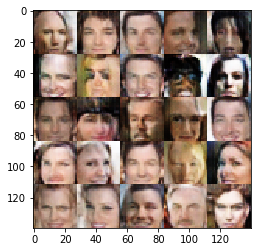

Epoch: 3/3 Discriminator Loss: 1.2788 Generator Loss: 0.8866
Epoch: 3/3 Discriminator Loss: 1.2696 Generator Loss: 0.7586
Epoch: 3/3 Discriminator Loss: 1.3800 Generator Loss: 0.6817
Epoch: 3/3 Discriminator Loss: 1.3084 Generator Loss: 0.8653
Epoch: 3/3 Discriminator Loss: 1.3038 Generator Loss: 0.6641
Epoch: 3/3 Discriminator Loss: 1.3543 Generator Loss: 0.6735
Epoch: 3/3 Discriminator Loss: 1.2792 Generator Loss: 0.7764
Epoch: 3/3 Discriminator Loss: 1.2663 Generator Loss: 0.7760
Epoch: 3/3 Discriminator Loss: 1.3085 Generator Loss: 0.8568
Epoch: 3/3 Discriminator Loss: 1.4433 Generator Loss: 0.6768


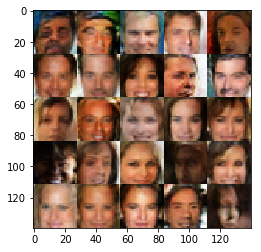

Epoch: 3/3 Discriminator Loss: 1.2644 Generator Loss: 0.9384
Epoch: 3/3 Discriminator Loss: 1.2027 Generator Loss: 0.9426
Epoch: 3/3 Discriminator Loss: 1.3931 Generator Loss: 1.2010
Epoch: 3/3 Discriminator Loss: 1.3164 Generator Loss: 0.7721
Epoch: 3/3 Discriminator Loss: 1.3485 Generator Loss: 0.8539
Epoch: 3/3 Discriminator Loss: 1.3192 Generator Loss: 0.8045
Epoch: 3/3 Discriminator Loss: 1.3351 Generator Loss: 0.7853
Epoch: 3/3 Discriminator Loss: 1.3478 Generator Loss: 0.7637
Epoch: 3/3 Discriminator Loss: 1.2404 Generator Loss: 0.8216
Epoch: 3/3 Discriminator Loss: 1.5027 Generator Loss: 0.5758


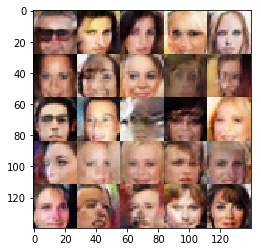

Epoch: 3/3 Discriminator Loss: 1.3280 Generator Loss: 0.8450
Epoch: 3/3 Discriminator Loss: 1.3210 Generator Loss: 0.8015
Epoch: 3/3 Discriminator Loss: 1.1765 Generator Loss: 0.9183
Epoch: 3/3 Discriminator Loss: 1.2646 Generator Loss: 0.7787
Epoch: 3/3 Discriminator Loss: 1.3416 Generator Loss: 0.7098
Epoch: 3/3 Discriminator Loss: 1.2675 Generator Loss: 0.7873
Epoch: 3/3 Discriminator Loss: 1.2682 Generator Loss: 0.8579
Epoch: 3/3 Discriminator Loss: 1.3345 Generator Loss: 0.7768
Epoch: 3/3 Discriminator Loss: 1.3575 Generator Loss: 0.7573
Epoch: 3/3 Discriminator Loss: 1.3956 Generator Loss: 0.7399


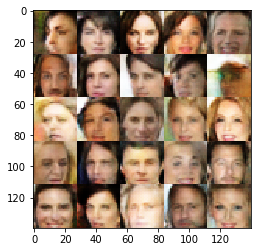

Epoch: 3/3 Discriminator Loss: 1.3128 Generator Loss: 0.7168
Epoch: 3/3 Discriminator Loss: 1.3257 Generator Loss: 0.7669
Epoch: 3/3 Discriminator Loss: 1.4580 Generator Loss: 0.6064
Epoch: 3/3 Discriminator Loss: 1.3639 Generator Loss: 0.7263
Epoch: 3/3 Discriminator Loss: 1.3880 Generator Loss: 0.8877
Epoch: 3/3 Discriminator Loss: 1.2410 Generator Loss: 0.8149
Epoch: 3/3 Discriminator Loss: 1.2838 Generator Loss: 0.7433
Epoch: 3/3 Discriminator Loss: 1.2678 Generator Loss: 0.8424
Epoch: 3/3 Discriminator Loss: 1.4052 Generator Loss: 0.6391
Epoch: 3/3 Discriminator Loss: 1.2538 Generator Loss: 0.8555


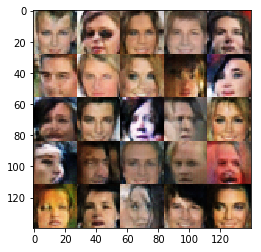

Epoch: 3/3 Discriminator Loss: 1.3361 Generator Loss: 0.8008
Epoch: 3/3 Discriminator Loss: 1.3640 Generator Loss: 0.6714
Epoch: 3/3 Discriminator Loss: 1.2843 Generator Loss: 0.8794
Epoch: 3/3 Discriminator Loss: 1.2673 Generator Loss: 1.0759
Epoch: 3/3 Discriminator Loss: 1.2720 Generator Loss: 0.8079
Epoch: 3/3 Discriminator Loss: 1.3649 Generator Loss: 0.7394
Epoch: 3/3 Discriminator Loss: 1.3383 Generator Loss: 0.7393
Epoch: 3/3 Discriminator Loss: 1.2166 Generator Loss: 0.8274
Epoch: 3/3 Discriminator Loss: 1.3282 Generator Loss: 0.7130
Epoch: 3/3 Discriminator Loss: 1.4905 Generator Loss: 0.5802


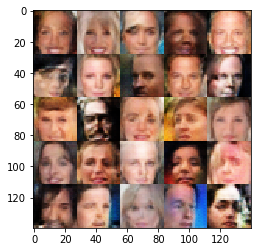

Epoch: 3/3 Discriminator Loss: 1.4235 Generator Loss: 0.6907
Epoch: 3/3 Discriminator Loss: 1.4126 Generator Loss: 0.7156
Epoch: 3/3 Discriminator Loss: 1.4138 Generator Loss: 0.6922
Epoch: 3/3 Discriminator Loss: 1.3323 Generator Loss: 0.7815
Epoch: 3/3 Discriminator Loss: 1.2638 Generator Loss: 0.7945
Epoch: 3/3 Discriminator Loss: 1.3306 Generator Loss: 0.7491
Epoch: 3/3 Discriminator Loss: 1.3756 Generator Loss: 0.7950
Epoch: 3/3 Discriminator Loss: 1.2581 Generator Loss: 0.8022
Epoch: 3/3 Discriminator Loss: 1.2030 Generator Loss: 0.9478
Epoch: 3/3 Discriminator Loss: 1.3459 Generator Loss: 0.7817


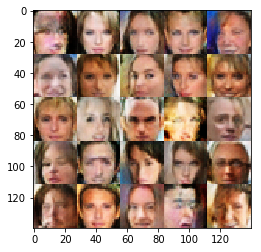

Epoch: 3/3 Discriminator Loss: 1.2743 Generator Loss: 0.8625
Epoch: 3/3 Discriminator Loss: 1.3104 Generator Loss: 0.7597
Epoch: 3/3 Discriminator Loss: 1.2777 Generator Loss: 0.8624
Epoch: 3/3 Discriminator Loss: 1.3395 Generator Loss: 0.7490
Epoch: 3/3 Discriminator Loss: 1.3351 Generator Loss: 0.8532
Epoch: 3/3 Discriminator Loss: 1.3321 Generator Loss: 0.6876
Epoch: 3/3 Discriminator Loss: 1.4304 Generator Loss: 0.7456
Epoch: 3/3 Discriminator Loss: 1.3498 Generator Loss: 0.8333
Epoch: 3/3 Discriminator Loss: 1.3961 Generator Loss: 0.7257
Epoch: 3/3 Discriminator Loss: 1.3417 Generator Loss: 0.9167


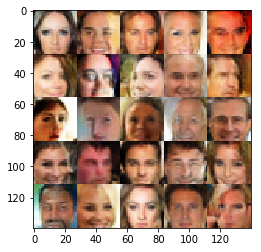

Epoch: 3/3 Discriminator Loss: 1.3345 Generator Loss: 0.7615
Epoch: 3/3 Discriminator Loss: 1.2969 Generator Loss: 0.7942
Epoch: 3/3 Discriminator Loss: 1.3470 Generator Loss: 0.7589
Epoch: 3/3 Discriminator Loss: 1.3729 Generator Loss: 0.7425
Epoch: 3/3 Discriminator Loss: 1.2647 Generator Loss: 0.8772
Epoch: 3/3 Discriminator Loss: 1.3760 Generator Loss: 0.7735
Epoch: 3/3 Discriminator Loss: 1.4054 Generator Loss: 0.7415
Epoch: 3/3 Discriminator Loss: 1.2811 Generator Loss: 0.8055
Epoch: 3/3 Discriminator Loss: 1.2660 Generator Loss: 0.7749
Epoch: 3/3 Discriminator Loss: 1.3830 Generator Loss: 0.7716


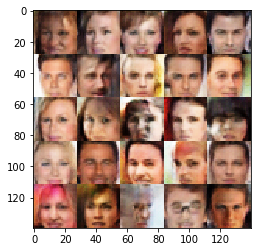

Epoch: 3/3 Discriminator Loss: 1.3614 Generator Loss: 0.7477
Epoch: 3/3 Discriminator Loss: 1.3689 Generator Loss: 0.6469
Epoch: 3/3 Discriminator Loss: 1.3189 Generator Loss: 0.8315
Epoch: 3/3 Discriminator Loss: 1.2641 Generator Loss: 0.8309
Epoch: 3/3 Discriminator Loss: 1.4419 Generator Loss: 0.6487
Epoch: 3/3 Discriminator Loss: 1.3043 Generator Loss: 0.7389
Epoch: 3/3 Discriminator Loss: 1.3416 Generator Loss: 0.6965
Epoch: 3/3 Discriminator Loss: 1.2183 Generator Loss: 0.8335
Epoch: 3/3 Discriminator Loss: 1.4063 Generator Loss: 0.7119
Epoch: 3/3 Discriminator Loss: 1.3050 Generator Loss: 0.8092


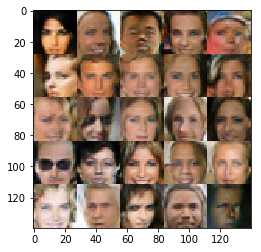

Epoch: 3/3 Discriminator Loss: 1.2649 Generator Loss: 0.8134
Epoch: 3/3 Discriminator Loss: 1.4043 Generator Loss: 0.6361
Epoch: 3/3 Discriminator Loss: 1.2185 Generator Loss: 0.8687
Epoch: 3/3 Discriminator Loss: 1.3516 Generator Loss: 0.7846
Epoch: 3/3 Discriminator Loss: 1.2745 Generator Loss: 0.8667
Epoch: 3/3 Discriminator Loss: 1.3136 Generator Loss: 0.8052
Epoch: 3/3 Discriminator Loss: 1.0548 Generator Loss: 1.0545
Epoch: 3/3 Discriminator Loss: 1.3539 Generator Loss: 0.7134
Epoch: 3/3 Discriminator Loss: 1.3173 Generator Loss: 0.7581
Epoch: 3/3 Discriminator Loss: 1.3709 Generator Loss: 0.7164


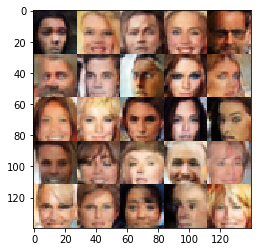

Epoch: 3/3 Discriminator Loss: 1.2588 Generator Loss: 0.8715
Epoch: 3/3 Discriminator Loss: 1.2611 Generator Loss: 0.9149
Epoch: 3/3 Discriminator Loss: 1.2982 Generator Loss: 0.6869
Epoch: 3/3 Discriminator Loss: 1.2545 Generator Loss: 0.7725
Epoch: 3/3 Discriminator Loss: 1.4133 Generator Loss: 0.5758
Epoch: 3/3 Discriminator Loss: 1.3685 Generator Loss: 0.6134
Epoch: 3/3 Discriminator Loss: 1.2821 Generator Loss: 0.8211
Epoch: 3/3 Discriminator Loss: 1.3132 Generator Loss: 0.7022
Epoch: 3/3 Discriminator Loss: 1.3748 Generator Loss: 0.5983
Epoch: 3/3 Discriminator Loss: 1.3496 Generator Loss: 0.7646


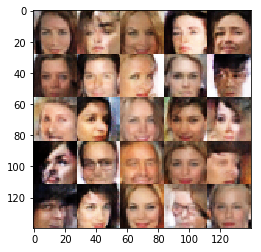

Epoch: 3/3 Discriminator Loss: 1.3024 Generator Loss: 0.7235
Epoch: 3/3 Discriminator Loss: 1.3712 Generator Loss: 0.6520
Epoch: 3/3 Discriminator Loss: 1.3204 Generator Loss: 0.8081
Epoch: 3/3 Discriminator Loss: 1.3068 Generator Loss: 0.8522
Epoch: 3/3 Discriminator Loss: 1.3068 Generator Loss: 0.7384
Epoch: 3/3 Discriminator Loss: 1.3114 Generator Loss: 0.7710
Epoch: 3/3 Discriminator Loss: 1.3572 Generator Loss: 0.7096
Epoch: 3/3 Discriminator Loss: 1.4882 Generator Loss: 0.5670
Epoch: 3/3 Discriminator Loss: 1.3666 Generator Loss: 0.7613
Epoch: 3/3 Discriminator Loss: 1.4142 Generator Loss: 0.6326


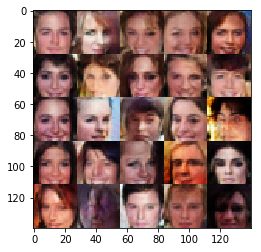

Epoch: 3/3 Discriminator Loss: 1.2898 Generator Loss: 0.8799
Epoch: 3/3 Discriminator Loss: 1.2199 Generator Loss: 0.8721
Epoch: 3/3 Discriminator Loss: 1.2666 Generator Loss: 0.7528
Epoch: 3/3 Discriminator Loss: 1.3005 Generator Loss: 0.8044
Epoch: 3/3 Discriminator Loss: 1.3192 Generator Loss: 0.8405
Epoch: 3/3 Discriminator Loss: 1.2519 Generator Loss: 0.9122
Epoch: 3/3 Discriminator Loss: 1.3520 Generator Loss: 0.8010
Epoch: 3/3 Discriminator Loss: 1.3912 Generator Loss: 0.7041
Epoch: 3/3 Discriminator Loss: 1.1794 Generator Loss: 0.9126
Epoch: 3/3 Discriminator Loss: 1.3135 Generator Loss: 0.7551


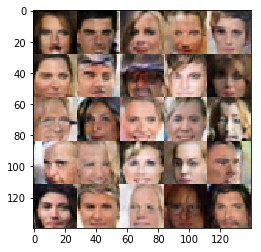

Epoch: 3/3 Discriminator Loss: 1.3577 Generator Loss: 0.7563
Epoch: 3/3 Discriminator Loss: 1.3504 Generator Loss: 0.7269
Epoch: 3/3 Discriminator Loss: 1.2494 Generator Loss: 0.8187
Epoch: 3/3 Discriminator Loss: 1.3285 Generator Loss: 0.7071
Epoch: 3/3 Discriminator Loss: 1.2254 Generator Loss: 0.8888
Epoch: 3/3 Discriminator Loss: 1.3024 Generator Loss: 0.7760
Epoch: 3/3 Discriminator Loss: 1.3929 Generator Loss: 0.6708
Epoch: 3/3 Discriminator Loss: 1.2282 Generator Loss: 0.8753
Epoch: 3/3 Discriminator Loss: 1.3155 Generator Loss: 0.8924
Epoch: 3/3 Discriminator Loss: 1.2700 Generator Loss: 0.8552


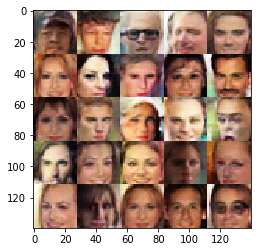

Epoch: 3/3 Discriminator Loss: 1.3669 Generator Loss: 0.6937
Epoch: 3/3 Discriminator Loss: 1.2893 Generator Loss: 0.6757
Epoch: 3/3 Discriminator Loss: 1.3484 Generator Loss: 0.7477
Epoch: 3/3 Discriminator Loss: 1.3776 Generator Loss: 0.6351
Epoch: 3/3 Discriminator Loss: 1.4039 Generator Loss: 0.7543
Epoch: 3/3 Discriminator Loss: 1.2836 Generator Loss: 0.8428
Epoch: 3/3 Discriminator Loss: 1.3579 Generator Loss: 0.7556
Epoch: 3/3 Discriminator Loss: 1.2883 Generator Loss: 0.7407
Epoch: 3/3 Discriminator Loss: 1.3497 Generator Loss: 0.7887
Epoch: 3/3 Discriminator Loss: 1.2639 Generator Loss: 0.8696


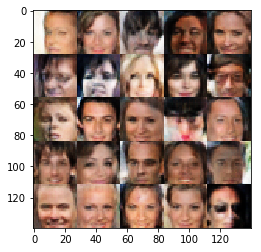

Epoch: 3/3 Discriminator Loss: 1.4787 Generator Loss: 0.6159
Epoch: 3/3 Discriminator Loss: 1.2714 Generator Loss: 0.7554
Epoch: 3/3 Discriminator Loss: 1.3840 Generator Loss: 0.7028
Epoch: 3/3 Discriminator Loss: 1.3556 Generator Loss: 0.7078
Epoch: 3/3 Discriminator Loss: 1.4048 Generator Loss: 0.7462
Epoch: 3/3 Discriminator Loss: 1.4013 Generator Loss: 0.7201


In [ ]:
batch_size = 32
z_dim = 100
learning_rate = 0.0003
beta1 = 0.35


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 3

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.